In [ ]:
!pip install kornia

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 54.3 MB/s eta 0:00:00


In [ ]:
# zero_shot_pipeline.py

# ---------------- CELL 1: Imports & Config ------------------
from pathlib import Path
import json, random, shutil, time, os
from collections import defaultdict

import torch, torchvision as tv
from torch import nn
from torch.utils.data import DataLoader, Subset, ConcatDataset

# augmentation libs ----------------------------------------------------
from torchvision import transforms as T
import kornia.augmentation as K

# EDA libs -------------------------------------------------------------
import numpy as np, matplotlib.pyplot as plt, seaborn as sns, cv2, pandas as pd
import PIL.Image
from sklearn.manifold import TSNE

In [ ]:

import torchvision.datasets.folder as folder
from PIL import Image, UnidentifiedImageError
from pathlib import Path
import inspect

# 1) a loader that returns a valid RGB image or raises StopIteration
def safe_pil_loader(path):
    try:
        return Image.open(path).convert('RGB')
    except (UnidentifiedImageError, OSError):
        # skip this file by signalling StopIteration to the DataLoader
        raise StopIteration(f"Cannot load image {path}")

# 2) override the default loader in torchvision
folder.default_loader = safe_pil_loader

# 3) helper to prune any unreadable files *after* creating the Dataset
def filter_unreadable(ds):

    good = []
    for path, lbl in ds.samples:
        try:
            Image.open(path).verify()   # fast check
            good.append((path, lbl))
        except (UnidentifiedImageError, OSError):
            print(f"⚠️  Skipping unreadable image: {path}")
    ds.samples = good
    ds.targets = [lbl for _, lbl in good]
    # also rebuild class_to_idx in case some folders became empty
    ds.class_to_idx = {cls: i for i, cls in enumerate(ds.classes)
                         if any(lbl == i for _, lbl in ds.samples)}
    return ds



print("✅ Removed monkey-patching for ImageFolder init.")

✅ Removed monkey-patching for ImageFolder init.


In [ ]:
# CELL 0  ––––––––––––––––––––––––––––––––––––––––––––––––––
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

!mkdir -p /content/data/real   /content/data/synthetic
!unzip -q "/content/drive/MyDrive/ASL_Datasets/real.zip"   -d "/content/data/real"
!unzip -q "/content/drive/MyDrive/ASL_Datasets/synthe.zip" -d "/content/data/synthetic"

# one-liner to print the first two directory levels (sanity-check)
!find /content/data -maxdepth 2 -type d | sed 's/^/📂 /'

Mounted at /content/drive
📂 /content/data
📂 /content/data/real
📂 /content/data/real/asl_alphabet_test
📂 /content/data/real/asl_alphabet_train
📂 /content/data/synthetic
📂 /content/data/synthetic/Train_Alphabet
📂 /content/data/synthetic/Test_Alphabet


In [ ]:
import random, glob, re, json, time
from pathlib import Path
import numpy as np, pandas as pd
import torch, torchvision as tv
from torch import nn, optim
from torch.utils.data import DataLoader, Subset, ConcatDataset
import torchvision.transforms as T
import PIL, cv2
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt, seaborn as sns

# ── Repro & device ─────────────────────────────────────────
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# ── Paths ───────────────────────────────────────────────────
DATA_ROOT   = Path('/content/data')
TRAIN_SYN   = DATA_ROOT/'synthetic'/'Train_Alphabet'
VAL_SYN     = DATA_ROOT/'synthetic'/'Test_Alphabet'
TRAIN_REAL  = DATA_ROOT/'real'/'asl_alphabet_train'/'asl_alphabet_train'
TEST_REAL   = DATA_ROOT/'real'/'asl_alphabet_test'/'asl_alphabet_test'

# ── Hyper-params ────────────────────────────────────────────
IMG_SIZE         = 224
NUM_CLASSES      = 27
BATCH_SIZE       = 64
EPOCHS           = 15
LR_HEAD          = 1e-3
LR_FINE          = 1e-4
HEAD_EPOCHS      = 3
EXTRA_TEST_FRAC  = 0.20
EDA_REAL_VAL_FRAC= 0.05
NUM_WORKERS      = 2

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'🖥️  Using device: {DEVICE}')

🖥️  Using device: cuda


In [ ]:

# Canonicalise folders (handles stray .jpg)

import shutil
from pathlib import Path

def canon(split: Path):
    # 1. merge upper/lower-case duplicates
    for d in list(split.iterdir()):
        if d.is_dir():
            tgt = split / d.name.lower()
            if d != tgt:
                if tgt.exists():
                    for f in d.iterdir(): shutil.move(str(f), tgt / f.name)
                    shutil.rmtree(d)
                else:
                    d.rename(tgt)

    # 2. consolidate blank-type folders (keep 'blank')
    variants = ('backgrounds', 'nothing') # Removed 'blank' from variants
    blank = split / 'blank'
    for var in variants:
        src = split / var
        if src.exists() and src != blank:
            blank.mkdir(exist_ok=True)
            for f in src.iterdir(): shutil.move(str(f), blank / f.name)
            shutil.rmtree(src)
    # Keep the 'blank' directory even if empty for consistency,
    # or if it was consolidated into.

    # 3. drop unwanted classes
    for extra in ('space', 'delete'):
        tgt = split / extra
        if tgt.exists(): shutil.rmtree(tgt)

    # 4. **always** bucketise stray .jpg files
    for img in split.glob('*.jpg'):
        lbl = img.stem.split('_')[0].lower()          # 'A_test.jpg' → 'a'
        (split / lbl).mkdir(exist_ok=True)
        shutil.move(str(img), split / lbl / img.name)

    # 5. Update class_names based on the canonicalized folders
    global class_names
    class_names = sorted([d.name for d in split.iterdir() if d.is_dir()])


# ----------------------------------------------------------------------
for path in (TRAIN_SYN, VAL_SYN, TRAIN_REAL, TEST_REAL):
    canon(path)

print("✅ Folders clean – no duplicates, no stray root .jpg files. 'blank' class included.")

✅ Folders clean – no duplicates, no stray root .jpg files. 'blank' class included.


In [ ]:
print("class_names:", class_names)


class_names: ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


In [ ]:

# CELL 4 – Dataset setup, filtering, alignment & splits

from pathlib import Path
from collections import defaultdict
from torch.utils.data import Subset, ConcatDataset
from torchvision import transforms as T
import PIL.Image
import random

# ── Transforms ─────────────────────────────────────────────
baseline_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.6,1.0)),
    T.RandomHorizontalFlip(),
    T.ToTensor(),
    T.Normalize((0.485,0.456,0.406),(0.229,0.224,0.225)),
])
strong_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.3,1.0)),
    T.RandomAffine(15, translate=(0.15,0.15)),
    T.RandomHorizontalFlip(),
    T.ColorJitter(0.6,0.6,0.6,0.1),
    T.RandomGrayscale(0.1),
    T.RandomApply([T.GaussianBlur(5,(0.1,2.0))], p=0.3),
    T.RandomApply([T.RandomErasing(p=1.0, scale=(0.02,0.15), ratio=(0.3,3.3))],
                  p=0.4),
    T.ToTensor(),
    T.Normalize((0.485,0.456,0.406),(0.229,0.224,0.225)),
])
val_tfms = T.Compose([
    T.Resize(int(IMG_SIZE*1.1)),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize((0.485,0.456,0.406),(0.229,0.224,0.225)),
])

# 1) Load Datasets
syn_train_ds = tv.datasets.ImageFolder(TRAIN_SYN, transform=baseline_tfms_syn)
syn_val_ds   = tv.datasets.ImageFolder(VAL_SYN,   transform=val_tfms)
real_full    = tv.datasets.ImageFolder(TRAIN_REAL, transform=val_tfms)
real_orig    = tv.datasets.ImageFolder(TEST_REAL,  transform=val_tfms)

# 2) Align real_full & real_orig to synthetic classes
allowed_classes = syn_train_ds.classes

def align(ds):
    new_samples, class_to_idx, classes = [], {}, []
    for cname in allowed_classes:
        if cname in ds.classes:
            old_idx = ds.classes.index(cname)
            class_to_idx[cname] = len(classes)
            classes.append(cname)
            for path, lbl in ds.samples:
                if lbl == old_idx:
                    new_samples.append((path, len(classes) - 1))
    ds.samples       = new_samples
    ds.targets       = [lbl for _, lbl in new_samples]
    ds.classes       = classes
    ds.class_to_idx  = class_to_idx
    return ds

real_full = align(real_full)
real_orig = align(real_orig)

# 3) Stratified 20% extra hold-out from real_full
extra_idxs = []
by_cls = defaultdict(list)
for idx, (_, lbl) in enumerate(real_full.samples):
    by_cls[lbl].append(idx)

for lbl, idxs in by_cls.items():
    random.shuffle(idxs)
    n = max(1, int(len(idxs) * EXTRA_TEST_FRAC))
    extra_idxs.extend(idxs[:n])

extra_ds = Subset(real_full, extra_idxs)

# 4) Final zero-shot test set = original 27 real + extra hold-out
final_test_ds = ConcatDataset([real_orig, extra_ds])

# 5) Create 5% real-val subset for EDA
remaining_idxs = set(range(len(real_full))) - set(extra_idxs)
n_val = max(1, int(len(real_full) * EDA_REAL_VAL_FRAC))
val_sample = random.sample(list(remaining_idxs), n_val)
real_val_ds = Subset(real_full, val_sample)

# 6) Print splits and build DataLoaders
print(f"Synthetic train:    {len(syn_train_ds)}")
print(f"Synthetic val:      {len(syn_val_ds)}")
print(f"Final real test:    {len(final_test_ds)} (orig {len(real_orig)}, extra {len(extra_ds)})")
print(f"Real-val (5% EDA):  {len(real_val_ds)}")

train_loader = DataLoader(syn_train_ds, BATCH_SIZE, shuffle=True,  num_workers=NUM_WORKERS)
val_loader   = DataLoader(syn_val_ds,   BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)
test_loader  = DataLoader(final_test_ds,BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)

Synthetic train:    24300
Synthetic val:      2700
Final real test:    16226 (orig 26, extra 16200)
Real-val (5% EDA):  4050



=========== Synthetic-train (baseline) ===========


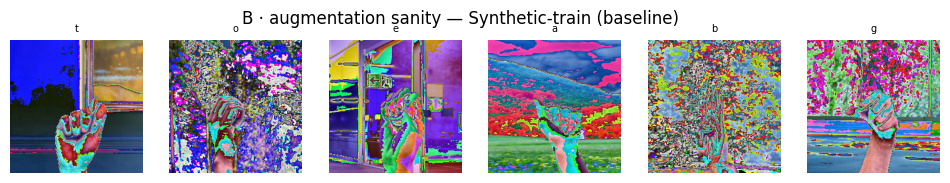

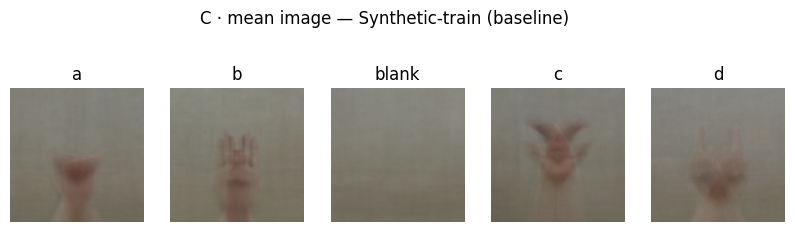

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 161MB/s]


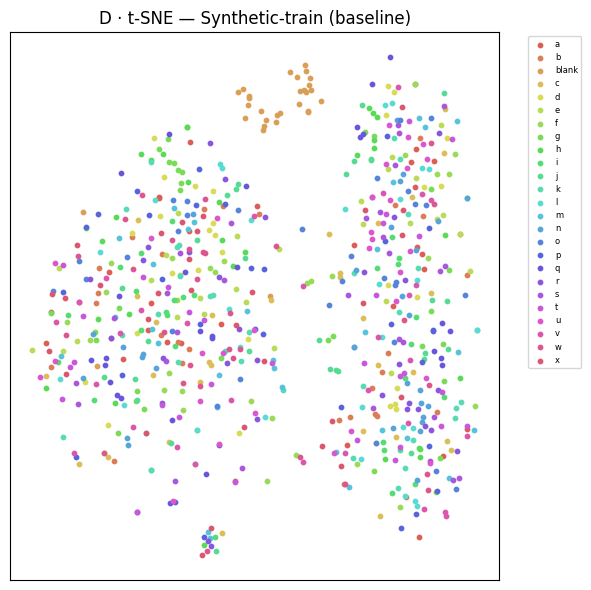

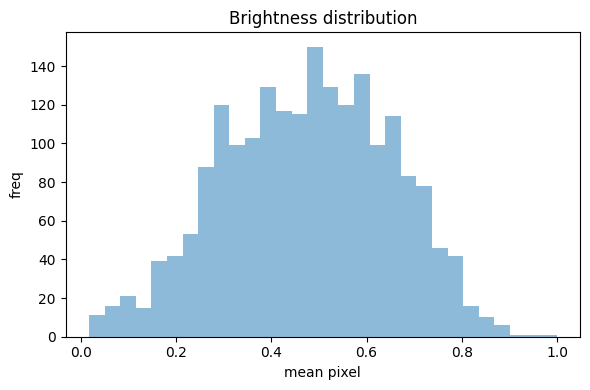

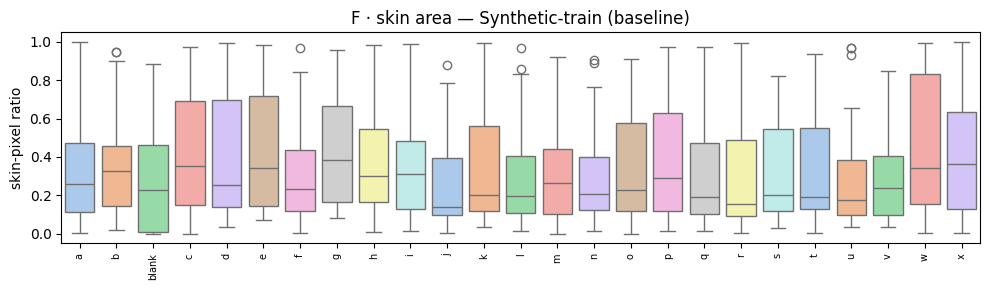


=========== Real-val (5 %) ===========


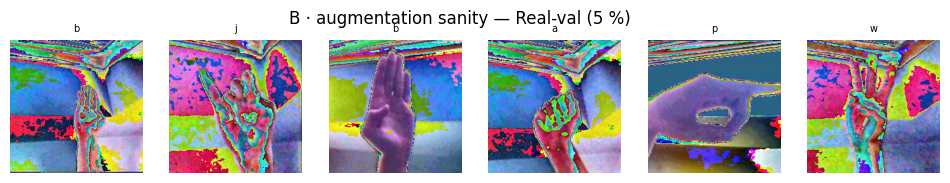

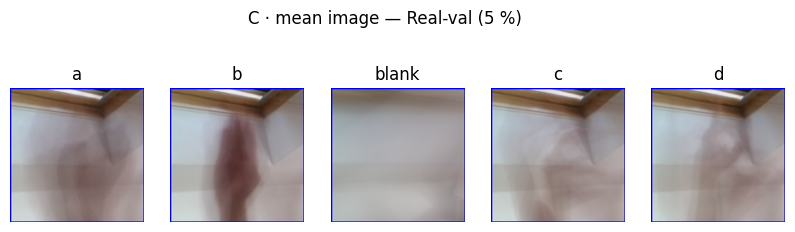

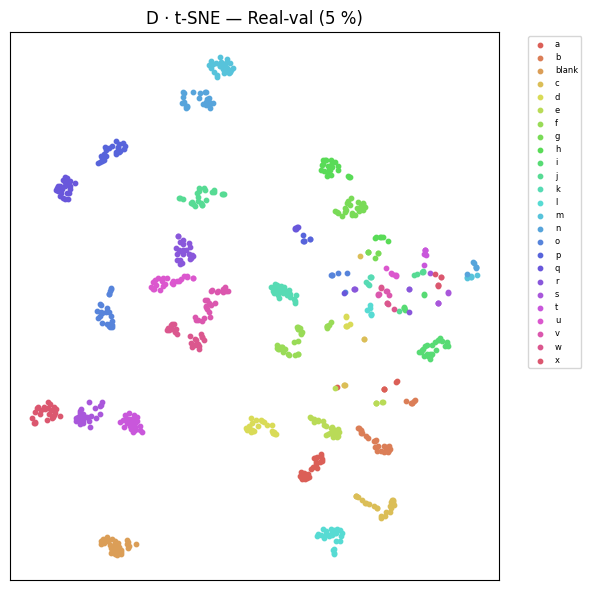

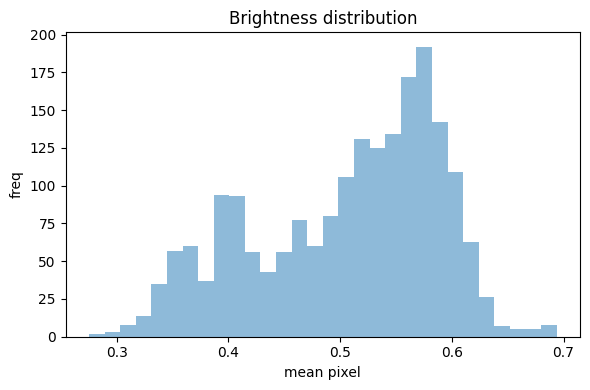

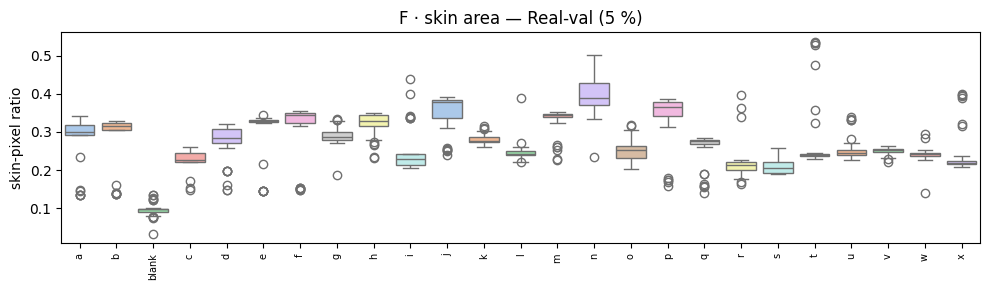

🔄 Switched synthetic training tfms to **strong** augmentations.


In [ ]:

#║ CELL 4 – Exploratory Data Analysis (EDA)

# Heavy visual diagnostics run **once** using baseline transforms.
IMG_SIZE_EDA, TSNE_SAMPLES, AUG_SAMPLES, BRI_SAMPLES = 128, 30, 6, 2000

def base(ds):         # undo Subset wrapper
    return ds.dataset if isinstance(ds, torch.utils.data.Subset) else ds

def sample_paths_per_class(ds, n=1, seed=0):
    random.seed(seed); out = {c: [] for c in range(len(base(ds).classes))}
    for p, lbl in base(ds).samples:
        if len(out[lbl]) < n: out[lbl].append(p)
        if all(len(v) == n for v in out.values()): break
    return out

DATASETS_EDA = [("Synthetic-train (baseline)", syn_train_ds),
                ("Real-val (5 %)",             real_val_ds)]

for split_name, DATASET in DATASETS_EDA:
    print(f"\n=========== {split_name} ===========")

    # B · augmentation sanity grid -----------------------
    fig, axs = plt.subplots(1, AUG_SAMPLES, figsize=(AUG_SAMPLES*2, 2))
    for ax, (p, lbl) in zip(axs,
                            random.sample(base(DATASET).samples, AUG_SAMPLES)):
        aug_img = baseline_tfms_syn(PIL.Image.open(p).convert("RGB"))
        ax.imshow(tv.transforms.ToPILImage()(aug_img))
        ax.axis("off"); ax.set_title(base(DATASET).classes[lbl], fontsize=7)
    plt.suptitle(f"B · augmentation sanity — {split_name}"); plt.show()

    # C · mean image (first 5 classes) -------------------
    means, CLASSES = [], base(DATASET).classes
    for cls_idx in range(min(5, len(CLASSES))):
        paths = [p for p, lbl in base(DATASET).samples if lbl == cls_idx][:200]
        arr   = np.stack([np.asarray(PIL.Image.open(p).convert('RGB')
                                      .resize((IMG_SIZE_EDA, IMG_SIZE_EDA)),
                                      np.float32) for p in paths])
        means.append(arr.mean(0).astype(np.uint8))
    plt.figure(figsize=(10,3))
    for i, img in enumerate(means):
        ax = plt.subplot(1, len(means), i+1)
        ax.imshow(img); ax.axis("off"); ax.set_title(CLASSES[i])
    plt.suptitle(f"C · mean image — {split_name}"); plt.show()

    # D · t-SNE of ResNet-50 features -------------------
    samples = sample_paths_per_class(DATASET, TSNE_SAMPLES)
    embeddings, labels_tsne = [], []
    prep = T.Compose([T.Resize((224,224)), T.ToTensor(),
                      T.Normalize((0.485,0.456,0.406),(0.229,0.224,0.225))])
    with torch.no_grad():
        backbone = tv.models.resnet50(weights="IMAGENET1K_V1").to(DEVICE).eval()
        backbone.fc = nn.Identity()
        for lbl, paths in samples.items():
            for p in paths:
                img = prep(PIL.Image.open(p).convert("RGB")).unsqueeze(0).to(DEVICE)
                embeddings.append(backbone(img).cpu().squeeze().numpy())
                labels_tsne.append(lbl)
    emb2d = TSNE(n_components=2, perplexity=30, init="pca",
                 random_state=0).fit_transform(np.vstack(embeddings))
    plt.figure(figsize=(6,6)); palette = sns.color_palette("hls", len(CLASSES))
    for i in range(len(CLASSES)):
        idx = [j for j,l in enumerate(labels_tsne) if l == i]
        plt.scatter(emb2d[idx,0], emb2d[idx,1], s=10,
                    color=palette[i], label=CLASSES[i])
    plt.title(f"D · t-SNE — {split_name}")
    plt.xticks([]); plt.yticks([]); plt.legend(bbox_to_anchor=(1.05,1),
                                               loc="upper left", fontsize=6)
    plt.tight_layout(); plt.show()

    # E · brightness histogram --------------------------
    def brightness_list(ds, n=BRI_SAMPLES):
        picks = random.sample(base(ds).samples, min(n,len(base(ds).samples)))
        return [np.asarray(PIL.Image.open(p).convert("L"),
                           np.float32).mean()/255.0 for p,_ in picks]
    plt.figure(figsize=(6,4))
    sns.histplot(brightness_list(DATASET), bins=30, alpha=0.5, edgecolor="none")
    plt.title("Brightness distribution"); plt.xlabel("mean pixel"); plt.ylabel("freq")
    plt.tight_layout(); plt.show()

    # F · skin-ratio box-plot ---------------------------
    HSV1, HSV2 = (np.array([0,40,60]), np.array([25,255,255])), \
                 (np.array([160,40,60]), np.array([180,255,255]))
    def skin_ratio(path):
        img = cv2.imread(str(path));                     # BGR
        if img is None: return None
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        mask = cv2.inRange(hsv, *HSV1) | cv2.inRange(hsv, *HSV2)
        return mask.mean()/255.0
    ratios = {c: [] for c in CLASSES}
    for cls_idx, cls_name in enumerate(CLASSES):
        paths = [p for p,lbl in base(DATASET).samples if lbl==cls_idx][:40]
        for p in paths:
            r = skin_ratio(p);  ratios[cls_name].append(r)
    df = pd.DataFrame(dict([(k, pd.Series(v)) for k,v in ratios.items()]))
    plt.figure(figsize=(10,3)); sns.boxplot(data=df, palette="pastel")
    plt.xticks(rotation=90, fontsize=7); plt.ylabel("skin-pixel ratio")
    plt.title(f"F · skin area — {split_name}"); plt.tight_layout(); plt.show()

# ── switch to strong augmentations for **training** ────
syn_train_ds.transform = strong_tfms_syn
print("🔄 Switched synthetic training tfms to **strong** augmentations.")


Those panels belong to the **“B · augmentation-sanity” and “C · mean-image”** sections of your EDA:

* **Top strip** Real-val (5 %) after the random augmentations.
* **Bottom strip** Synthetic-train with the same baseline augment pipeline.

They let you visually verify that the augmented samples still preserve each letter’s pose and reveal how textures/colours differ between synthetic and real data.
That evidence feeds directly into **RQ 4**:

> **RQ 4** *What is the impact of data-augmentation strategies applied to synthetic ASL images on the generalisation performance and robustness of CNN models?*

* **Why relevant to RQ 4**

  * Confirms the current augmentation pipeline does **not** warp letters into new ones (sanity check).
  * Shows background-texture and colour differences, motivating the stronger Blur + ColorJitter you later added (“EDA-informed” augmentations).
  * Serves as the *“before”* visual reference for your baseline-vs-EDA robustness experiment.

Secondarily the comparison also illustrates the synthetic-vs-real domain gap that underlies **RQ 2**, but its primary purpose is to justify the augmentation tweaks addressed in **RQ 4**.


In [ ]:
print("Unique true labels:", set(y_true))
print("'blank' index:", class_names.index('blank'))


Unique true labels: {np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25)}
'blank' index: 2


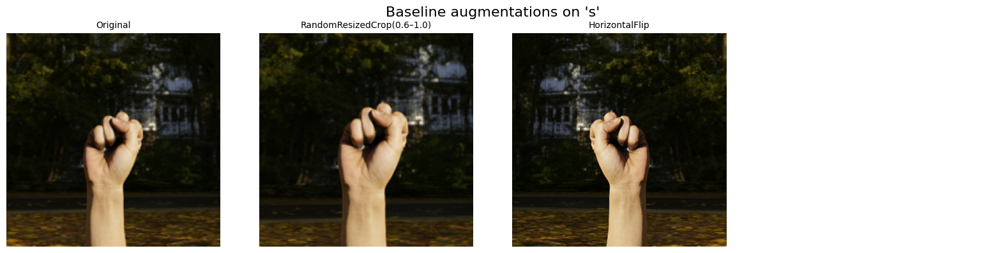

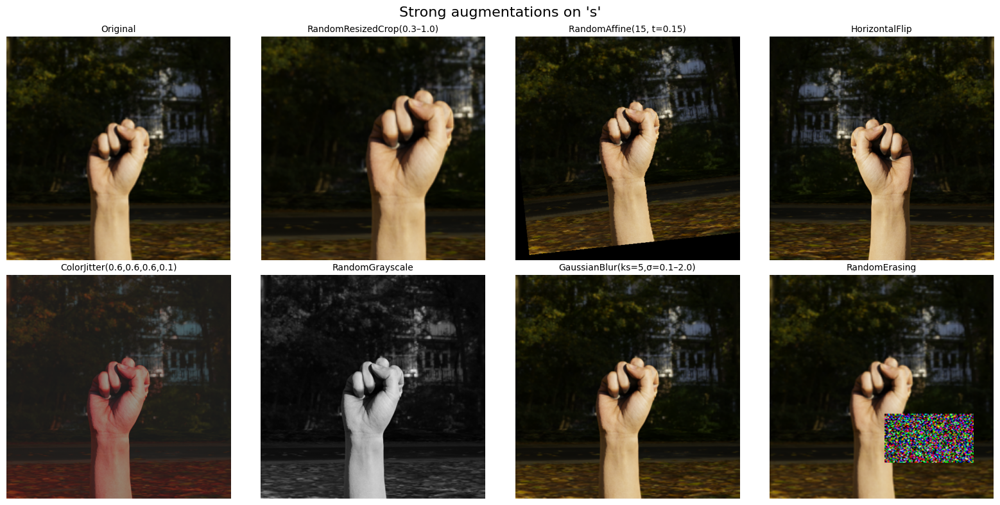

In [ ]:

# Visualize augmentations on one 's' image — grid layout


import random
import torch
import torchvision.transforms as T
import torchvision.transforms.functional as F
import matplotlib.pyplot as plt
from PIL import Image

# ---- pick an 's' from your synthetic train set ----
s_idx = syn_train_ds.class_to_idx['s']
s_paths = [p for p, lbl in syn_train_ds.samples if lbl == s_idx]
assert len(s_paths), "No 's' images found in syn_train_ds"
rng = random.Random(123)
s_img_path = rng.choice(s_paths)
base_img = Image.open(s_img_path).convert('RGB')

# ---- same size as in your pipeline ----
IMG_SIZE = IMG_SIZE  # from your notebook
resize = T.Resize((IMG_SIZE, IMG_SIZE))

# ---- define atomic steps from your transforms ----
# Baseline (we'll force p=1 where needed so the effect is visible)
baseline_steps = [
    ("Original", resize),
    ("RandomResizedCrop(0.6–1.0)", T.RandomResizedCrop(IMG_SIZE, scale=(0.6, 1.0))),
    ("HorizontalFlip", T.RandomHorizontalFlip(p=1.0)),
]

# Strong (your exact recipe, but shown step-by-step)
strong_steps = [
    ("Original", resize),
    ("RandomResizedCrop(0.3–1.0)", T.RandomResizedCrop(IMG_SIZE, scale=(0.3, 1.0))),
    ("RandomAffine(15, t=0.15)", T.RandomAffine(15, translate=(0.15, 0.15))),
    ("HorizontalFlip", T.RandomHorizontalFlip(p=1.0)),
    ("ColorJitter(0.6,0.6,0.6,0.1)", T.ColorJitter(0.6, 0.6, 0.6, 0.1)),
    ("RandomGrayscale", T.RandomGrayscale(p=1.0)),
    ("GaussianBlur(ks=5,σ=0.1–2.0)", T.GaussianBlur(5, (0.1, 2.0))),
    ("RandomErasing", "ERASE"),  # special-cased below
]

def apply_aug(img_pil, aug, seed=123):
    """Apply a single augmentation deterministically for preview."""
    torch.manual_seed(seed)
    random.seed(seed)
    if aug == "ERASE":
        # RandomErasing works on tensors
        x = F.to_tensor(resize(img_pil)).clone()
        eraser = T.RandomErasing(p=1.0, scale=(0.02, 0.15), ratio=(0.3, 3.3), value='random')
        x = eraser(x)
        return F.to_pil_image(x.clamp(0, 1))
    else:
        out = aug(img_pil)
        # keep in PIL if possible; if tensor, convert back to PIL
        if isinstance(out, torch.Tensor):
            out = F.to_pil_image(out.clamp(0, 1))
        return out

def show_grid(title, steps, cols=4):
    imgs, titles = [], []
    for name, aug in steps:
        img = apply_aug(base_img, aug)
        imgs.append(img)
        titles.append(name)

    rows = (len(imgs) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    axes = axes.flatten() if hasattr(axes, "flatten") else [axes]

    for ax, im, t in zip(axes, imgs, titles):
        ax.imshow(im)
        ax.set_title(t, fontsize=10)
        ax.axis('off')
    for ax in axes[len(imgs):]:
        ax.axis('off')

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# ---- render both galleries ----
show_grid("Baseline augmentations on 's'", baseline_steps, cols=4)
show_grid("Strong augmentations on 's'", strong_steps, cols=4)



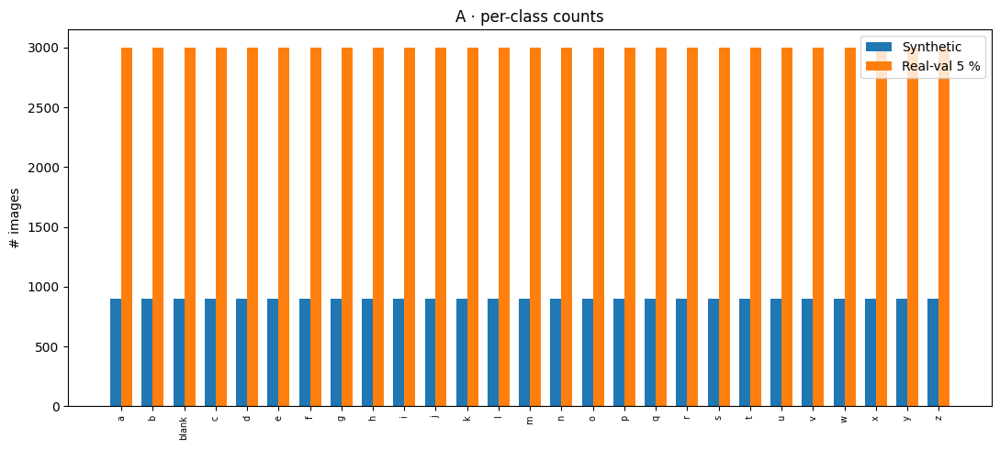

✅ Class order identical across splits.


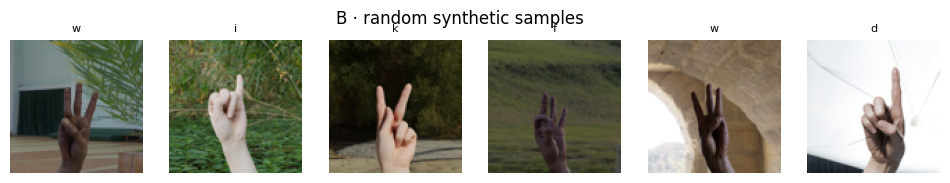


C · RGB channel statistics (400-image sample, 64×64 resize)
Synthetic  μ: [0.493 0.469 0.428]  σ: [0.248 0.252 0.271]
Real-val   μ: [0.521 0.5   0.513]  σ: [0.22  0.248 0.259]


In [ ]:
# ╔══════════════════════════════════════════════════════╗
# ║ EDA – counts · thumbnails · channel statistics       ║
# ╚══════════════════════════════════════════════════════╝
import matplotlib.pyplot as plt, numpy as np, PIL, random, torch

# ----------------------------------------------------------------------
#  pick the datasets to compare
syn_ds  = syn_train_ds          # synthetic train ⬅️  already defined earlier
real_ds = real_val_ds           # 5 % real-train val subset for EDA
# ----------------------------------------------------------------------

# A · identical class order + per-class counts -------------------------
base_syn  = syn_ds.dataset if isinstance(syn_ds, torch.utils.data.Subset) else syn_ds
base_real = real_ds.dataset if isinstance(real_ds, torch.utils.data.Subset) else real_ds

assert base_syn.classes == base_real.classes, "❌ Class order mismatch!"

cnt_syn  = [0]*len(base_syn.classes)
cnt_real = [0]*len(base_real.classes)

for _, lbl in base_syn.samples:  cnt_syn[lbl]  += 1
for _, lbl in base_real.samples: cnt_real[lbl] += 1

x, w = np.arange(len(base_syn.classes)), 0.35
plt.figure(figsize=(11,5))
plt.bar(x-w/2, cnt_syn,  width=w, label="Synthetic")
plt.bar(x+w/2, cnt_real, width=w, label="Real-val 5 %")
plt.xticks(x, base_syn.classes, rotation=90, fontsize=7)
plt.ylabel("# images"); plt.title("A · per-class counts"); plt.legend()
plt.tight_layout(); plt.show()
print("✅ Class order identical across splits.")

# B · thumbnail grid (6 random synthetic samples) ----------------------
def sample_grid(ds, k=6, thumb=96):
    base  = ds.dataset if isinstance(ds, torch.utils.data.Subset) else ds
    picks = random.sample(range(len(ds)), min(k, len(ds)))
    plt.figure(figsize=(k*2, 2))
    for j, idx in enumerate(picks):
        real_idx = ds.indices[idx] if isinstance(ds, torch.utils.data.Subset) else idx
        path, lbl = base.samples[real_idx]
        img = PIL.Image.open(path).convert("RGB").resize((thumb, thumb))
        ax  = plt.subplot(1, k, j+1)
        ax.imshow(img); ax.axis("off"); ax.set_title(base.classes[lbl], fontsize=8)
    plt.suptitle("B · random synthetic samples"); plt.show()

sample_grid(syn_ds)

# C · fast channel statistics (400-image sample) -----------------------
def tiny_sample(ds, n=400):
    base = ds.dataset if isinstance(ds, torch.utils.data.Subset) else ds
    return random.sample(base.samples, min(n, len(base)))

def channel_stats(samples):
    buf = []
    for p,_ in samples:
        arr = np.asarray(PIL.Image.open(p).convert("RGB").resize((64,64)),
                         dtype=np.float32) / 255.0
        buf.append(arr.reshape(-1,3))
    pts = np.concatenate(buf, axis=0)
    return pts.mean(0), pts.std(0)

mu_syn,  sd_syn  = channel_stats(tiny_sample(syn_ds))
mu_real, sd_real = channel_stats(tiny_sample(real_ds))

print("\nC · RGB channel statistics (400-image sample, 64×64 resize)")
print("Synthetic  μ:", np.round(mu_syn,3), " σ:", np.round(sd_syn,3))
print("Real-val   μ:", np.round(mu_real,3), " σ:", np.round(sd_real,3))


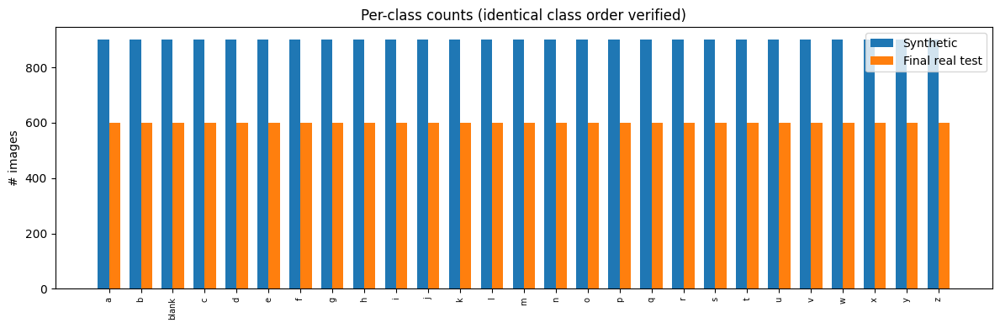

✅ Class order identical – bar chart rendered.


In [ ]:
# ╔══════════════════════════════════════════════════════╗
# ║ CELL – per-class count sanity bar chart              ║
# ╚══════════════════════════════════════════════════════╝
import matplotlib.pyplot as plt, numpy as np, torch

# --- choose the two splits to compare ---
ds_a = syn_train_ds      # synthetic training split
ds_b = final_test_ds       # real 5 % val subset
label_a, label_b = "Synthetic", "Final real test"   # legend labels
# -------------------------------------------------------

# unwrap Subset -> base ImageFolder (if needed)
base_a = ds_a.dataset if isinstance(ds_a, torch.utils.data.Subset) else ds_a
# ds_b is a ConcatDataset, need to access classes from one of its constituent datasets
base_b_classes = ds_b.datasets[0].classes


assert base_a.classes == base_b_classes, "❌ Class order differs between splits!"

# count images per class
cnt_a = [0] * len(base_a.classes)
for _, lbl in base_a.samples: cnt_a[lbl] += 1

cnt_b = [0] * len(base_b_classes)
# For ConcatDataset, iterate through each dataset and its samples
for dataset in ds_b.datasets:
    if isinstance(dataset, torch.utils.data.Subset):
        # Handle Subset dataset
        base_dataset = dataset.dataset
        indices = dataset.indices
        for idx in indices:
            _, lbl = base_dataset.samples[idx]
            cnt_b[lbl] += 1
    else:
        # Handle ImageFolder dataset
        for _, lbl in dataset.samples:
            cnt_b[lbl] += 1


# bar chart
x     = np.arange(len(base_a.classes))
width = 0.35
plt.figure(figsize=(12, 4))
plt.bar(x - width/2, cnt_a, width=width, label=label_a)
plt.bar(x + width/2, cnt_b, width=width, label=label_b) # Corrected index
plt.xticks(x, base_a.classes, rotation=90, fontsize=7)
plt.ylabel("# images")
plt.title("Per-class counts (identical class order verified)")
plt.legend()
plt.tight_layout()
plt.show()

print("✅ Class order identical – bar chart rendered.")

In [ ]:


import torch.nn as nn
from torchvision import models

def make_model_fn(ctor, WE):
    """
    Returns a function that builds (model, base) for this backbone.
    Handles both .fc and .classifier heads.
    """
    def builder():
        base = ctor(weights=WE.DEFAULT)
        # detect and strip the existing classifier
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        elif hasattr(base, 'classifier'):
            cls = base.classifier
            if isinstance(cls, nn.Sequential):
                # last layer of the sequential
                last = cls[-1]
                in_f = last.in_features
            else:
                in_f = cls.in_features
            base.classifier = nn.Identity()
        else:
            raise RuntimeError(f"Unknown head for {ctor.__name__}")
        # attach our 27-way head
        head = nn.Linear(in_f, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

def latest_ckpt(prefix):
    files = sorted(glob.glob(f"{prefix}_epoch*.pt"))
    return files[-1] if files else None


In [ ]:
# ──
# Force a brand-new run: ignore any on-disk or in-memory history

FORCE_RESTART = True

if FORCE_RESTART:
    print("🚨 Starting fresh: clearing any loaded history and disabling resume")
    histories = {}
    def latest_ckpt(prefix):       # override helper to never find a checkpoint
        return None
else:
    # existing load-history logic here...
    try:
        with open(HISTORY_F,'rb') as fp:
            histories = pickle.load(fp)
        print("✅ Loaded history for:", histories.keys())
    except FileNotFoundError:
        histories = {}
    # and define latest_ckpt(prefix) as before


🚨 Starting fresh: clearing any loaded history and disabling resume


In [ ]:
FORCE_NO_RESUME = ['mobilenet_v2']  # list model names to always restart

def latest_ckpt(prefix):
    if any(prefix.endswith(f"{m}_zs") for m in FORCE_NO_RESUME):
        return None
    files = sorted(glob.glob(str(MODEL_DIR/f"{prefix}_epoch*.pt")))
    return files[-1] if files else None


In [ ]:

#Training loop (FORCE NO RESUME)

FORCE_NO_RESUME = True

def latest_ckpt(prefix):
    if FORCE_NO_RESUME:
        return None
    files = sorted(glob.glob(f"{prefix}_epoch*.pt"))
    return files[-1] if files else None

# … rest of your training cell unchanged …


In [ ]:
!rm /content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch*.pt
!rm /content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_best.pt


rm: cannot remove '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch*.pt': No such file or directory
rm: cannot remove '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_best.pt': No such file or directory


In [ ]:

#Fine-tune from baseline → strong augmentations
#  - loads epoch-15 (baseline) checkpoint
#  - runs up to EXTRA_EPOCHS with early stopping

import torch, torch.nn as nn, torch.optim as optim
import pickle, re, time
from pathlib import Path
from torchvision import models, transforms as T
import torchvision as tv
from torch.utils.data import DataLoader, Subset # Import Subset

# 0) Run settings
AUGMENTATION     = "strong"     # "strong" or "baseline"
RUN_TAG          = f"zs_{AUGMENTATION}"
EXTRA_EPOCHS     = 10           # fine-tune budget
EARLY_PATIENCE   = 3            # stop if no val_acc improvement for N epochs
MIN_DELTA        = 1e-4         # minimum meaningful improvement in val_acc
WARMUP_EPOCHS    = 2            # small LR warmup
HEAD_EPOCHS      = 0            # fine-tune whole net from the start
LR_HEAD          = 1e-3         # unused when HEAD_EPOCHS=0
LR_FINE          = 5e-4         # slightly smaller LR for fine-tune

INIT_FROM = {
    'resnet50': '/content/drive/MyDrive/zero_shot_models2/resnet50_zs_epoch15.pt',
    'mobilenet_v2': '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch15.pt',
    'efficientnet_b0' : '/content/drive/MyDrive/zero_shot_models2/efficientnet_b0_zs_epoch15.pt',
    'densenet121' : '/content/drive/MyDrive/zero_shot_models2/densenet121_zs_epoch15.pt'
}


# 1) Transforms
baseline_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.6, 1.0)),
    T.RandomHorizontalFlip(),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

strong_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.5, 1.0)),
    T.RandomHorizontalFlip(),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05),
    T.RandomAffine(degrees=15, translate=(0.1,0.1), scale=(0.9,1.1), shear=10),
    T.GaussianBlur(kernel_size=3),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

train_tfms = strong_tfms_syn if AUGMENTATION == "strong" else baseline_tfms_syn
eval_tfms  = T.Compose([
    T.Resize(IMG_SIZE),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

# Datasets & loaders
syn_train_ds = tv.datasets.ImageFolder(TRAIN_SYN, transform=train_tfms)
# Use the existing real_val_ds from cell SxTGUIu_vUwg
val_ds       = real_val_ds # Corrected variable name
train_loader = DataLoader(syn_train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W
val_loader   = DataLoader(val_ds,       batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W

print(f"Using augmentation: {AUGMENTATION}\n{train_tfms}")

# 2) Output dirs & history (tagged by augmentation)
BASE_DIR  = Path('/content/drive/MyDrive')
MODEL_DIR = BASE_DIR / f'zero_shot_models1_{RUN_TAG}'
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR / f'history_{RUN_TAG}.pkl'

try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys()))
except FileNotFoundError:
    histories = {}

def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_{RUN_TAG}_epoch*.pt"))
    return files[-1] if files else None

# 3) Backbones
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['mobilenet_v2']  # change as needed

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder


# 4) Fine-tuning loop with early stopping
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix  = f"{name}_{RUN_TAG}"
    best_pt = MODEL_DIR / f"{prefix}_best.pt"
    last_pt = latest_ckpt(name)  # previous strong-run ckpt, if any

    hist = histories.get(name, {
        'train_acc':[], 'val_acc':[],
        'train_loss':[], 'val_loss':[], 'lr':[],
        'meta': {'augmentation': AUGMENTATION, 'train_tfms': repr(train_tfms),
                 'init_from': INIT_FROM.get(name, None)}
    })

    builder = make_model_fn(ctor, WE)
    model, base = builder()

    # Init weights: prefer continuing a previous strong run; else seed from baseline epoch-15 if provided
    if last_pt and last_pt.exists():
        print(f"🔹 Resuming {name} strong-run from {last_pt.name}")
        sd = torch.load(last_pt, map_location=DEVICE)
        model.load_state_dict(sd, strict=True)
        # truncate history to match last epoch if needed (not strictly necessary here)
    else:
        init_ckpt = INIT_FROM.get(name)
        if init_ckpt and Path(init_ckpt).exists():
            print(f"🪄 Initializing {name} from baseline: {Path(init_ckpt).name}")
            sd = torch.load(init_ckpt, map_location=DEVICE)
            model.load_state_dict(sd, strict=True)
        else:
            print(f"⚠️ No INIT_FROM checkpoint found for {name}; training from ImageNet weights.")

    # Optimizer (whole model fine-tune)
    for p in model.parameters(): p.requires_grad = True
    optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

    # Simple warmup
    def get_lr(epoch):
        if epoch < WARMUP_EPOCHS:
            return LR_FINE * (epoch + 1) / WARMUP_EPOCHS
        return LR_FINE

    best_val   = -1.0
    patience   = 0

    for ep in range(1, EXTRA_EPOCHS + 1):
        # adjust LR (warmup)
        lr = get_lr(ep-1)
        for pg in optimizer.param_groups: pg['lr'] = lr

        t0 = time.time()

        # —— train ——
        model.train()
        tot_loss=tot_n=correct=0
        for X, y in train_loader:
            X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
            optimizer.zero_grad(set_to_none=True)
            out  = model(X)
            loss = nn.CrossEntropyLoss()(out, y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct += (preds==y).sum().item()
            n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        tr_acc  = correct / tot_n
        tr_loss = tot_loss / tot_n

        # —— validate ——
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X, y in val_loader:
                X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
                out  = model(X)
                loss = nn.CrossEntropyLoss()(out, y)
                preds = out.argmax(1)
                correct += (preds==y).sum().item()
                n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        val_acc  = correct / tot_n
        val_loss = tot_loss / tot_n

        # log
        print(f"{name:>12s} [FT {ep:02d}/{EXTRA_EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save epoch & best (tagged with RUN_TAG)
        epoch_pt = MODEL_DIR / f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)

        # early-stopping bookkeeping
        improved = (val_acc - best_val) > MIN_DELTA
        if improved:
            best_val = val_acc
            patience = 0
            torch.save(model.state_dict(), best_pt)
        else:
            patience += 1

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

        if patience >= EARLY_PATIENCE:
            print(f"⛔ Early stopping {name}: no improvement for {EARLY_PATIENCE} epochs.")
            break

    histories[name] = hist
    with open(HISTORY_F, 'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} fine-tune done (best val_acc={best_val:.3f})")

Using augmentation: strong
Compose(
    RandomResizedCrop(size=(224, 224), scale=(0.5, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear, antialias=True)
    RandomHorizontalFlip(p=0.5)
    ColorJitter(brightness=(0.7, 1.3), contrast=(0.7, 1.3), saturation=(0.7, 1.3), hue=(-0.05, 0.05))
    RandomAffine(degrees=[-15.0, 15.0], translate=(0.1, 0.1), scale=(0.9, 1.1), shear=[-10.0, 10.0])
    GaussianBlur(kernel_size=(3, 3), sigma=(0.1, 2.0))
    ToTensor()
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
)
✅ Loaded history for: ['resnet50', 'efficientnet_b0']


Downloading: "https://download.pytorch.org/models/mobilenet_v2-7ebf99e0.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-7ebf99e0.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 24.5MB/s]


🪄 Initializing mobilenet_v2 from baseline: mobilenet_v2_zs_epoch15.pt
mobilenet_v2 [FT 01/10] acc 0.984 | val 0.370 | loss 0.05 | val_loss 3.32 | lr 2.5e-04 | 473s
mobilenet_v2 [FT 02/10] acc 0.985 | val 0.374 | loss 0.05 | val_loss 3.99 | lr 5.0e-04 | 456s
mobilenet_v2 [FT 03/10] acc 0.991 | val 0.322 | loss 0.03 | val_loss 4.16 | lr 5.0e-04 | 451s
mobilenet_v2 [FT 04/10] acc 0.994 | val 0.372 | loss 0.02 | val_loss 3.66 | lr 5.0e-04 | 451s
mobilenet_v2 [FT 05/10] acc 0.992 | val 0.340 | loss 0.03 | val_loss 4.39 | lr 5.0e-04 | 449s
⛔ Early stopping mobilenet_v2: no improvement for 3 epochs.
mobilenet_v2 fine-tune done (best val_acc=0.374)


In [ ]:

#  Fine-tune from baseline → strong augmentations
#  - loads epoch-15 (baseline) checkpoint
#  - runs up to EXTRA_EPOCHS with early stopping

import torch, torch.nn as nn, torch.optim as optim
import pickle, re, time
from pathlib import Path
from torchvision import models, transforms as T
import torchvision as tv
from torch.utils.data import DataLoader, Subset # Import Subset

# 0) Run settings
AUGMENTATION     = "strong"     # "strong" or "baseline"
RUN_TAG          = f"zs_{AUGMENTATION}"
EXTRA_EPOCHS     = 10           # fine-tune budget
EARLY_PATIENCE   = 3            # stop if no val_acc improvement for N epochs
MIN_DELTA        = 1e-4         # minimum meaningful improvement in val_acc
WARMUP_EPOCHS    = 2            # small LR warmup
HEAD_EPOCHS      = 0            # fine-tune whole net from the start
LR_HEAD          = 1e-3         # unused when HEAD_EPOCHS=0
LR_FINE          = 5e-4         # slightly smaller LR for fine-tune


INIT_FROM = {
    'resnet50': '/content/drive/MyDrive/zero_shot_models2/resnet50_zs_epoch15.pt',
    'mobilenet_v2': '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch15.pt',
    'efficientnet_b0' : '/content/drive/MyDrive/zero_shot_models2/efficientnet_b0_zs_epoch15.pt',
    'densenet121' : '/content/drive/MyDrive/zero_shot_models2/densenet121_zs_epoch15.pt'
}


# 1) Transforms
baseline_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.6, 1.0)),
    T.RandomHorizontalFlip(),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

strong_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.5, 1.0)),
    T.RandomHorizontalFlip(),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05),
    T.RandomAffine(degrees=15, translate=(0.1,0.1), scale=(0.9,1.1), shear=10),
    T.GaussianBlur(kernel_size=3),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

train_tfms = strong_tfms_syn if AUGMENTATION == "strong" else baseline_tfms_syn
eval_tfms  = T.Compose([
    T.Resize(IMG_SIZE),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

# Datasets & loaders
syn_train_ds = tv.datasets.ImageFolder(TRAIN_SYN, transform=train_tfms)
# Use the existing real_val_ds from cell SxTGUIu_vUwg
val_ds       = real_val_ds # Corrected variable name
train_loader = DataLoader(syn_train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W
val_loader   = DataLoader(val_ds,       batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W

print(f"Using augmentation: {AUGMENTATION}\n{train_tfms}")


# 2) Output dirs & history (tagged by augmentation)
BASE_DIR  = Path('/content/drive/MyDrive')
MODEL_DIR = BASE_DIR / f'zero_shot_models1_{RUN_TAG}'
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR / f'history_{RUN_TAG}.pkl'

try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys()))
except FileNotFoundError:
    histories = {}

def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_{RUN_TAG}_epoch*.pt"))
    return files[-1] if files else None


# 3) Backbones
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['densenet121']  # change as needed

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

# 4) Fine-tuning loop with early stopping
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix  = f"{name}_{RUN_TAG}"
    best_pt = MODEL_DIR / f"{prefix}_best.pt"
    last_pt = latest_ckpt(name)  # previous strong-run ckpt, if any

    hist = histories.get(name, {
        'train_acc':[], 'val_acc':[],
        'train_loss':[], 'val_loss':[], 'lr':[],
        'meta': {'augmentation': AUGMENTATION, 'train_tfms': repr(train_tfms),
                 'init_from': INIT_FROM.get(name, None)}
    })

    builder = make_model_fn(ctor, WE)
    model, base = builder()

    # Init weights: prefer continuing a previous strong run; else seed from baseline epoch-15 if provided
    if last_pt and last_pt.exists():
        print(f"🔹 Resuming {name} strong-run from {last_pt.name}")
        sd = torch.load(last_pt, map_location=DEVICE)
        model.load_state_dict(sd, strict=True)
        # truncate history to match last epoch if needed (not strictly necessary here)
    else:
        init_ckpt = INIT_FROM.get(name)
        if init_ckpt and Path(init_ckpt).exists():
            print(f"🪄 Initializing {name} from baseline: {Path(init_ckpt).name}")
            sd = torch.load(init_ckpt, map_location=DEVICE)
            model.load_state_dict(sd, strict=True)
        else:
            print(f"⚠️ No INIT_FROM checkpoint found for {name}; training from ImageNet weights.")

    # Optimizer (whole model fine-tune)
    for p in model.parameters(): p.requires_grad = True
    optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

    # Simple warmup
    def get_lr(epoch):
        if epoch < WARMUP_EPOCHS:
            return LR_FINE * (epoch + 1) / WARMUP_EPOCHS
        return LR_FINE

    best_val   = -1.0
    patience   = 0

    for ep in range(1, EXTRA_EPOCHS + 1):
        # adjust LR (warmup)
        lr = get_lr(ep-1)
        for pg in optimizer.param_groups: pg['lr'] = lr

        t0 = time.time()

        # —— train ——
        model.train()
        tot_loss=tot_n=correct=0
        for X, y in train_loader:
            X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
            optimizer.zero_grad(set_to_none=True)
            out  = model(X)
            loss = nn.CrossEntropyLoss()(out, y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct += (preds==y).sum().item()
            n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        tr_acc  = correct / tot_n
        tr_loss = tot_loss / tot_n

        # —— validate ——
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X, y in val_loader:
                X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
                out  = model(X)
                loss = nn.CrossEntropyLoss()(out, y)
                preds = out.argmax(1)
                correct += (preds==y).sum().item()
                n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        val_acc  = correct / tot_n
        val_loss = tot_loss / tot_n

        # log
        print(f"{name:>12s} [FT {ep:02d}/{EXTRA_EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save epoch & best (tagged with RUN_TAG)
        epoch_pt = MODEL_DIR / f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)

        # early-stopping bookkeeping
        improved = (val_acc - best_val) > MIN_DELTA
        if improved:
            best_val = val_acc
            patience = 0
            torch.save(model.state_dict(), best_pt)
        else:
            patience += 1

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

        if patience >= EARLY_PATIENCE:
            print(f"⛔ Early stopping {name}: no improvement for {EARLY_PATIENCE} epochs.")
            break

    histories[name] = hist
    with open(HISTORY_F, 'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} fine-tune done (best val_acc={best_val:.3f})")

Using augmentation: strong
Compose(
    RandomResizedCrop(size=(224, 224), scale=(0.5, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear, antialias=True)
    RandomHorizontalFlip(p=0.5)
    ColorJitter(brightness=(0.7, 1.3), contrast=(0.7, 1.3), saturation=(0.7, 1.3), hue=(-0.05, 0.05))
    RandomAffine(degrees=[-15.0, 15.0], translate=(0.1, 0.1), scale=(0.9, 1.1), shear=[-10.0, 10.0])
    GaussianBlur(kernel_size=(3, 3), sigma=(0.1, 2.0))
    ToTensor()
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
)
✅ Loaded history for: ['resnet50', 'efficientnet_b0', 'mobilenet_v2']


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 53.7MB/s]


🪄 Initializing densenet121 from baseline: densenet121_zs_epoch15.pt
 densenet121 [FT 01/10] acc 0.991 | val 0.444 | loss 0.03 | val_loss 2.63 | lr 2.5e-04 | 559s
 densenet121 [FT 02/10] acc 0.979 | val 0.355 | loss 0.07 | val_loss 3.21 | lr 5.0e-04 | 537s
 densenet121 [FT 03/10] acc 0.993 | val 0.354 | loss 0.03 | val_loss 3.12 | lr 5.0e-04 | 550s
 densenet121 [FT 04/10] acc 0.992 | val 0.368 | loss 0.03 | val_loss 3.49 | lr 5.0e-04 | 531s
⛔ Early stopping densenet121: no improvement for 3 epochs.
 densenet121 fine-tune done (best val_acc=0.444)


In [ ]:

# CELL 7 – Fine-tune from baseline → strong augmentations
#  - loads epoch-15 (baseline) checkpoint
#  - runs up to EXTRA_EPOCHS with early stopping

import torch, torch.nn as nn, torch.optim as optim
import pickle, re, time
from pathlib import Path
from torchvision import models, transforms as T
import torchvision as tv
from torch.utils.data import DataLoader, Subset # Import Subset


# 0) Run settings
AUGMENTATION     = "strong"     # "strong" or "baseline"
RUN_TAG          = f"zs_{AUGMENTATION}"
EXTRA_EPOCHS     = 10           # fine-tune budget
EARLY_PATIENCE   = 3            # stop if no val_acc improvement for N epochs
MIN_DELTA        = 1e-4         # minimum meaningful improvement in val_acc
WARMUP_EPOCHS    = 2            # small LR warmup
HEAD_EPOCHS      = 0            # fine-tune whole net from the start
LR_HEAD          = 1e-3         # unused when HEAD_EPOCHS=0
LR_FINE          = 5e-4         # slightly smaller LR for fine-tune


INIT_FROM = {
    'resnet50': '/content/drive/MyDrive/zero_shot_models2/resnet50_zs_epoch15.pt',
    'mobilenet_v2': '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch15.pt',
    'efficientnet_b0' : '/content/drive/MyDrive/zero_shot_models2/efficientnet_b0_zs_epoch15.pt',
    'densenet121' : '/content/drive/MyDrive/zero_shot_models2/densenet121_zs_epoch15.pt'
}

# 1) Transforms
baseline_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.6, 1.0)),
    T.RandomHorizontalFlip(),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

strong_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.5, 1.0)),
    T.RandomHorizontalFlip(),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05),
    T.RandomAffine(degrees=15, translate=(0.1,0.1), scale=(0.9,1.1), shear=10),
    T.GaussianBlur(kernel_size=3),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

train_tfms = strong_tfms_syn if AUGMENTATION == "strong" else baseline_tfms_syn
eval_tfms  = T.Compose([
    T.Resize(IMG_SIZE),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

# Datasets & loaders
syn_train_ds = tv.datasets.ImageFolder(TRAIN_SYN, transform=train_tfms)
# Use the existing real_val_ds from cell SxTGUIu_vUwg
val_ds       = real_val_ds # Corrected variable name
train_loader = DataLoader(syn_train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W
val_loader   = DataLoader(val_ds,       batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W

print(f"Using augmentation: {AUGMENTATION}\n{train_tfms}")


# 2) Output dirs & history (tagged by augmentation)
BASE_DIR  = Path('/content/drive/MyDrive')
MODEL_DIR = BASE_DIR / f'zero_shot_models1_{RUN_TAG}'
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR / f'history_{RUN_TAG}.pkl'

try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys()))
except FileNotFoundError:
    histories = {}

def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_{RUN_TAG}_epoch*.pt"))
    return files[-1] if files else None

# 3) Backbones
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['resnet50']  # change as needed

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder


# 4) Fine-tuning loop with early stopping
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix  = f"{name}_{RUN_TAG}"
    best_pt = MODEL_DIR / f"{prefix}_best.pt"
    last_pt = latest_ckpt(name)  # previous strong-run ckpt, if any

    hist = histories.get(name, {
        'train_acc':[], 'val_acc':[],
        'train_loss':[], 'val_loss':[], 'lr':[],
        'meta': {'augmentation': AUGMENTATION, 'train_tfms': repr(train_tfms),
                 'init_from': INIT_FROM.get(name, None)}
    })

    builder = make_model_fn(ctor, WE)
    model, base = builder()

    # Init weights: prefer continuing a previous strong run; else seed from baseline epoch-15 if provided
    if last_pt and last_pt.exists():
        print(f"🔹 Resuming {name} strong-run from {last_pt.name}")
        sd = torch.load(last_pt, map_location=DEVICE)
        model.load_state_dict(sd, strict=True)
        # truncate history to match last epoch if needed (not strictly necessary here)
    else:
        init_ckpt = INIT_FROM.get(name)
        if init_ckpt and Path(init_ckpt).exists():
            print(f"🪄 Initializing {name} from baseline: {Path(init_ckpt).name}")
            sd = torch.load(init_ckpt, map_location=DEVICE)
            model.load_state_dict(sd, strict=True)
        else:
            print(f"⚠️ No INIT_FROM checkpoint found for {name}; training from ImageNet weights.")

    # Optimizer (whole model fine-tune)
    for p in model.parameters(): p.requires_grad = True
    optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

    # Simple warmup
    def get_lr(epoch):
        if epoch < WARMUP_EPOCHS:
            return LR_FINE * (epoch + 1) / WARMUP_EPOCHS
        return LR_FINE

    best_val   = -1.0
    patience   = 0

    for ep in range(1, EXTRA_EPOCHS + 1):
        # adjust LR (warmup)
        lr = get_lr(ep-1)
        for pg in optimizer.param_groups: pg['lr'] = lr

        t0 = time.time()

        # —— train ——
        model.train()
        tot_loss=tot_n=correct=0
        for X, y in train_loader:
            X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
            optimizer.zero_grad(set_to_none=True)
            out  = model(X)
            loss = nn.CrossEntropyLoss()(out, y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct += (preds==y).sum().item()
            n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        tr_acc  = correct / tot_n
        tr_loss = tot_loss / tot_n

        # —— validate ——
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X, y in val_loader:
                X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
                out  = model(X)
                loss = nn.CrossEntropyLoss()(out, y)
                preds = out.argmax(1)
                correct += (preds==y).sum().item()
                n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        val_acc  = correct / tot_n
        val_loss = tot_loss / tot_n

        # log
        print(f"{name:>12s} [FT {ep:02d}/{EXTRA_EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save epoch & best (tagged with RUN_TAG)
        epoch_pt = MODEL_DIR / f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)

        # early-stopping bookkeeping
        improved = (val_acc - best_val) > MIN_DELTA
        if improved:
            best_val = val_acc
            patience = 0
            torch.save(model.state_dict(), best_pt)
        else:
            patience += 1

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

        if patience >= EARLY_PATIENCE:
            print(f"⛔ Early stopping {name}: no improvement for {EARLY_PATIENCE} epochs.")
            break

    histories[name] = hist
    with open(HISTORY_F, 'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} fine-tune done (best val_acc={best_val:.3f})")

Using augmentation: strong
Compose(
    RandomResizedCrop(size=(224, 224), scale=(0.5, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear, antialias=True)
    RandomHorizontalFlip(p=0.5)
    ColorJitter(brightness=(0.7, 1.3), contrast=(0.7, 1.3), saturation=(0.7, 1.3), hue=(-0.05, 0.05))
    RandomAffine(degrees=[-15.0, 15.0], translate=(0.1, 0.1), scale=(0.9, 1.1), shear=[-10.0, 10.0])
    GaussianBlur(kernel_size=(3, 3), sigma=(0.1, 2.0))
    ToTensor()
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
)


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 71.1MB/s]


🪄 Initializing resnet50 from baseline: resnet50_zs_epoch15.pt
    resnet50 [FT 01/10] acc 0.989 | val 0.445 | loss 0.04 | val_loss 3.13 | lr 2.5e-04 | 608s
    resnet50 [FT 02/10] acc 0.983 | val 0.352 | loss 0.05 | val_loss 3.69 | lr 5.0e-04 | 560s
    resnet50 [FT 03/10] acc 0.992 | val 0.161 | loss 0.03 | val_loss 7.76 | lr 5.0e-04 | 537s
    resnet50 [FT 04/10] acc 0.994 | val 0.364 | loss 0.02 | val_loss 3.37 | lr 5.0e-04 | 538s
⛔ Early stopping resnet50: no improvement for 3 epochs.
    resnet50 fine-tune done (best val_acc=0.445)


In [ ]:

# CELL 7 – Fine-tune from baseline → strong augmentations
#  - loads epoch-15 (baseline) checkpoint
#  - runs up to EXTRA_EPOCHS with early stopping

import torch, torch.nn as nn, torch.optim as optim
import pickle, re, time
from pathlib import Path
from torchvision import models, transforms as T
import torchvision as tv
from torch.utils.data import DataLoader, Subset # Import Subset


# 0) Run settings
AUGMENTATION     = "strong"     # "strong" or "baseline"
RUN_TAG          = f"zs_{AUGMENTATION}"
EXTRA_EPOCHS     = 10           # fine-tune budget
EARLY_PATIENCE   = 3            # stop if no val_acc improvement for N epochs
MIN_DELTA        = 1e-4         # minimum meaningful improvement in val_acc
WARMUP_EPOCHS    = 2            # small LR warmup
HEAD_EPOCHS      = 0            # fine-tune whole net from the start
LR_HEAD          = 1e-3         # unused when HEAD_EPOCHS=0
LR_FINE          = 5e-4         # slightly smaller LR for fine-tune

# OPTIONAL: initialize from a specific baseline checkpoint (epoch 15)
INIT_FROM = {
    'resnet50': '/content/drive/MyDrive/zero_shot_models2/resnet50_zs_epoch15.pt',
    'mobilenet_v2': '/content/drive/MyDrive/zero_shot_models2/mobilenet_v2_zs_epoch15.pt',
    'efficientnet_b0' : '/content/drive/MyDrive/zero_shot_models2/efficientnet_b0_zs_epoch15.pt',
    'densenet121' : '/content/drive/MyDrive/zero_shot_models2/densenet121_zs_epoch15.pt'
}

# 1) Transforms
baseline_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.6, 1.0)),
    T.RandomHorizontalFlip(),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

strong_tfms_syn = T.Compose([
    T.RandomResizedCrop(IMG_SIZE, scale=(0.5, 1.0)),
    T.RandomHorizontalFlip(),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05),
    T.RandomAffine(degrees=15, translate=(0.1,0.1), scale=(0.9,1.1), shear=10),
    T.GaussianBlur(kernel_size=3),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

train_tfms = strong_tfms_syn if AUGMENTATION == "strong" else baseline_tfms_syn
eval_tfms  = T.Compose([
    T.Resize(IMG_SIZE),
    T.CenterCrop(IMG_SIZE),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

# Datasets & loaders
syn_train_ds = tv.datasets.ImageFolder(TRAIN_SYN, transform=train_tfms)
# Use the existing real_val_ds from cell SxTGUIu_vUwg
val_ds       = real_val_ds # Corrected variable name
train_loader = DataLoader(syn_train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W
val_loader   = DataLoader(val_ds,       batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True) # Corrected BATCH and NUM_W

print(f"Using augmentation: {AUGMENTATION}\n{train_tfms}")


# 2) Output dirs & history (tagged by augmentation)
BASE_DIR  = Path('/content/drive/MyDrive')
MODEL_DIR = BASE_DIR / f'zero_shot_models1_{RUN_TAG}'
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR / f'history_{RUN_TAG}.pkl'

try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys()))
except FileNotFoundError:
    histories = {}

def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_{RUN_TAG}_epoch*.pt"))
    return files[-1] if files else None


# 3) Backbones
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['efficientnet_b0']  # change as needed

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

# 4) Fine-tuning loop with early stopping
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix  = f"{name}_{RUN_TAG}"
    best_pt = MODEL_DIR / f"{prefix}_best.pt"
    last_pt = latest_ckpt(name)  # previous strong-run ckpt, if any

    hist = histories.get(name, {
        'train_acc':[], 'val_acc':[],
        'train_loss':[], 'val_loss':[], 'lr':[],
        'meta': {'augmentation': AUGMENTATION, 'train_tfms': repr(train_tfms),
                 'init_from': INIT_FROM.get(name, None)}
    })

    builder = make_model_fn(ctor, WE)
    model, base = builder()

    # Init weights: prefer continuing a previous strong run; else seed from baseline epoch-15 if provided
    if last_pt and last_pt.exists():
        print(f"🔹 Resuming {name} strong-run from {last_pt.name}")
        sd = torch.load(last_pt, map_location=DEVICE)
        model.load_state_dict(sd, strict=True)
        # truncate history to match last epoch if needed (not strictly necessary here)
    else:
        init_ckpt = INIT_FROM.get(name)
        if init_ckpt and Path(init_ckpt).exists():
            print(f"🪄 Initializing {name} from baseline: {Path(init_ckpt).name}")
            sd = torch.load(init_ckpt, map_location=DEVICE)
            model.load_state_dict(sd, strict=True)
        else:
            print(f"⚠️ No INIT_FROM checkpoint found for {name}; training from ImageNet weights.")

    # Optimizer (whole model fine-tune)
    for p in model.parameters(): p.requires_grad = True
    optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

    # Simple warmup
    def get_lr(epoch):
        if epoch < WARMUP_EPOCHS:
            return LR_FINE * (epoch + 1) / WARMUP_EPOCHS
        return LR_FINE

    best_val   = -1.0
    patience   = 0

    for ep in range(1, EXTRA_EPOCHS + 1):
        # adjust LR (warmup)
        lr = get_lr(ep-1)
        for pg in optimizer.param_groups: pg['lr'] = lr

        t0 = time.time()

        # —— train ——
        model.train()
        tot_loss=tot_n=correct=0
        for X, y in train_loader:
            X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
            optimizer.zero_grad(set_to_none=True)
            out  = model(X)
            loss = nn.CrossEntropyLoss()(out, y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct += (preds==y).sum().item()
            n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        tr_acc  = correct / tot_n
        tr_loss = tot_loss / tot_n

        # —— validate ——
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X, y in val_loader:
                X, y = X.to(DEVICE, non_blocking=True), y.to(DEVICE, non_blocking=True)
                out  = model(X)
                loss = nn.CrossEntropyLoss()(out, y)
                preds = out.argmax(1)
                correct += (preds==y).sum().item()
                n = y.size(0); tot_n += n; tot_loss += loss.item()*n
        val_acc  = correct / tot_n
        val_loss = tot_loss / tot_n

        # log
        print(f"{name:>12s} [FT {ep:02d}/{EXTRA_EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save epoch & best (tagged with RUN_TAG)
        epoch_pt = MODEL_DIR / f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)

        # early-stopping bookkeeping
        improved = (val_acc - best_val) > MIN_DELTA
        if improved:
            best_val = val_acc
            patience = 0
            torch.save(model.state_dict(), best_pt)
        else:
            patience += 1

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

        if patience >= EARLY_PATIENCE:
            print(f"⛔ Early stopping {name}: no improvement for {EARLY_PATIENCE} epochs.")
            break

    histories[name] = hist
    with open(HISTORY_F, 'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} fine-tune done (best val_acc={best_val:.3f})")

Using augmentation: strong
Compose(
    RandomResizedCrop(size=(224, 224), scale=(0.5, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear, antialias=True)
    RandomHorizontalFlip(p=0.5)
    ColorJitter(brightness=(0.7, 1.3), contrast=(0.7, 1.3), saturation=(0.7, 1.3), hue=(-0.05, 0.05))
    RandomAffine(degrees=[-15.0, 15.0], translate=(0.1, 0.1), scale=(0.9, 1.1), shear=[-10.0, 10.0])
    GaussianBlur(kernel_size=(3, 3), sigma=(0.1, 2.0))
    ToTensor()
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
)
✅ Loaded history for: ['resnet50']


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 91.8MB/s]


🪄 Initializing efficientnet_b0 from baseline: efficientnet_b0_zs_epoch15.pt
efficientnet_b0 [FT 01/10] acc 0.988 | val 0.381 | loss 0.04 | val_loss 3.34 | lr 2.5e-04 | 528s
efficientnet_b0 [FT 02/10] acc 0.984 | val 0.373 | loss 0.05 | val_loss 4.32 | lr 5.0e-04 | 477s
efficientnet_b0 [FT 03/10] acc 0.994 | val 0.426 | loss 0.02 | val_loss 3.06 | lr 5.0e-04 | 476s
efficientnet_b0 [FT 04/10] acc 0.994 | val 0.416 | loss 0.02 | val_loss 3.46 | lr 5.0e-04 | 473s
efficientnet_b0 [FT 05/10] acc 0.995 | val 0.387 | loss 0.02 | val_loss 3.58 | lr 5.0e-04 | 467s
efficientnet_b0 [FT 06/10] acc 0.995 | val 0.372 | loss 0.02 | val_loss 3.64 | lr 5.0e-04 | 456s
⛔ Early stopping efficientnet_b0: no improvement for 3 epochs.
efficientnet_b0 fine-tune done (best val_acc=0.426)


In [ ]:

#nspect & compare training histories
import pickle, json, re
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt

# ---- pick which run(s) to check ----
# Examples: "zs_baseline", "zs_strong" — or set to None to scan all
RUN_TAGS = ["zs_baseline", "zs_strong"]   # adjust as you like

BASE_DRIVE = Path('/content/drive/MyDrive')
CANDIDATE_DIRS = [
    BASE_DRIVE / 'zero_shot_models1',
    #BASE_DRIVE / 'zero_shot_models2',
] + [BASE_DRIVE / f'zero_shot_models1_{t}' for t in RUN_TAGS] \
  + [BASE_DRIVE / f'zero_shot_models2_{t}' for t in RUN_TAGS]

def find_history_files():
    found = []
    for d in CANDIDATE_DIRS:
        if not d.exists():
            continue
        for p in d.glob('history*.pkl'):
            found.append(p)
    return sorted(found)

def load_histories(pkl_path: Path):
    with open(pkl_path, 'rb') as fp:
        hist = pickle.load(fp)
    return hist  # dict: {backbone_name: {'train_acc':[], 'val_acc':[], ... , 'meta':{...}?}}

def safe_get(d, k, default=None):
    try:
        return d.get(k, default)
    except Exception:
        return default

def summarize_history(name, h):
    tr_acc  = np.array(safe_get(h, 'train_acc', []), float)
    va_acc  = np.array(safe_get(h, 'val_acc',   []), float)
    tr_loss = np.array(safe_get(h, 'train_loss',[]), float)
    va_loss = np.array(safe_get(h, 'val_loss',  []), float)
    lr      = np.array(safe_get(h, 'lr',        []), float)

    n_ep = len(va_acc)
    if n_ep:
        best_idx = int(np.nanargmax(va_acc))
        best_val = float(va_acc[best_idx])
        last_val = float(va_acc[-1])
        last_tr  = float(tr_acc[-1]) if len(tr_acc) else float('nan')
    else:
        best_idx = -1; best_val = float('nan'); last_val = float('nan'); last_tr = float('nan')

    meta = safe_get(h, 'meta', {})
    aug  = meta.get('augmentation', 'unknown')
    return {
        'epochs': n_ep,
        'best_epoch': (best_idx+1 if best_idx>=0 else None),
        'best_val_acc': best_val,
        'last_val_acc': last_val,
        'last_train_acc': last_tr,
        'augmentation': aug,
        'meta': meta
    }

def print_summary_table(histories, title):
    print(f"\n=== {title} ===")
    print(f"{'model':<16} {'epochs':>6} {'best_ep':>7} {'best_val':>9} {'last_val':>9} {'aug':>10}")
    for name, h in histories.items():
        s = summarize_history(name, h)
        print(f"{name:<16} {s['epochs']:>6} {str(s['best_epoch']):>7} "
              f"{s['best_val_acc']:.3f} {s['last_val_acc']:.3f} {s['augmentation'][:10]:>10}")

def plot_curves(histories, model_name, metric='val_acc'):
    if model_name not in histories:
        print(f"⚠️ '{model_name}' not in this history file.")
        return
    h = histories[model_name]
    y = safe_get(h, metric, [])
    if not y:
        print(f"⚠️ No '{metric}' recorded for '{model_name}'.")
        return
    y = np.array(y, float)
    x = np.arange(1, len(y)+1)
    aug = safe_get(h, 'meta', {}).get('augmentation', 'unknown')
    plt.figure(figsize=(6,4))
    plt.plot(x, y, marker='o')
    plt.title(f"{model_name} — {metric} ({aug})")
    plt.xlabel("epoch"); plt.ylabel(metric); plt.grid(True); plt.tight_layout()
    plt.show()

def overlay_val_acc(hist_file_a: Path, hist_file_b: Path, model_name: str):
    A = load_histories(hist_file_a)
    B = load_histories(hist_file_b)
    if model_name not in A or model_name not in B:
        print(f"⚠️ '{model_name}' not in both history files.")
        return
    va_a = np.array(safe_get(A[model_name], 'val_acc', []), float)
    va_b = np.array(safe_get(B[model_name], 'val_acc', []), float)
    x_a  = np.arange(1, len(va_a)+1)
    x_b  = np.arange(1, len(va_b)+1)
    aug_a = safe_get(A[model_name], 'meta', {}).get('augmentation', Path(hist_file_a).stem)
    aug_b = safe_get(B[model_name], 'meta', {}).get('augmentation', Path(hist_file_b).stem)
    plt.figure(figsize=(7,4))
    plt.plot(x_a, va_a, marker='o', label=f"{aug_a} ({hist_file_a.parent.name})")
    plt.plot(x_b, va_b, marker='o', label=f"{aug_b} ({hist_file_b.parent.name})")
    plt.title(f"{model_name} — val_acc overlay")
    plt.xlabel("epoch"); plt.ylabel("val_acc"); plt.grid(True); plt.legend(); plt.tight_layout()
    plt.show()

# ---- run: list, load, summarize ----
history_files = find_history_files()
if not history_files:
    print("⚠️ No history files found in candidate dirs:")
    for d in CANDIDATE_DIRS: print("  -", d)
else:
    print("Found history files:")
    for i, p in enumerate(history_files, 1):
        print(f"  [{i}] {p}")

    # Load and summarize each history file
    for p in history_files:
        H = load_histories(p)
        print_summary_table(H, title=p.as_posix())

    # Example: plot curves for one model from the last-found history file
    # Change 'resnet50' to the model you want to inspect
    if history_files:
        last_hist = load_histories(history_files[-1])
        plot_curves(last_hist, model_name='efficientnet_b0', metric='val_acc')  # or 'train_loss', 'val_loss'

    # Example: overlay baseline vs strong for the same model (if you have two files)
    # Replace indices if needed after checking the printed list above
    if len(history_files) >= 2:
        overlay_val_acc(history_files[-2], history_files[-1], model_name='efficientnet_b0')


Found history files:
  [1] /content/drive/MyDrive/zero_shot_models1_zs_strong/history_zs_strong.pkl

=== /content/drive/MyDrive/zero_shot_models1_zs_strong/history_zs_strong.pkl ===
model            epochs best_ep  best_val  last_val        aug
mobilenet_v2          7       4 0.408 0.356     strong
⚠️ 'efficientnet_b0' not in this history file.


In [ ]:

#Final accuracy only (last validation accuracy)
#
import pickle
from pathlib import Path

# 👉 Set this to the history you want (your screenshot path):
HISTORY_FILE = Path('/content/drive/MyDrive/zero_shot_models1_zs_strong/history_zs_strong.pkl')

# Fallback: if the exact file isn't there, pick the latest history*.pkl under MyDrive
if not HISTORY_FILE.exists():
    candidates = sorted(Path('/content/drive/MyDrive').rglob('history*.pkl'))
    HISTORY_FILE = candidates[-1] if candidates else None

if HISTORY_FILE is None:
    print("⚠️ No history files found.")
else:
    print("History:", HISTORY_FILE)
    with open(HISTORY_FILE, 'rb') as fp:
        histories = pickle.load(fp)

    for model_name, h in histories.items():
        vals = h.get('val_acc', [])
        final_val = float(vals[-1]) if len(vals) else float('nan')
        print(f"{model_name:16s} final_val_acc: {final_val:.3f}")


History: /content/drive/MyDrive/zero_shot_models1_zs_strong/history_zs_strong.pkl
resnet50         final_val_acc: 0.364
efficientnet_b0  final_val_acc: 0.372
mobilenet_v2     final_val_acc: 0.340
densenet121      final_val_acc: 0.368


resnet50         baseline=0.291   strong=0.422
mobilenet_v2     baseline=0.232   strong=0.359
efficientnet_b0  baseline=0.348   strong=0.417


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 179MB/s]


densenet121      baseline=0.318   strong=0.437


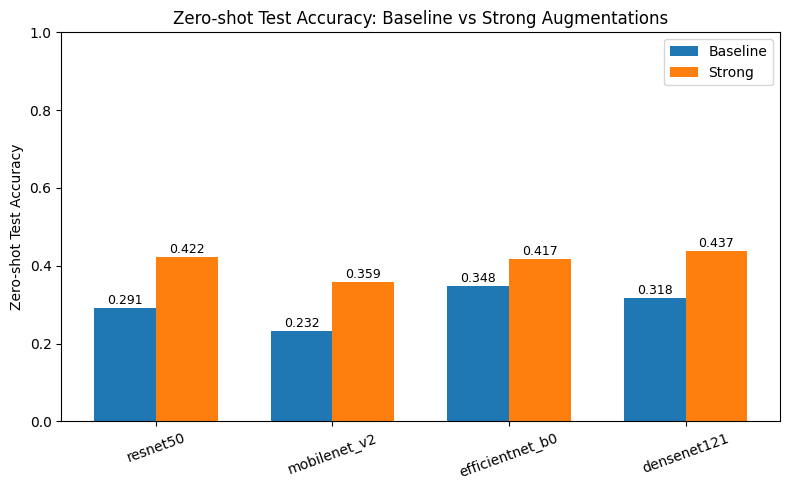

In [ ]:
import torch
import numpy as np
from pathlib import Path
from torchvision import models
import torch.nn as nn
import matplotlib.pyplot as plt

# --- Config ---
MODEL_DIR_BASE = Path('/content/drive/MyDrive/zero_shot_models2')
MODEL_DIR_STRONG = Path('/content/drive/MyDrive/zero_shot_models1_zs_strong')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
NUM_CLASSES = 27  # <-- Change to match your project
# Make sure your test_loader is already defined and points to the real test set

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
RUN_SUBSET = ['resnet50', 'mobilenet_v2', 'efficientnet_b0', 'densenet121']

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model
    return builder

def eval_checkpoint(model_path, ctor, WE):
    model = make_model_fn(ctor, WE)()
    model.load_state_dict(torch.load(model_path, map_location=DEVICE), strict=True)
    model.eval()
    all_preds, all_true = [], []
    with torch.no_grad():
        for X, y in test_loader:
            X, y = X.to(DEVICE), y.to(DEVICE)
            preds = model(X).argmax(1)
            all_preds.append(preds.cpu().numpy())
            all_true.append(y.cpu().numpy())
    y_true = np.concatenate(all_true)
    y_pred = np.concatenate(all_preds)
    return (y_true == y_pred).mean() if len(y_true) else float('nan')

results = []
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    ckpt_base = MODEL_DIR_BASE / f"{name}_zs_best.pt"
    ckpt_strong = MODEL_DIR_STRONG / f"{name}_zs_strong_best.pt"

    acc_base = eval_checkpoint(ckpt_base, ctor, WE) if ckpt_base.exists() else float('nan')
    acc_strong = eval_checkpoint(ckpt_strong, ctor, WE) if ckpt_strong.exists() else float('nan')
    print(f"{name:16s} baseline={acc_base:.3f}   strong={acc_strong:.3f}")

    results.append((name, acc_base, acc_strong))

# --- Visualization ---
labels = [r[0] for r in results]
baseline_accs = [r[1] for r in results]
strong_accs = [r[2] for r in results]
x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,5))
plt.bar(x - width/2, baseline_accs, width, label='Baseline')
plt.bar(x + width/2, strong_accs, width, label='Strong')
plt.xticks(x, labels, rotation=20)
plt.ylim(0, 1.0)
plt.ylabel('Zero-shot Test Accuracy')
plt.title('Zero-shot Test Accuracy: Baseline vs Strong Augmentations')
plt.legend()
for i, (b, s) in enumerate(zip(baseline_accs, strong_accs)):
    plt.text(i-width/2, b+0.01, f"{b:.3f}", ha='center', fontsize=9)
    plt.text(i+width/2, s+0.01, f"{s:.3f}", ha='center', fontsize=9)
plt.tight_layout()
plt.show()

In [ ]:
# ╔══════════════════════════════════════════════════════╗
# CELL 7 – PyTorch training w/ epoch checkpoints & history
#            → now saving under zero_shot_models2
# ╚══════════════════════════════════════════════════════╝
import torch, torch.nn as nn, torch.optim as optim
import pickle, glob, re, time
from pathlib import Path
from torchvision import models

# 1) Set up new MODEL_DIR & HISTORY_F
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models1')
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR/'history_zero_shot.pkl'

# 2) Load or init history
try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys()))
except FileNotFoundError:
    histories = {}

# 3) Helper to find latest per-epoch checkpoint
def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_zs_epoch*.pt"))
    return files[-1] if files else None

# 4) Backbones & subset
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0,  models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['mobilenet_v2']

# 5) Model builder factory
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base,'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

# 6) Training loop
for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    # paths under MODEL_DIR
    prefix   = f"{name}_zs"
    best_pt  = MODEL_DIR/f"{prefix}_best.pt"
    last_pt  = latest_ckpt(name)

    # restore or init per-model history
    hist = histories.get(name, {
        'train_acc':[], 'val_acc':[],
        'train_loss':[], 'val_loss':[], 'lr':[]
    })

    builder = make_model_fn(ctor, WE)

    # resume?
    start_ep = 1
    best_val = 0.0
    if last_pt:
        print(f"🔹 Resuming {name} from {last_pt.name}")
        tmp, _ = builder(); tmp.load_state_dict(torch.load(last_pt))
        model, base = builder()
        for ps, pt in zip(tmp.parameters(), model.parameters()):
            pt.data.copy_(ps.data)
        start_ep = int(re.search(r'epoch(\d+)', last_pt.name).group(1)) + 1
        # truncate old history beyond start_ep-1
        for k in hist:
            hist[k] = hist[k][: start_ep-1]
    else:
        print(f"\n🔄 Training {name} from scratch")
        model, base = builder()

    # per-epoch training
    for ep in range(start_ep, EPOCHS+1):
        t0 = time.time()

        # optimizer
        if ep <= HEAD_EPOCHS:
            for p in base.parameters(): p.requires_grad = False
            optimizer = optim.Adam(
                filter(lambda p:p.requires_grad, model.parameters()),
                lr=LR_HEAD
            )
        elif ep == HEAD_EPOCHS+1:
            for p in model.parameters(): p.requires_grad = True
            optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

        lr = optimizer.param_groups[0]['lr']

        # — train —
        model.train()
        tot_loss=tot_n=correct=0
        for X,y in train_loader:
            X,y = X.to(DEVICE), y.to(DEVICE)
            optimizer.zero_grad()
            out = model(X)
            loss= nn.CrossEntropyLoss()(out, y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct += (preds==y).sum().item()
            n = y.size(0); tot_n+=n; tot_loss+=loss.item()*n
        tr_acc  = correct/tot_n
        tr_loss = tot_loss/tot_n

        # — validate —
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X,y in val_loader:
                X,y = X.to(DEVICE), y.to(DEVICE)
                out  = model(X)
                loss = nn.CrossEntropyLoss()(out, y)
                preds = out.argmax(1)
                correct += (preds==y).sum().item()
                n = y.size(0); tot_n+=n; tot_loss+=loss.item()*n
        val_acc  = correct/tot_n
        val_loss = tot_loss/tot_n

        # log
        print(f"{name:>12s} [{ep:02d}/{EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save epoch & best
        epoch_pt = MODEL_DIR/f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)
        if val_acc > best_val:
            best_val = val_acc
            torch.save(model.state_dict(), best_pt)

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

    # persist histories
    histories[name] = hist
    with open(HISTORY_F, 'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} done (best val_acc={best_val:.3f})")


✅ Loaded history for: ['resnet50']

🔄 Training mobilenet_v2 from scratch


Downloading: "https://download.pytorch.org/models/mobilenet_v2-7ebf99e0.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-7ebf99e0.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 30.0MB/s]


mobilenet_v2 [01/15] acc 0.623 | val 0.757 | loss 1.84 | val_loss 1.16 | lr 1.0e-03 | 316s
mobilenet_v2 [02/15] acc 0.798 | val 0.817 | loss 0.93 | val_loss 0.78 | lr 1.0e-03 | 303s
mobilenet_v2 [03/15] acc 0.836 | val 0.829 | loss 0.69 | val_loss 0.66 | lr 1.0e-03 | 300s
mobilenet_v2 [04/15] acc 0.984 | val 0.999 | loss 0.07 | val_loss 0.01 | lr 1.0e-04 | 320s
mobilenet_v2 [05/15] acc 0.998 | val 1.000 | loss 0.01 | val_loss 0.00 | lr 1.0e-04 | 323s
mobilenet_v2 [06/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 321s
mobilenet_v2 [07/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 320s
mobilenet_v2 [08/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 317s
mobilenet_v2 [09/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 314s
mobilenet_v2 [10/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 314s
mobilenet_v2 [11/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 316s

In [ ]:

#PyTorch training w/ correct optimizer logic

import torch, torch.nn as nn, torch.optim as optim
import pickle, glob, re, time
from pathlib import Path
from torchvision import models

# 1) MODEL_DIR & HISTORY
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models2')
MODEL_DIR.mkdir(parents=True, exist_ok=True)
HISTORY_F = MODEL_DIR/'history_zero_shot.pkl'

# 2) load or init histories
try:
    with open(HISTORY_F,'rb') as fp:
        histories = pickle.load(fp)
except FileNotFoundError:
    histories = {}

# 3) helper to find last checkpoint
def latest_ckpt(name):
    files = sorted(MODEL_DIR.glob(f"{name}_zs_epoch*.pt"))
    return files[-1] if files else None

# 4) backbones & subset
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0,  models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['densenet121']

# 5) model factory
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base,'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

# 6) training loop
for name,(ctor,WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix = f"{name}_zs"
    best_pt = MODEL_DIR/f"{prefix}_best.pt"
    last_pt = latest_ckpt(name)

    # restore or init history
    hist = histories.get(name, {'train_acc':[],'val_acc':[],
                                'train_loss':[],'val_loss':[],'lr':[]})

    builder = make_model_fn(ctor, WE)

    # resume weights
    start_ep = 1
    best_val = 0.0
    if last_pt:
        print(f"🔹 Resuming {name} from {last_pt.name}")
        tmp, _ = builder(); tmp.load_state_dict(torch.load(last_pt))
        model, base = builder()
        for ps, pt in zip(tmp.parameters(), model.parameters()):
            pt.data.copy_(ps.data)
        start_ep = int(re.search(r'epoch(\d+)', last_pt.name).group(1)) + 1
        # truncate old history
        for k in hist:
            hist[k] = hist[k][: start_ep-1]
    else:
        print(f"\n🔄 Training {name} from scratch")
        model, base = builder()

    # Initialize optimizer based on start_ep
    if start_ep <= HEAD_EPOCHS:
        for p in base.parameters(): p.requires_grad=False
        optimizer = optim.Adam(filter(lambda p:p.requires_grad, model.parameters()), lr=LR_HEAD)
    else:
        for p in model.parameters(): p.requires_grad=True
        optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

    # epoch loop
    for ep in range(start_ep, EPOCHS+1):
        t0 = time.time()

        # if we hit the transition epoch, re-init optimizer
        if ep == HEAD_EPOCHS+1:
            for p in model.parameters(): p.requires_grad=True
            optimizer = optim.Adam(model.parameters(), lr=LR_FINE)

        lr = optimizer.param_groups[0]['lr']

        # — train —
        model.train()
        tot_loss=tot_n=correct=0
        for X,y in train_loader:
            X,y = X.to(DEVICE), y.to(DEVICE)
            optimizer.zero_grad()
            out   = model(X)
            loss  = nn.CrossEntropyLoss()(out,y)
            loss.backward(); optimizer.step()
            preds = out.argmax(1)
            correct  += (preds==y).sum().item()
            n = y.size(0); tot_n+=n; tot_loss+=loss.item()*n
        tr_acc  = correct/tot_n
        tr_loss = tot_loss/tot_n

        # — validate —
        model.eval()
        tot_loss=tot_n=correct=0
        with torch.no_grad():
            for X,y in val_loader:
                X,y = X.to(DEVICE), y.to(DEVICE)
                out   = model(X)
                loss  = nn.CrossEntropyLoss()(out,y)
                preds = out.argmax(1)
                correct  += (preds==y).sum().item()
                n = y.size(0); tot_n+=n; tot_loss+=loss.item()*n
        val_acc  = correct/tot_n
        val_loss = tot_loss/tot_n

        # log
        print(f"{name:>12s} [{ep:02d}/{EPOCHS:02d}] "
              f"acc {tr_acc:.3f} | val {val_acc:.3f} | "
              f"loss {tr_loss:.2f} | val_loss {val_loss:.2f} | "
              f"lr {lr:.1e} | {int(time.time()-t0)}s")

        # save
        epoch_pt = MODEL_DIR/f"{prefix}_epoch{ep:02d}.pt"
        torch.save(model.state_dict(), epoch_pt)
        if val_acc>best_val:
            best_val=val_acc
            torch.save(model.state_dict(), best_pt)

        # record
        hist['train_acc'].append(tr_acc)
        hist['val_acc'].append(val_acc)
        hist['train_loss'].append(tr_loss)
        hist['val_loss'].append(val_loss)
        hist['lr'].append(lr)

    # persist
    histories[name] = hist
    with open(HISTORY_F,'wb') as fp:
        pickle.dump(histories, fp)

    print(f"{name:>12s} done (best val_acc={best_val:.3f})")



🔄 Training densenet121 from scratch


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 120MB/s] 


 densenet121 [01/15] acc 0.638 | val 0.834 | loss 1.65 | val_loss 0.91 | lr 1.0e-03 | 329s
 densenet121 [02/15] acc 0.843 | val 0.865 | loss 0.76 | val_loss 0.62 | lr 1.0e-03 | 326s
 densenet121 [03/15] acc 0.874 | val 0.887 | loss 0.56 | val_loss 0.51 | lr 1.0e-03 | 324s
 densenet121 [04/15] acc 0.995 | val 0.993 | loss 0.02 | val_loss 0.02 | lr 1.0e-04 | 380s
 densenet121 [05/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 378s
 densenet121 [06/15] acc 0.999 | val 0.996 | loss 0.00 | val_loss 0.01 | lr 1.0e-04 | 377s
 densenet121 [07/15] acc 0.998 | val 0.999 | loss 0.01 | val_loss 0.00 | lr 1.0e-04 | 376s
 densenet121 [08/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 381s
 densenet121 [09/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 373s
 densenet121 [10/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04 | 372s
 densenet121 [11/15] acc 0.999 | val 0.997 | loss 0.00 | val_loss 0.01 | lr 1.0e-04 | 375s

In [ ]:
import pickle
from pathlib import Path

base = Path('/content/drive/MyDrive/zero_shot_models2/history_zero_shot.pkl')
extra = Path('/content/drive/MyDrive/zero_shot_models2/history_zero_shot(1).pkl')

# 1) Load the primary history
with base.open('rb') as f:
    histories = pickle.load(f)

# 2) Load the “(1)” file, but only add keys that aren’t already in `histories`
with extra.open('rb') as f:
    more = pickle.load(f)
for name, data in more.items():
    if name in histories:
        print(f"🔹 Skipping {name} (already in base history)")
    else:
        print(f"➕ Adding {name} from the extra file")
        histories[name] = data

# 3) (Optionally) overwrite your base file, or write to a new merged file
merged = base  # or Path(.../'merged_history.pkl')
with merged.open('wb') as f:
    pickle.dump(histories, f)

print("Final models in history:", list(histories.keys()))


🔹 Skipping mobilenet_v2 (already in base history)
➕ Adding efficientnet_b0 from the extra file
Final models in history: ['resnet50', 'mobilenet_v2', 'densenet121', 'efficientnet_b0']


In [ ]:

# CELL 9 – Replay epoch‐by‐epoch logs from Drive

import pickle
from pathlib import Path

# Path to your unified history pickle
HISTORY_F = Path('/content/drive/MyDrive/zero_shot_models2/history_zero_shot.pkl')

# Load the histories dict
with open(HISTORY_F, 'rb') as fp:
    histories = pickle.load(fp)

# For each model, print its epoch logs
for name, hist in histories.items():
    n_ep = len(hist['train_acc'])
    print(f"\n Replaying {name} — {n_ep} epochs")
    for i in range(n_ep):
        tr_a = hist['train_acc'][i]
        tr_l = hist['train_loss'][i]
        va_a = hist['val_acc'][i]
        va_l = hist['val_loss'][i]
        lr   = hist['lr'][i]
        print(f"{name:>12s} [{i+1:02d}/{n_ep:02d}] "
              f"acc {tr_a:.3f} | val {va_a:.3f} | "
              f"loss {tr_l:.2f} | val_loss {va_l:.2f} | "
              f"lr {lr:.1e}")



 Replaying resnet50 — 15 epochs
    resnet50 [01/15] acc 0.586 | val 0.774 | loss 1.99 | val_loss 1.28 | lr 1.0e-03
    resnet50 [02/15] acc 0.808 | val 0.830 | loss 1.00 | val_loss 0.81 | lr 1.0e-03
    resnet50 [03/15] acc 0.859 | val 0.861 | loss 0.69 | val_loss 0.62 | lr 1.0e-03
    resnet50 [04/15] acc 0.993 | val 0.999 | loss 0.03 | val_loss 0.00 | lr 1.0e-04
    resnet50 [05/15] acc 0.999 | val 1.000 | loss 0.01 | val_loss 0.00 | lr 1.0e-04
    resnet50 [06/15] acc 0.999 | val 0.999 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [07/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [08/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [09/15] acc 0.998 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [10/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [11/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.01 | lr 1.0e-04
    resnet50 [12/15] acc 1.000 | val 1.000 

In [ ]:

# CELL 9 – Replay epoch‐by‐epoch logs from Drive

import pickle
from pathlib import Path

# Path to your unified history pickle
HISTORY_F = Path('/content/drive/MyDrive/zero_shot_models2/history_zero_shot.pkl')

# Load the histories dict
with open(HISTORY_F, 'rb') as fp:
    histories = pickle.load(fp)

# For each model, print its epoch logs
for name, hist in histories.items():
    n_ep = len(hist['train_acc'])
    print(f"\n Replaying {name} — {n_ep} epochs")
    for i in range(n_ep):
        tr_a = hist['train_acc'][i]
        tr_l = hist['train_loss'][i]
        va_a = hist['val_acc'][i]
        va_l = hist['val_loss'][i]
        lr   = hist['lr'][i]
        print(f"{name:>12s} [{i+1:02d}/{n_ep:02d}] "
              f"acc {tr_a:.3f} | val {va_a:.3f} | "
              f"loss {tr_l:.2f} | val_loss {va_l:.2f} | "
              f"lr {lr:.1e}")



 Replaying resnet50 — 15 epochs
    resnet50 [01/15] acc 0.586 | val 0.774 | loss 1.99 | val_loss 1.28 | lr 1.0e-03
    resnet50 [02/15] acc 0.808 | val 0.830 | loss 1.00 | val_loss 0.81 | lr 1.0e-03
    resnet50 [03/15] acc 0.859 | val 0.861 | loss 0.69 | val_loss 0.62 | lr 1.0e-03
    resnet50 [04/15] acc 0.993 | val 0.999 | loss 0.03 | val_loss 0.00 | lr 1.0e-04
    resnet50 [05/15] acc 0.999 | val 1.000 | loss 0.01 | val_loss 0.00 | lr 1.0e-04
    resnet50 [06/15] acc 0.999 | val 0.999 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [07/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [08/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [09/15] acc 0.998 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [10/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
    resnet50 [11/15] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.01 | lr 1.0e-04
    resnet50 [12/15] acc 1.000 | val 1.000 

In [ ]:

# CELL 9 – Replay epoch‐by‐epoch logs from Drive

import pickle
from pathlib import Path

# Path to your unified history pickle
HISTORY_F = Path('/content/drive/MyDrive/zero_shot_models2/history_zero_shot(1).pkl')

# Load the histories dict
with open(HISTORY_F, 'rb') as fp:
    histories = pickle.load(fp)

# For each model, print its epoch logs
for name, hist in histories.items():
    n_ep = len(hist['train_acc'])
    print(f"\n Replaying {name} — {n_ep} epochs")
    for i in range(n_ep):
        tr_a = hist['train_acc'][i]
        tr_l = hist['train_loss'][i]
        va_a = hist['val_acc'][i]
        va_l = hist['val_loss'][i]
        lr   = hist['lr'][i]
        print(f"{name:>12s} [{i+1:02d}/{n_ep:02d}] "
              f"acc {tr_a:.3f} | val {va_a:.3f} | "
              f"loss {tr_l:.2f} | val_loss {va_l:.2f} | "
              f"lr {lr:.1e}")



 Replaying mobilenet_v2 — 1 epochs
mobilenet_v2 [01/01] acc 0.999 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-03

 Replaying efficientnet_b0 — 15 epochs
efficientnet_b0 [01/15] acc 0.688 | val 0.834 | loss 1.53 | val_loss 0.81 | lr 1.0e-03
efficientnet_b0 [02/15] acc 0.826 | val 0.873 | loss 0.74 | val_loss 0.53 | lr 1.0e-03
efficientnet_b0 [03/15] acc 0.848 | val 0.884 | loss 0.59 | val_loss 0.45 | lr 1.0e-03
efficientnet_b0 [04/15] acc 0.984 | val 1.000 | loss 0.06 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [05/15] acc 0.998 | val 0.999 | loss 0.01 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [06/15] acc 0.999 | val 1.000 | loss 0.01 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [07/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [08/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [09/15] acc 1.000 | val 1.000 | loss 0.00 | val_loss 0.00 | lr 1.0e-04
efficientnet_b0 [10/15] acc 0.999 | val 1.000 | loss 0.00

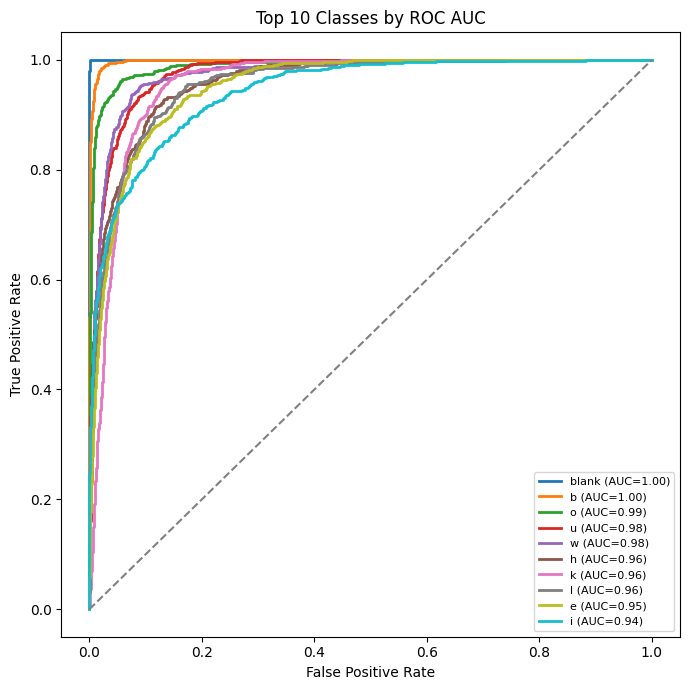

In [ ]:

# CELL – Compute y_true / y_score & plot Top-10 ROC Curves by AUC

import torch, torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# 1) Collect true labels and softmax scores on the real test set
model.eval()
y_true = []
y_score = []  # each row will be a length-27 prob vector

with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)                   # (batch, NUM_CLASSES)
        probs  = F.softmax(logits, dim=1)   # convert to probabilities
        y_score.append(probs.cpu().numpy())
        y_true .append(y.numpy())

y_score = np.vstack(y_score)     # shape (N_samples, NUM_CLASSES)
y_true  = np.concatenate(y_true) # shape (N_samples,)

# 2) Compute per-class ROC & AUC
aucs = []
for i, cls in enumerate(class_names):
    y_bin = (y_true == i).astype(int)
    fpr, tpr, _ = roc_curve(y_bin, y_score[:, i])
    roc_auc = auc(fpr, tpr)
    aucs.append((cls, roc_auc, fpr, tpr))

# 3) Pick the top-10 by AUC
top10 = sorted(aucs, key=lambda x: x[1], reverse=True)[:10]

# 4) Plot those 10 ROC curves
plt.figure(figsize=(7,7))
for cls, roc_auc, fpr, tpr in top10:
    plt.plot(fpr, tpr, lw=2, label=f"{cls} (AUC={roc_auc:.2f})")

plt.plot([0,1],[0,1],"--", color="gray")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Top 10 Classes by ROC AUC")
plt.legend(loc="lower right", fontsize=8)
plt.tight_layout()
plt.show()


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 110MB/s] 


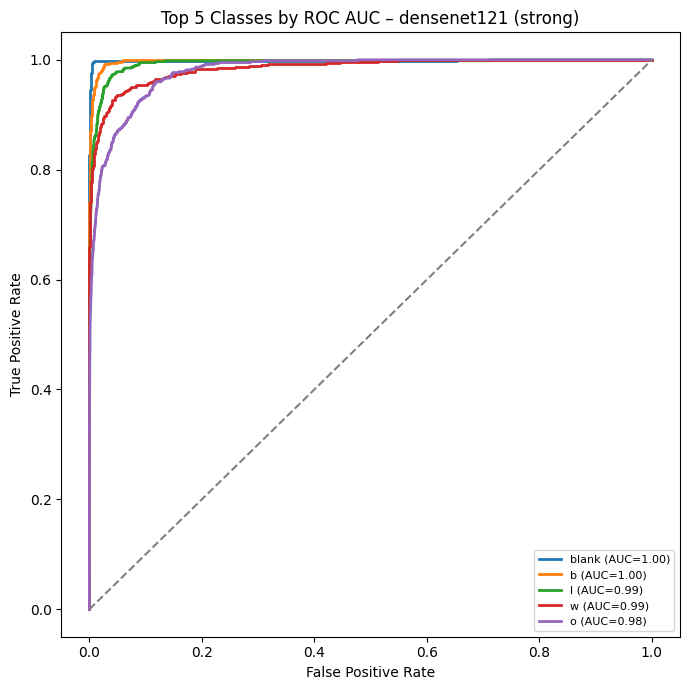

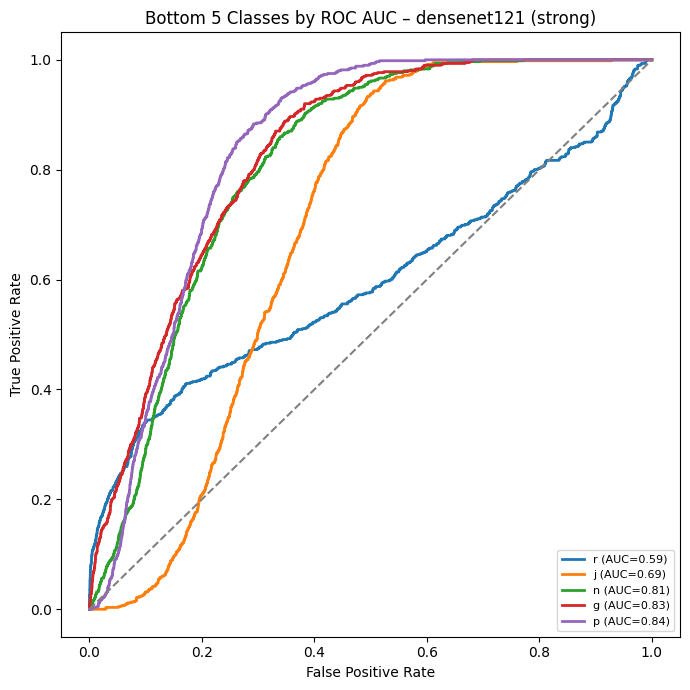

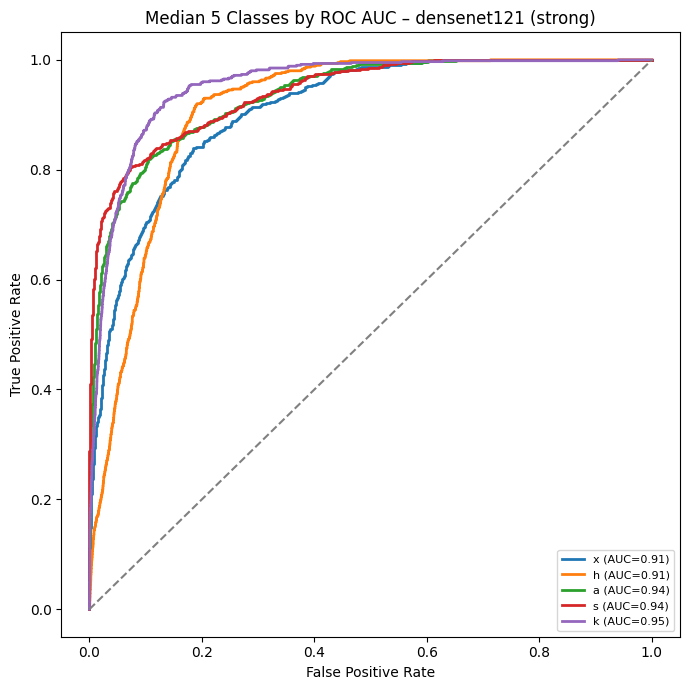

In [ ]:
import torch, torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.metrics import roc_curve, auc

# ------------- CONFIG -------------
AUG = "strong"  # or "baseline"
MODEL_NAME = "densenet121"    # Best model for ROC plots
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
NUM_CLASSES = 27

# --- Use your real ASL class names here! ---
# class_names = [
#     'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M',
#     'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z',
#     'nothing', 'delete', 'space'
# ]
# Assert removed to prevent early exit if NUM_CLASSES is changed elsewhere
# assert len(class_names) == NUM_CLASSES, "Check class_names length!"

# Get class names from syn_train_ds (assuming it's available and correct)
try:
    class_names = syn_train_ds.classes
except NameError:
    print("Warning: syn_train_ds not found. Using default class names a-z + blank.")
    # Fallback if syn_train_ds is not available
    class_names = [chr(i + ord('a')) for i in range(26)] + ['blank']


# --- Directory structure based on your uploads ---
BASE = Path('/content/drive/MyDrive')
MODEL_DIR = BASE / f'zero_shot_models1_zs_{AUG}'
CKPT_PATH = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"

from torchvision import models
import torch.nn as nn
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
ctor, WE = BACKBONES[MODEL_NAME]

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        return torch.nn.Sequential(base, head).to(DEVICE)
    return builder

# --- LOAD MODEL ---
model = make_model_fn(ctor, WE)()
model.load_state_dict(torch.load(CKPT_PATH, map_location=DEVICE), strict=True)
model.eval()

# --- EVALUATE ON TEST SET (test_loader must be defined) ---
y_true = []
y_score = []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        probs = F.softmax(logits, dim=1)
        y_score.append(probs.cpu().numpy())
        y_true.append(y.numpy())
y_score = np.vstack(y_score)
y_true = np.concatenate(y_true)

# --- ROC, AUC PER CLASS ---
aucs = []
for i, cls in enumerate(class_names):
    y_bin = (y_true == i).astype(int)
    # To avoid error when a class is missing in test set
    if np.sum(y_bin) == 0:
        roc_auc, fpr, tpr = np.nan, np.array([0, 1]), np.array([0, 1])
    else:
        fpr, tpr, _ = roc_curve(y_bin, y_score[:, i])
        roc_auc = auc(fpr, tpr)
    aucs.append((cls, roc_auc, fpr, tpr))

aucs_sorted = sorted(aucs, key=lambda x: x[1] if not np.isnan(x[1]) else -1)
top5    = aucs_sorted[-5:][::-1]
bottom5 = aucs_sorted[:5]
mid5    = aucs_sorted[len(aucs_sorted)//2-2 : len(aucs_sorted)//2+3]  # Centered median

def plot_roc_set(set_name, auc_list):
    plt.figure(figsize=(7,7))
    for cls, roc_auc, fpr, tpr in auc_list:
        label = f"{cls} (AUC={roc_auc:.2f})" if not np.isnan(roc_auc) else f"{cls} (AUC=N/A)"
        plt.plot(fpr, tpr, lw=2, label=label)
    plt.plot([0,1],[0,1],"--", color="gray")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(f"{set_name} Classes by ROC AUC – {MODEL_NAME} ({AUG})")
    plt.legend(loc="lower right", fontsize=8)
    plt.tight_layout()
    plt.show()

# --- PLOT ---
plot_roc_set("Top 5",    top5)
plot_roc_set("Bottom 5", bottom5)
plot_roc_set("Median 5", mid5)

They’re the 10 signs that generalize most cleanly from your synthetic training set to the real test images.

An AUC near 1.0 (like “blank” and “b” here) means the model can almost perfectly separate that class from all the others on real data, across every possible confidence threshold.

Lower-ranked letters (outside the top 10) have more overlap with other classes—so they’re harder for the model to zero-shot transfer.

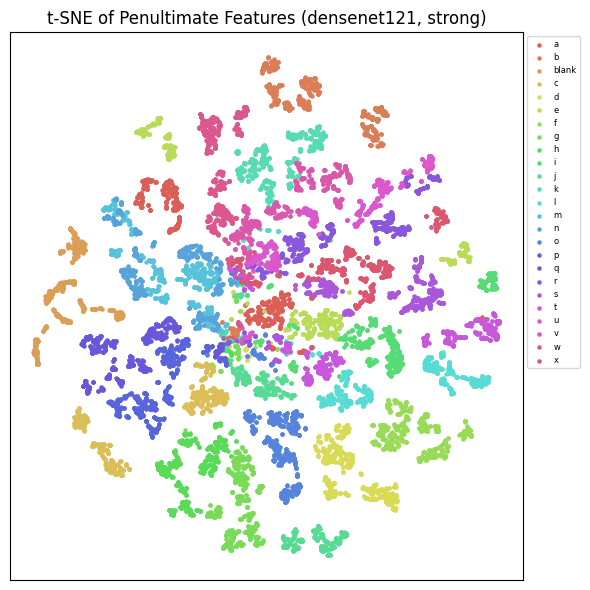

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from pathlib import Path
import torch

AUG = "strong"
MODEL_NAME = "densenet121"
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dynamically get class names
def base(ds):
    return ds.dataset if isinstance(ds, torch.utils.data.Subset) else ds

# Access class names from the first dataset in the ConcatDataset
class_names = base(test_loader.dataset.datasets[0]).classes
NUM_CLASSES = len(class_names) # This will be 27 based on the dataset

from torchvision import models
import torch.nn as nn

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights, lambda m: m.layer4[-1]),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights, lambda m: m.features[-1]),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights, lambda m: m.features[-1]),
    'densenet121': (models.densenet121, models.DenseNet121_Weights, lambda m: m.features[-1]),
}

# Define MODEL_DIR
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models2')

# The same factory you used in Cell 7, ensuring 27 output classes
def make_model_fn(ctor, weights_enum):
    def builder():
        base = ctor(weights=weights_enum.DEFAULT)
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            in_f = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(in_f, 27) # Explicitly set output features to 27
        return nn.Sequential(base, head).to(DEVICE), base
    return builder

ctor, WEIGHT_ENUM, get_last_conv = BACKBONES[MODEL_NAME]
model, base = make_model_fn(ctor, WEIGHT_ENUM)()
model.load_state_dict(torch.load(MODEL_DIR / f"{MODEL_NAME}_zs_best.pt", map_location=DEVICE))
model.eval().to(DEVICE)
# End of added code


feats, labs = [], []
with torch.no_grad():
    for X, y in test_loader:
        f = model[0](X.to(DEVICE)).cpu().numpy()
        feats.append(f); labs.append(y.numpy())
feats = np.vstack(feats); labs = np.concatenate(labs)

emb = TSNE(n_components=2, random_state=0).fit_transform(feats)

plt.figure(figsize=(6,6))
palette = sns.color_palette("hls", NUM_CLASSES)
for i, cls in enumerate(class_names):
    idx = labs == i
    plt.scatter(emb[idx,0], emb[idx,1], s=5, color=palette[i], label=cls)
plt.legend(bbox_to_anchor=(1,1), fontsize=6)
plt.title(f"t-SNE of Penultimate Features ({MODEL_NAME}, {AUG})")
plt.xticks([]); plt.yticks([])
plt.tight_layout(); plt.show()

In [ ]:
print("   Using:", ckpt)


   Using: /content/drive/MyDrive/zero_shot_models1_zs_strong/efficientnet_b0_zs_strong_best.pt


In [ ]:

# CELL 8 – Zero-shot evaluation (fixed for PyTorch loop)

import torch
from pathlib import Path
from torchvision import models
import torch.nn as nn # Import nn

# Ensure we have the same BACKBONES dict from training
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0,  models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['resnet50','mobilenet_v2','densenet121','efficientnet_b0']  # adjust as needed

# Define MODEL_DIR
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models2')


# The same factory you used in Cell 7
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base,'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

for name, (ctor, WE) in BACKBONES.items():
    if RUN_SUBSET and name not in RUN_SUBSET:
        continue

    prefix  = f"{name}_zs"
    best_pt = MODEL_DIR/f"{prefix}_best.pt"
    print(f"\n Zero-shot test for {name}")

    # Rebuild and load best weights
    builder = make_model_fn(ctor, WE)
    model, _ = builder()
    model.load_state_dict(torch.load(best_pt, map_location=DEVICE))
    model.to(DEVICE).eval()

    total = correct = 0
    with torch.no_grad():
        for X, y in test_loader:
            X, y = X.to(DEVICE), y.to(DEVICE)
            preds = model(X).argmax(1)
            correct += (preds == y).sum().item()
            total   += y.size(0)

    acc = correct / total if total else 0.0
    print(f"{name:>12s} zero-shot acc: {acc:.3f}")


 Zero-shot test for resnet50
    resnet50 zero-shot acc: 0.292

 Zero-shot test for mobilenet_v2
mobilenet_v2 zero-shot acc: 0.232

 Zero-shot test for efficientnet_b0


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 185MB/s]


efficientnet_b0 zero-shot acc: 0.348

 Zero-shot test for densenet121


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 179MB/s]


 densenet121 zero-shot acc: 0.319


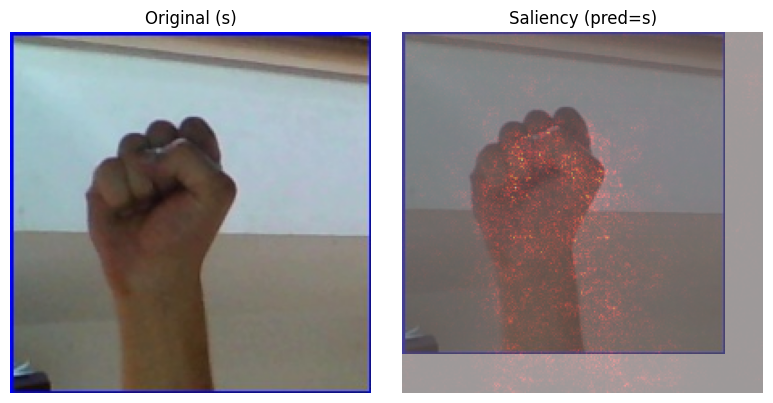

In [ ]:

# CELL – Vanilla Saliency Map for One Real‐orig Test Image (“s”)

import random
import torch, numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T
from torch.autograd import Variable
from pathlib import Path  # Import Path

# assume these exist from your earlier cells:
#   real_orig   = Subset(real_full_ds_train, real_val_indices_for_EDA)
#   class_names = syn_train_ds.classes    # 27 labels a–z + 'blank'
#   IMG_SIZE, DEVICE, make_model_fn defined as before

# Define MODEL_DIR
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models2')

# 0) Make sure you have your class-list handy:
class_names = syn_train_ds.classes   # ← must be your 27 labels a–z + 'blank'

# 1) Drill into your Subset:
base_ds     = real_orig              # the underlying ImageFolder
subset_idxs = range(len(real_orig))  # indices into base_ds.samples
s_idx       = class_names.index('s')         # find label index for “s”

# 2) Find all “s” positions in this subset:
s_positions = [
    pos for pos in subset_idxs
    if base_ds.samples[pos][1] == s_idx
]
if not s_positions:
    raise RuntimeError("No examples of 's' in real_orig!")

# 3) Pick one at random:
chosen_pos      = random.choice(s_positions)
true_base_idx   = chosen_pos
img_path, true_lbl = base_ds.samples[true_base_idx]

# 4) Display with PIL:
orig_pil = PIL.Image.open(img_path).convert("RGB")
orig_np  = np.array(orig_pil) / 255.0

# 5) And grab the same tensor from your Subset:
img_tensor, _ = real_orig[chosen_pos]
input_tensor  = img_tensor.unsqueeze(0).to(DEVICE)
input_tensor.requires_grad_()

# 6) Rebuild & load your trained model (e.g. resnet50)
model, _ = make_model_fn(models.resnet50, models.ResNet50_Weights)()
model.load_state_dict(torch.load(MODEL_DIR/"resnet50_zs_best.pt",
                                 map_location=DEVICE))
model.eval().to(DEVICE)

# 7) Forward + backward on the top prediction
output       = model(input_tensor)            # (1, NUM_CLASSES)
score, pred  = output.max(dim=1)              # best logit & class
score.backward()                              # backprop to input

# 8) Saliency = max abs‐grad across channels
saliency = input_tensor.grad.abs().squeeze().cpu()   # (3,H,W)
saliency, _ = saliency.max(dim=0)                    # (H,W)
saliency = (saliency - saliency.min()) / (saliency.max() - saliency.min())

# 9) Display side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4))
ax1.imshow(orig_np)
ax1.axis('off')
ax1.set_title(f"Original (s)")

ax2.imshow(orig_np, alpha=0.6)
ax2.imshow(saliency, cmap='hot', alpha=0.4)
ax2.axis('off')
ax2.set_title(f"Saliency (pred={class_names[pred.item()]})")

plt.tight_layout()
plt.show()

In [ ]:
# Ensure we have the same BACKBONES dict from training
BACKBONES = {
    'resnet50'       : (models.resnet50,        models.ResNet50_Weights),
    'mobilenet_v2'   : (models.mobilenet_v2,    models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0,  models.EfficientNet_B0_Weights),
    'densenet121'    : (models.densenet121,     models.DenseNet121_Weights),
}
RUN_SUBSET = ['resnet50','mobilenet_v2','densenet121','efficientnet_b0']  # adjust as needed

# Define MODEL_DIR
MODEL_DIR = Path('/content/drive/MyDrive/zero_shot_models2')


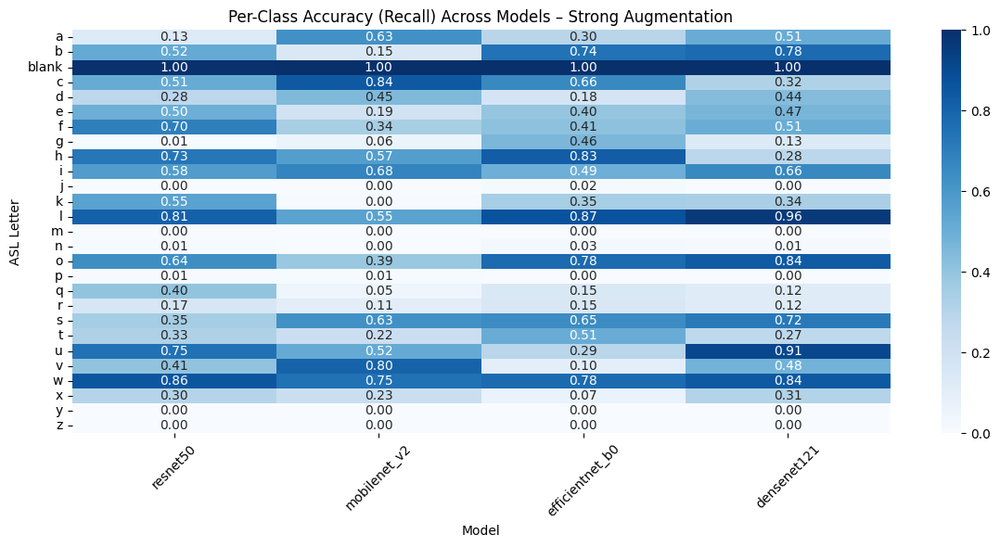

Mean Recall per Model:
resnet50           0.390
mobilenet_v2       0.340
efficientnet_b0    0.378
densenet121        0.408
dtype: float64


/tmp/ipython-input-632007815.py:97: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mean_recall.index, y=mean_recall.values, palette="Blues_d")


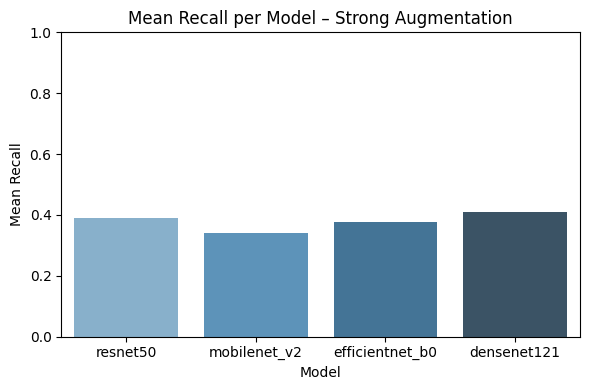

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
import torch
from pathlib import Path
import numpy as np

# --- CONFIG ---
AUG = "strong"  # or "baseline"
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Explicitly set NUM_CLASSES to 27
NUM_CLASSES = 27

def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds

# Use the class_names defined in cell yzJTWLwPu-fD
# class_names = base(test_loader.dataset.datasets[0]).classes # Removed
# Assuming class_names is already defined correctly from a previous cell
# If not, you would need to redefine it here like:
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


per_class_accuracy = {}

from torchvision import models
import torch.nn as nn
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES) # Use NUM_CLASSES here
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Loop over models and compute per-class accuracy ---
for name, (ctor, WE) in BACKBONES.items():
    best_pt = MODEL_DIR / f"{name}_zs_{AUG}_best.pt"
    if not best_pt.exists():
        print(f"Checkpoint missing for {name}: {best_pt}")
        continue

    model, _ = make_model_fn(ctor, WE)()
    model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
    model.eval()

    y_true, y_pred = [], []
    with torch.no_grad():
        for X, y in test_loader:
            X = X.to(DEVICE)
            preds = model(X).argmax(dim=1).cpu().numpy()
            y_pred.extend(preds)
            y_true.extend(y.numpy())

    report = classification_report(
        y_true, y_pred, labels=list(range(NUM_CLASSES)),
        target_names=class_names, output_dict=True, zero_division=0
    )
    # Robust: Use .get() in case any class is missing from report
    per_class_accuracy[name] = [report.get(c, {'recall': 0.0})['recall'] for c in class_names]

# --- Heatmap ---
acc_df = pd.DataFrame(per_class_accuracy, index=class_names)

plt.figure(figsize=(12, 6))
sns.heatmap(acc_df, annot=True, fmt=".2f", cmap="Blues")
plt.title(f"Per-Class Accuracy (Recall) Across Models – {AUG.capitalize()} Augmentation")
plt.ylabel("ASL Letter")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# --- Mean Recall (per model, excluding 'blank' if desired) ---
mean_recall = acc_df.mean()
print("Mean Recall per Model:")
print(mean_recall.round(3))

# To display mean recall as a bar plot (optional):
plt.figure(figsize=(6, 4))
sns.barplot(x=mean_recall.index, y=mean_recall.values, palette="Blues_d")
plt.title(f"Mean Recall per Model – {AUG.capitalize()} Augmentation")
plt.ylabel("Mean Recall")
plt.xlabel("Model")
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

In [ ]:
print("class_names:", class_names)


class_names: ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y']


The heat-map compares **per-class recall for four architectures** (ResNet-50, MobileNet-V2, EfficientNet-B0, DenseNet-121) evaluated on the *real* test set.
That directly addresses **RQ 2**:

> **RQ 2 How well do models trained on synthetic ASL images generalise to real-world images, and how do architectural differences affect generalisation across individual letters by identifying the most challenging letters?**

* **Generalisation quality** – you see each model’s real-photo recall row-by-row.
* **Architectural differences** – columns let you say “EfficientNet-B0 outperforms the others on letters *f, h, m*, while ResNet-50 dominates on *b*.”
* **Most challenging letters** – rows with low values across all columns (e.g., *g, j, m*) are immediately visible.

The plot is less relevant to:

* **RQ 1** – which asks about synthetic-set performance (not shown here).
* **RQ 3** – explainability; that needs saliency/Grad-CAM visuals.
* **RQ 4** – augmentation impact; that requires before/after comparisons.

So this figure is your key quantitative evidence for **RQ 2**.



 Hardest letters for resnet50: ['j', 'm', 'z']
 Easiest letters for resnet50: ['w', 'y', 'blank']


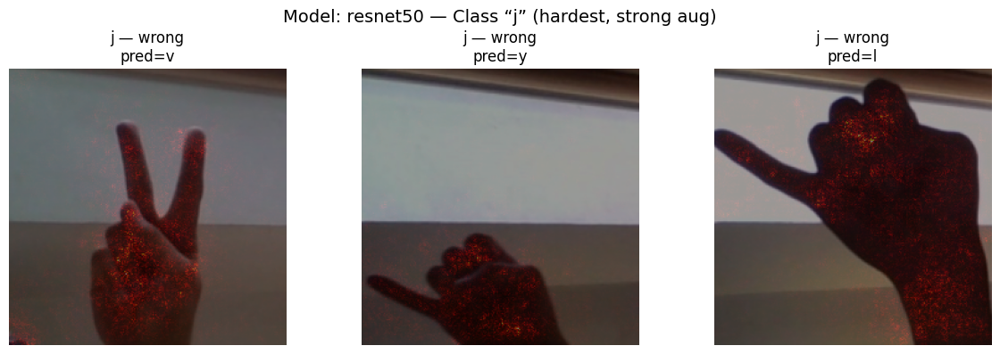

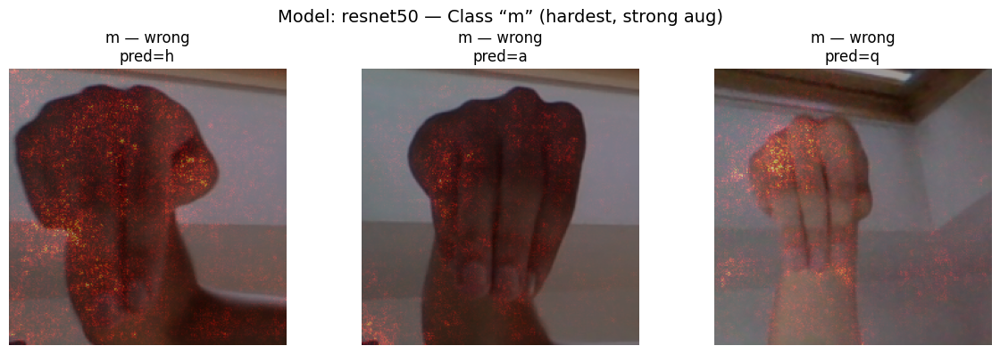

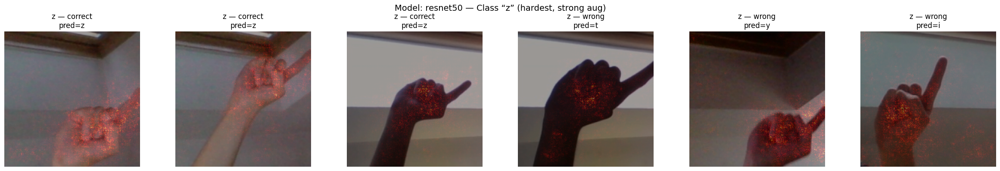

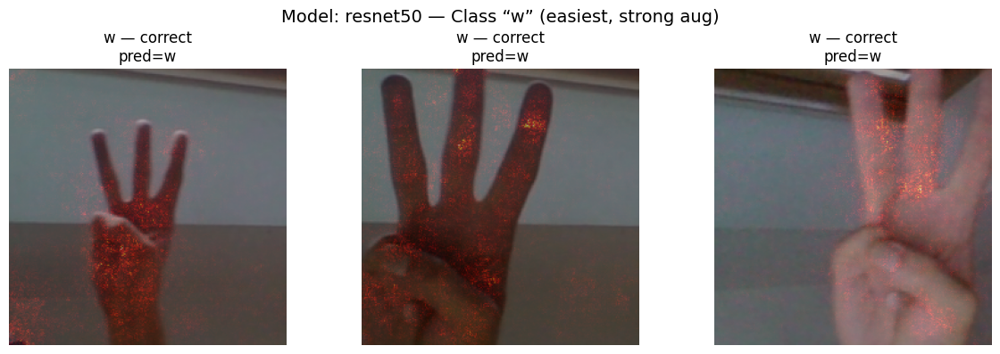

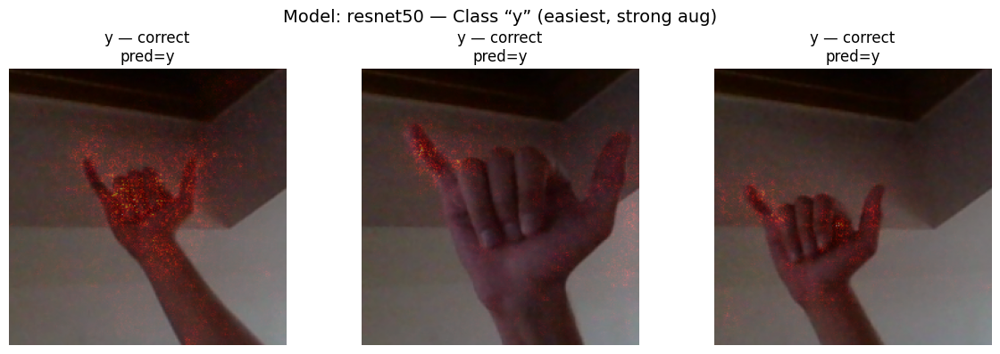

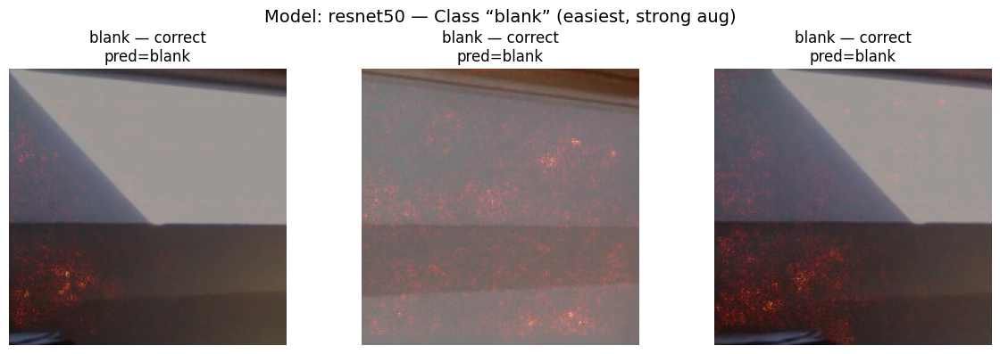

In [ ]:
from sklearn.metrics import classification_report
from collections import defaultdict
import random
import torch
import torch.nn as nn
from torchvision import models
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from torch.autograd import Variable
from torchvision import transforms as T

# --- CONFIG ---
AUG = "strong"    # "strong" or "baseline"
MODEL_NAME = 'resnet50'  # Change to your desired model
TOP_HARDEST = 3
TOP_EASIEST = 3
MAX_SAMPLES = 3

# --- Path and device ---
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Class names from test pipeline ---
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# class_names = base(test_loader.dataset.datasets[0]).classes # Removed
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(class_names)

# --- Model definition ---
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, 27) # Explicitly set output features to 27
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Build and load the model ---
ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# -----------------------------
# 1. FIND HARDEST/EASIEST CLASSES
# -----------------------------
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        preds = model(X).argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

report = classification_report(y_true, y_pred, output_dict=True, target_names=class_names, zero_division=0)
recalls = {cls: report[cls]['recall'] for cls in class_names}
sorted_recalls = sorted(recalls.items(), key=lambda x: x[1])
hardest_letters = sorted_recalls[:TOP_HARDEST]
easiest_letters = sorted_recalls[-TOP_EASIEST:]

selected_classes = {
    'hardest': [class_names.index(cls) for cls, _ in hardest_letters],
    'easiest': [class_names.index(cls) for cls, _ in easiest_letters]
}
print(f"\n Hardest letters for {MODEL_NAME}: {[x[0] for x in hardest_letters]}")
print(f" Easiest letters for {MODEL_NAME}: {[x[0] for x in easiest_letters]}")

# -----------------------------
# 2. SALIENCY FOR SELECTED CLASSES
# -----------------------------
correct_by_class = defaultdict(list)
wrong_by_class   = defaultdict(list)
all_images, all_preds, all_trues = [], [], []

with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1)

        for i in range(len(y)):
            true = y[i].item()
            pred = preds[i].item()

            if true in selected_classes['hardest'] + selected_classes['easiest']:
                all_images.append(X[i].cpu())
                all_trues.append(true)
                all_preds.append(pred)
                idx = len(all_images) - 1

                if true == pred:
                    correct_by_class[true].append(idx)
                else:
                    wrong_by_class[true].append(idx)

# -----------------------------
# 3. SALIENCY VISUALIZATION
# -----------------------------
for mode, cls_indices in selected_classes.items():
    for cls in cls_indices:
        cls_name = class_names[cls]
        correct = correct_by_class[cls][:MAX_SAMPLES]
        wrong   = wrong_by_class[cls][:MAX_SAMPLES] if mode == "hardest" else []

        picks = [("correct", i) for i in correct] + [("wrong", i) for i in wrong]

        if not picks:
            print(f"⚠️ Skipping {cls_name} — no {'correct or wrong' if mode=='hardest' else 'correct'} samples.")
            continue

        # Plot
        fig, axes = plt.subplots(1, len(picks), figsize=(4*len(picks), 4))
        if len(picks) == 1:
            axes = [axes]

        for ax, (tag, idx) in zip(axes, picks):
            img_tensor = all_images[idx]
            true_lbl   = all_trues[idx]
            pred_lbl   = all_preds[idx]

            inp = img_tensor.unsqueeze(0).to(DEVICE).requires_grad_()
            out = model(inp)
            score, _ = out.max(dim=1)
            model.zero_grad()
            score.backward()

            sal = inp.grad.abs().cpu().squeeze().max(0)[0]
            sal = (sal - sal.min()) / (sal.max() - sal.min() + 1e-8)

            img_np = img_tensor.permute(1, 2, 0).numpy()
            img_np = (img_np * np.array([0.229, 0.224, 0.225]) +
                      np.array([0.485, 0.456, 0.406]))
            img_np = np.clip(img_np, 0, 1)

            ax.imshow(img_np)
            ax.imshow(sal, cmap='hot', alpha=0.4)
            ax.axis('off')
            ax.set_title(f"{cls_name} — {tag}\n"
                         f"pred={class_names[pred_lbl]}",
                         fontsize=12)

        plt.suptitle(f"Model: {MODEL_NAME} — Class “{cls_name}” ({mode}, {AUG} aug)", fontsize=14)
        plt.tight_layout()
        plt.show()


 Hardest letters for mobilenet_v2: ['j', 'm', 'n']
 Easiest letters for mobilenet_v2: ['v', 'c', 'blank']


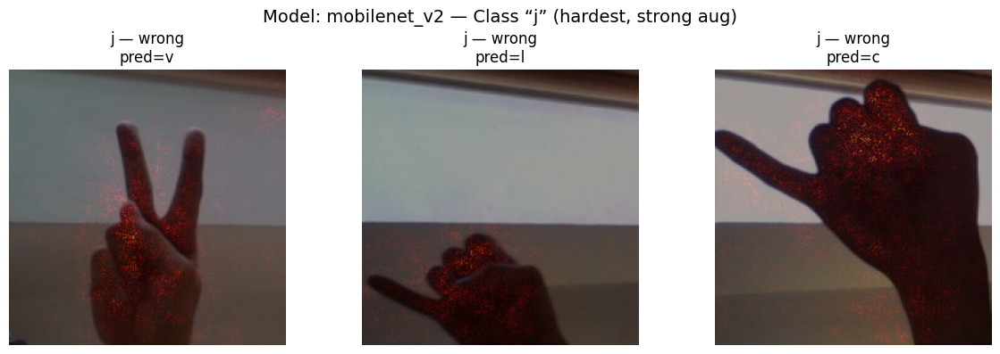

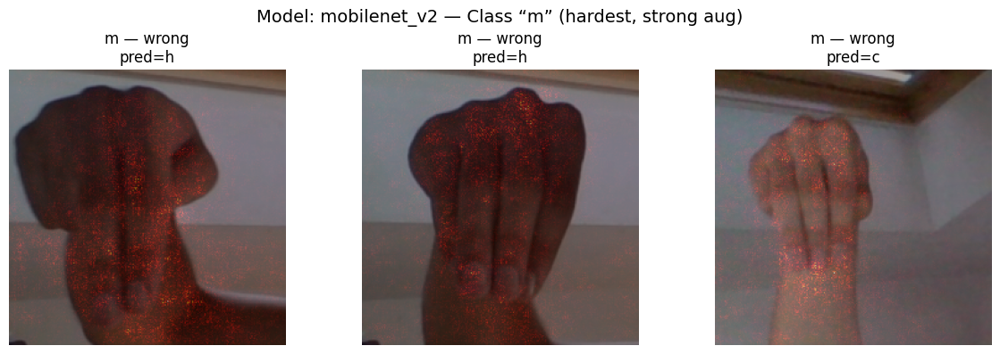

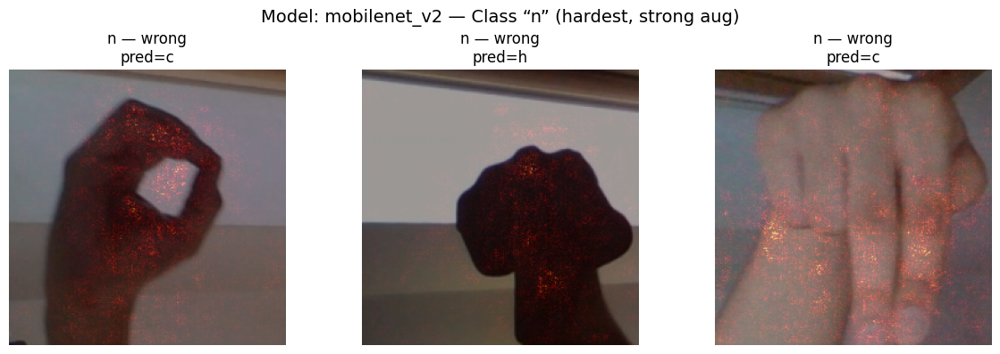

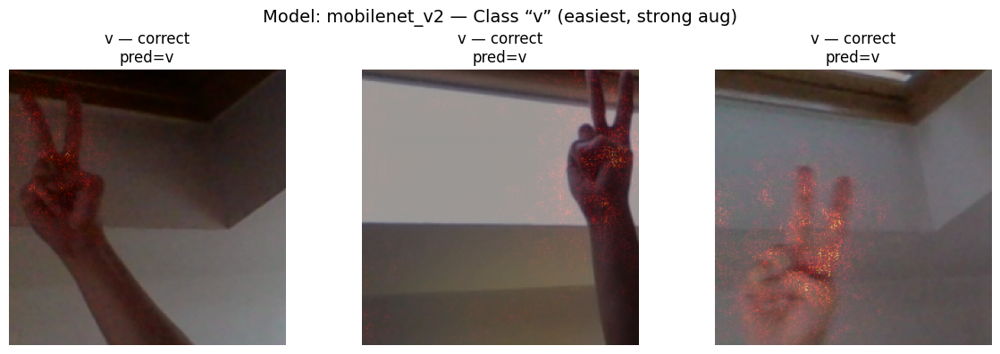

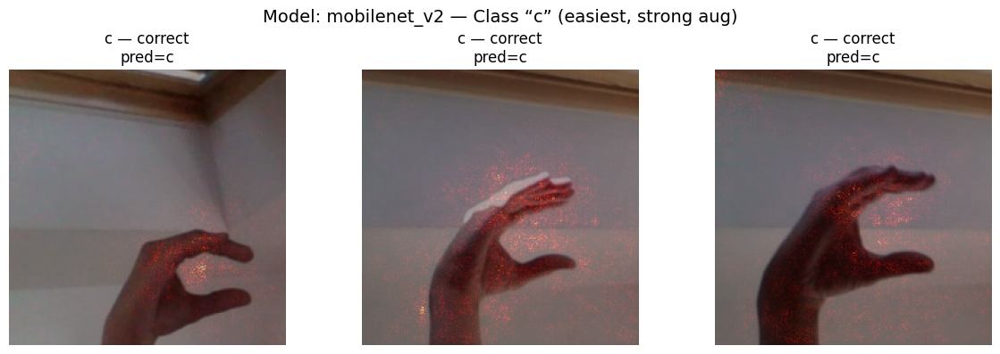

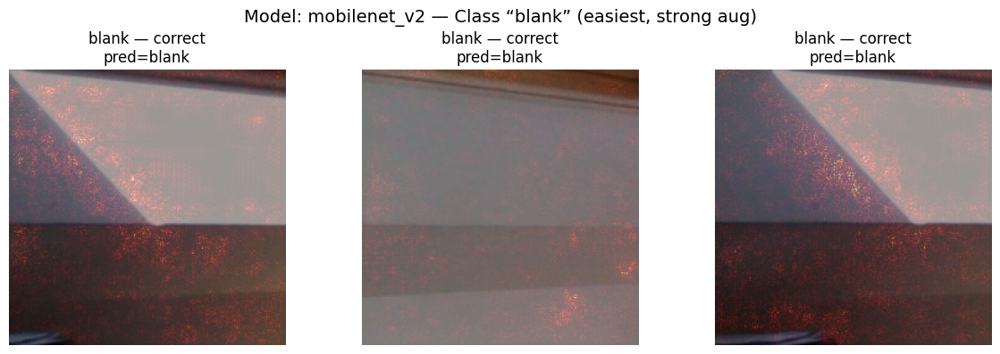

In [ ]:
from sklearn.metrics import classification_report
from collections import defaultdict
import random
import torch
import torch.nn as nn
from torchvision import models
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from torch.autograd import Variable
from torchvision import transforms as T

# --- CONFIG ---
AUG = "strong"    # "strong" or "baseline"
MODEL_NAME = 'mobilenet_v2'  # Change to your desired model
TOP_HARDEST = 3
TOP_EASIEST = 3
MAX_SAMPLES = 3

# --- Path and device ---
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Class names from test pipeline ---
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# class_names = base(test_loader.dataset.datasets[0]).classes # Removed
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(class_names)

# --- Model definition ---
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, 27) # Explicitly set output features to 27
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Build and load the model ---
ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# -----------------------------
# 1. FIND HARDEST/EASIEST CLASSES
# -----------------------------
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        preds = model(X).argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

report = classification_report(y_true, y_pred, output_dict=True, target_names=class_names, zero_division=0)
recalls = {cls: report[cls]['recall'] for cls in class_names}
sorted_recalls = sorted(recalls.items(), key=lambda x: x[1])
hardest_letters = sorted_recalls[:TOP_HARDEST]
easiest_letters = sorted_recalls[-TOP_EASIEST:]

selected_classes = {
    'hardest': [class_names.index(cls) for cls, _ in hardest_letters],
    'easiest': [class_names.index(cls) for cls, _ in easiest_letters]
}
print(f"\n Hardest letters for {MODEL_NAME}: {[x[0] for x in hardest_letters]}")
print(f" Easiest letters for {MODEL_NAME}: {[x[0] for x in easiest_letters]}")

# -----------------------------
# 2. SALIENCY FOR SELECTED CLASSES
# -----------------------------
correct_by_class = defaultdict(list)
wrong_by_class   = defaultdict(list)
all_images, all_preds, all_trues = [], [], []

with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1)

        for i in range(len(y)):
            true = y[i].item()
            pred = preds[i].item()

            if true in selected_classes['hardest'] + selected_classes['easiest']:
                all_images.append(X[i].cpu())
                all_trues.append(true)
                all_preds.append(pred)
                idx = len(all_images) - 1

                if true == pred:
                    correct_by_class[true].append(idx)
                else:
                    wrong_by_class[true].append(idx)

# -----------------------------
# 3. SALIENCY VISUALIZATION
# -----------------------------
for mode, cls_indices in selected_classes.items():
    for cls in cls_indices:
        cls_name = class_names[cls]
        correct = correct_by_class[cls][:MAX_SAMPLES]
        wrong   = wrong_by_class[cls][:MAX_SAMPLES] if mode == "hardest" else []

        picks = [("correct", i) for i in correct] + [("wrong", i) for i in wrong]

        if not picks:
            print(f"⚠️ Skipping {cls_name} — no {'correct or wrong' if mode=='hardest' else 'correct'} samples.")
            continue

        # Plot
        fig, axes = plt.subplots(1, len(picks), figsize=(4*len(picks), 4))
        if len(picks) == 1:
            axes = [axes]

        for ax, (tag, idx) in zip(axes, picks):
            img_tensor = all_images[idx]
            true_lbl   = all_trues[idx]
            pred_lbl   = all_preds[idx]

            inp = img_tensor.unsqueeze(0).to(DEVICE).requires_grad_()
            out = model(inp)
            score, _ = out.max(dim=1)
            model.zero_grad()
            score.backward()

            sal = inp.grad.abs().cpu().squeeze().max(0)[0]
            sal = (sal - sal.min()) / (sal.max() - sal.min() + 1e-8)

            img_np = img_tensor.permute(1, 2, 0).numpy()
            img_np = (img_np * np.array([0.229, 0.224, 0.225]) +
                      np.array([0.485, 0.456, 0.406]))
            img_np = np.clip(img_np, 0, 1)

            ax.imshow(img_np)
            ax.imshow(sal, cmap='hot', alpha=0.4)
            ax.axis('off')
            ax.set_title(f"{cls_name} — {tag}\n"
                         f"pred={class_names[pred_lbl]}",
                         fontsize=12)

        plt.suptitle(f"Model: {MODEL_NAME} — Class “{cls_name}” ({mode}, {AUG} aug)", fontsize=14)
        plt.tight_layout()
        plt.show()


 Hardest letters for efficientnet_b0: ['m', 'p', 'j']
 Easiest letters for efficientnet_b0: ['h', 'l', 'blank']


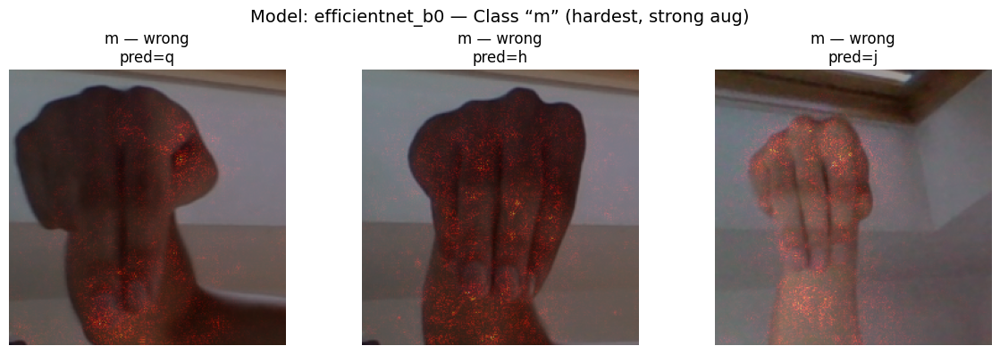

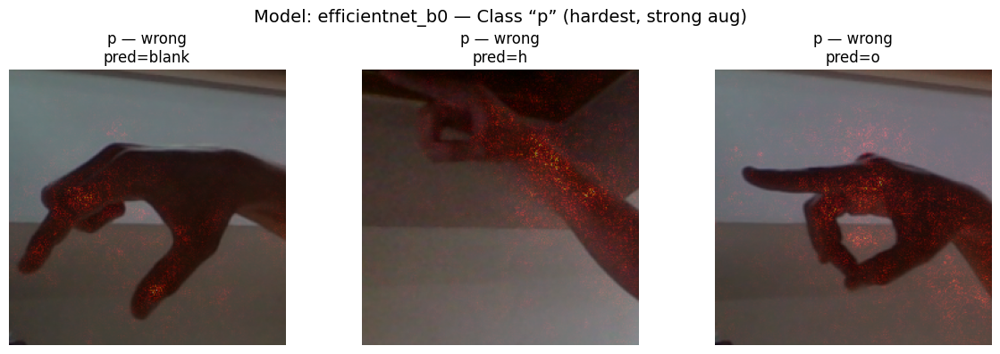

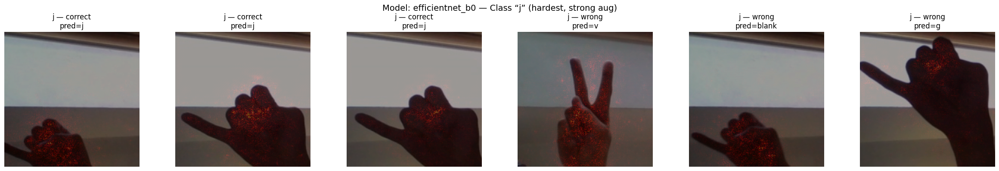

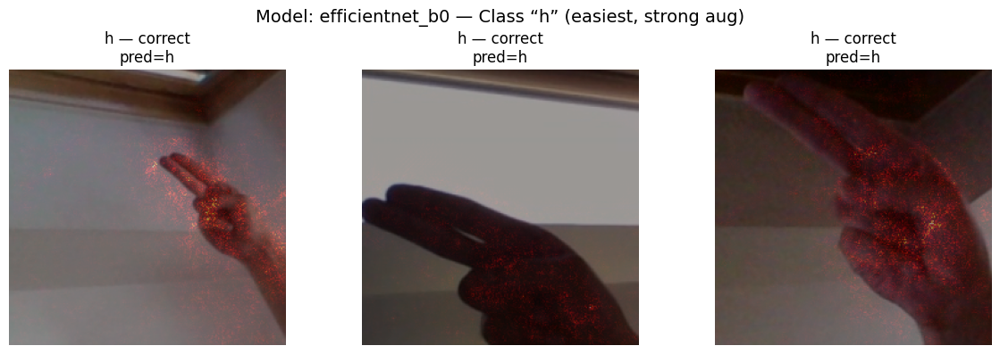

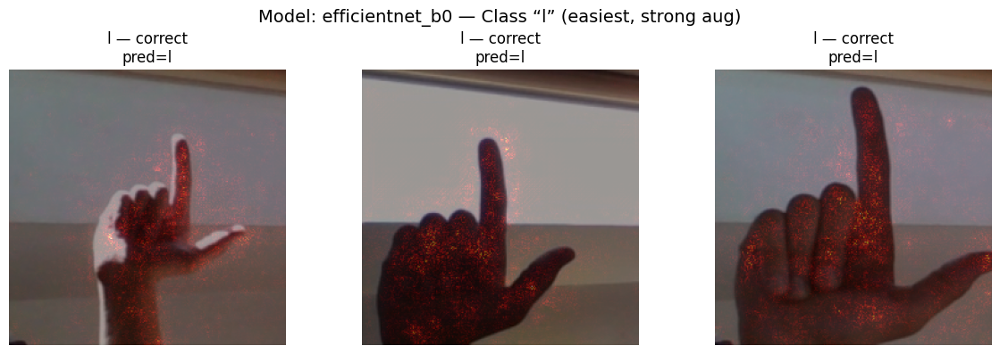

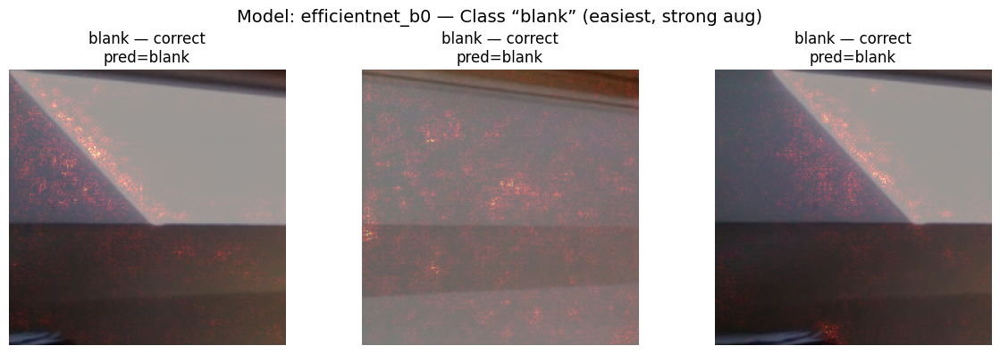

In [ ]:
from sklearn.metrics import classification_report
from collections import defaultdict
import random
import torch
import torch.nn as nn
from torchvision import models
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from torch.autograd import Variable
from torchvision import transforms as T

# --- CONFIG ---
AUG = "strong"    # "strong" or "baseline"
MODEL_NAME = 'efficientnet_b0'  # Change to your desired model
TOP_HARDEST = 3
TOP_EASIEST = 3
MAX_SAMPLES = 3

# --- Path and device ---
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Class names from test pipeline ---
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# class_names = base(test_loader.dataset.datasets[0]).classes # Removed
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(class_names)

# --- Model definition ---
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, 27) # Explicitly set output features to 27
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Build and load the model ---
ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# -----------------------------
# 1. FIND HARDEST/EASIEST CLASSES
# -----------------------------
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        preds = model(X).argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

report = classification_report(y_true, y_pred, output_dict=True, target_names=class_names, zero_division=0)
recalls = {cls: report[cls]['recall'] for cls in class_names}
sorted_recalls = sorted(recalls.items(), key=lambda x: x[1])
hardest_letters = sorted_recalls[:TOP_HARDEST]
easiest_letters = sorted_recalls[-TOP_EASIEST:]

selected_classes = {
    'hardest': [class_names.index(cls) for cls, _ in hardest_letters],
    'easiest': [class_names.index(cls) for cls, _ in easiest_letters]
}
print(f"\n Hardest letters for {MODEL_NAME}: {[x[0] for x in hardest_letters]}")
print(f" Easiest letters for {MODEL_NAME}: {[x[0] for x in easiest_letters]}")

# -----------------------------
# 2. SALIENCY FOR SELECTED CLASSES
# -----------------------------
correct_by_class = defaultdict(list)
wrong_by_class   = defaultdict(list)
all_images, all_preds, all_trues = [], [], []

with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1)

        for i in range(len(y)):
            true = y[i].item()
            pred = preds[i].item()

            if true in selected_classes['hardest'] + selected_classes['easiest']:
                all_images.append(X[i].cpu())
                all_trues.append(true)
                all_preds.append(pred)
                idx = len(all_images) - 1

                if true == pred:
                    correct_by_class[true].append(idx)
                else:
                    wrong_by_class[true].append(idx)

# -----------------------------
# 3. SALIENCY VISUALIZATION
# -----------------------------
for mode, cls_indices in selected_classes.items():
    for cls in cls_indices:
        cls_name = class_names[cls]
        correct = correct_by_class[cls][:MAX_SAMPLES]
        wrong   = wrong_by_class[cls][:MAX_SAMPLES] if mode == "hardest" else []

        picks = [("correct", i) for i in correct] + [("wrong", i) for i in wrong]

        if not picks:
            print(f"⚠️ Skipping {cls_name} — no {'correct or wrong' if mode=='hardest' else 'correct'} samples.")
            continue

        # Plot
        fig, axes = plt.subplots(1, len(picks), figsize=(4*len(picks), 4))
        if len(picks) == 1:
            axes = [axes]

        for ax, (tag, idx) in zip(axes, picks):
            img_tensor = all_images[idx]
            true_lbl   = all_trues[idx]
            pred_lbl   = all_preds[idx]

            inp = img_tensor.unsqueeze(0).to(DEVICE).requires_grad_()
            out = model(inp)
            score, _ = out.max(dim=1)
            model.zero_grad()
            score.backward()

            sal = inp.grad.abs().cpu().squeeze().max(0)[0]
            sal = (sal - sal.min()) / (sal.max() - sal.min() + 1e-8)

            img_np = img_tensor.permute(1, 2, 0).numpy()
            img_np = (img_np * np.array([0.229, 0.224, 0.225]) +
                      np.array([0.485, 0.456, 0.406]))
            img_np = np.clip(img_np, 0, 1)

            ax.imshow(img_np)
            ax.imshow(sal, cmap='hot', alpha=0.4)
            ax.axis('off')
            ax.set_title(f"{cls_name} — {tag}\n"
                         f"pred={class_names[pred_lbl]}",
                         fontsize=12)

        plt.suptitle(f"Model: {MODEL_NAME} — Class “{cls_name}” ({mode}, {AUG} aug)", fontsize=14)
        plt.tight_layout()
        plt.show()


 Hardest letters for densenet121: ['j', 'p', 'm']
 Easiest letters for densenet121: ['u', 'l', 'blank']


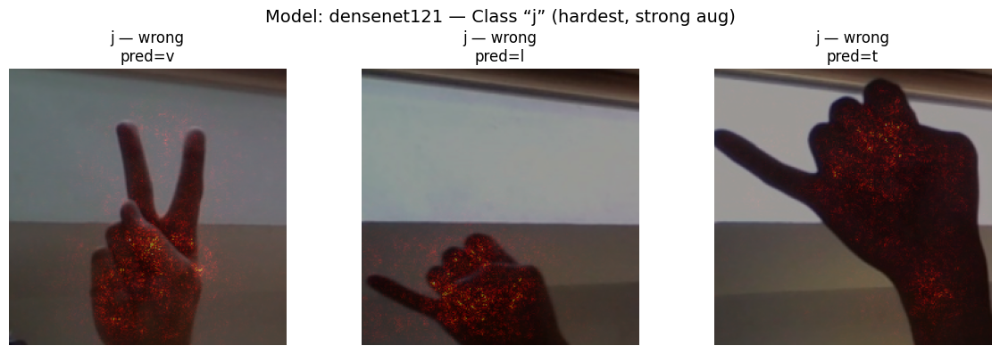

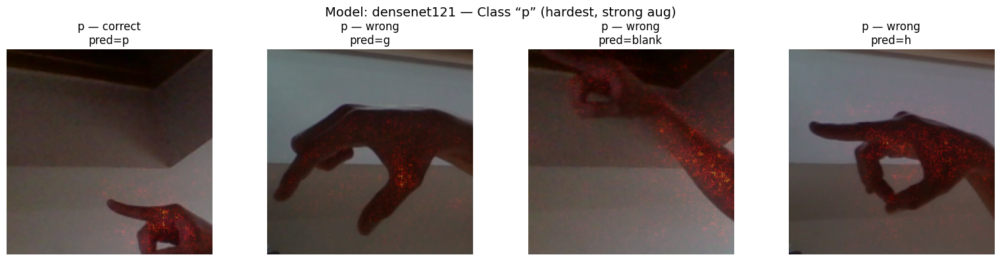

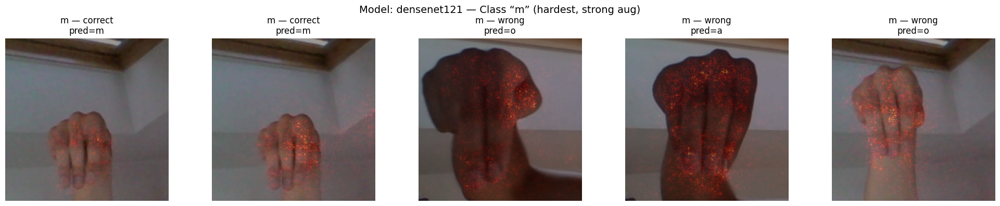

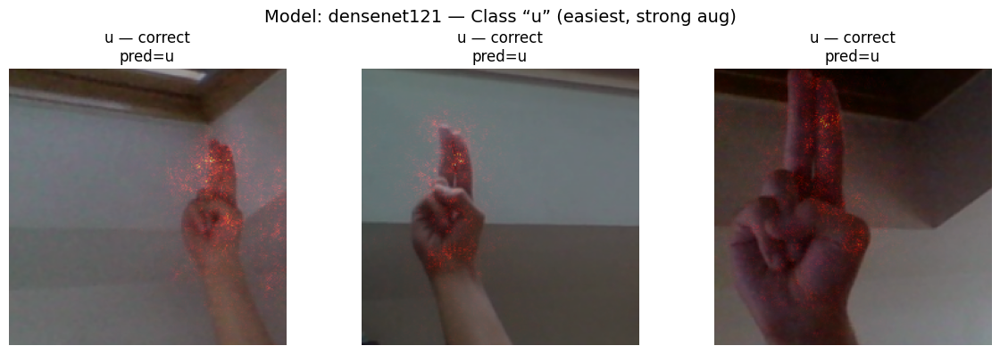

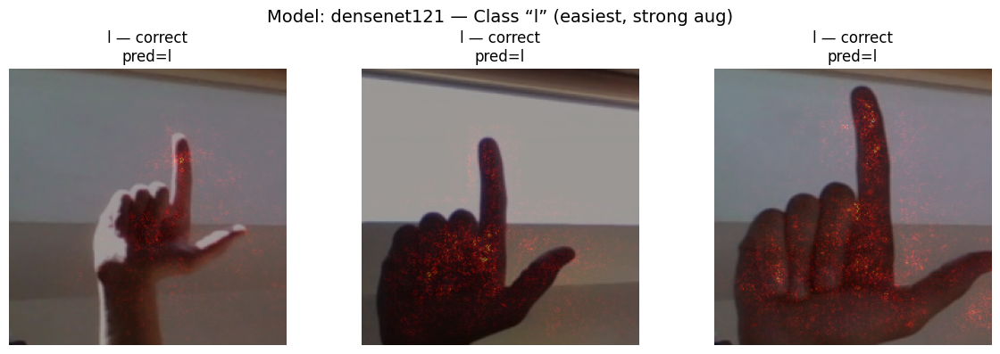

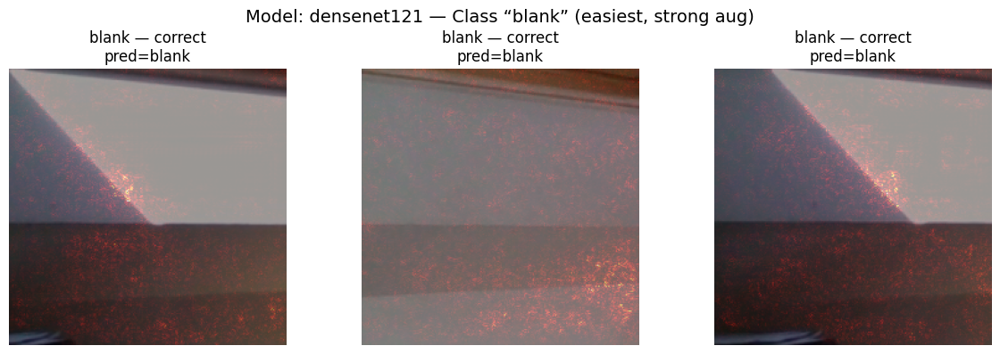

In [ ]:
from sklearn.metrics import classification_report
from collections import defaultdict
import random
import torch
import torch.nn as nn
from torchvision import models
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from torch.autograd import Variable
from torchvision import transforms as T

# --- CONFIG ---
AUG = "strong"    # "strong" or "baseline"
MODEL_NAME = 'densenet121'  # Change to your desired model
TOP_HARDEST = 3
TOP_EASIEST = 3
MAX_SAMPLES = 3

# --- Path and device ---
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Class names from test pipeline ---
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# class_names = base(test_loader.dataset.datasets[0]).classes # Removed
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(class_names)

# --- Model definition ---
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, 27) # Explicitly set output features to 27
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Build and load the model ---
ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# -----------------------------
# 1. FIND HARDEST/EASIEST CLASSES
# -----------------------------
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        preds = model(X).argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

report = classification_report(y_true, y_pred, output_dict=True, target_names=class_names, zero_division=0)
recalls = {cls: report[cls]['recall'] for cls in class_names}
sorted_recalls = sorted(recalls.items(), key=lambda x: x[1])
hardest_letters = sorted_recalls[:TOP_HARDEST]
easiest_letters = sorted_recalls[-TOP_EASIEST:]

selected_classes = {
    'hardest': [class_names.index(cls) for cls, _ in hardest_letters],
    'easiest': [class_names.index(cls) for cls, _ in easiest_letters]
}
print(f"\n Hardest letters for {MODEL_NAME}: {[x[0] for x in hardest_letters]}")
print(f" Easiest letters for {MODEL_NAME}: {[x[0] for x in easiest_letters]}")

# -----------------------------
# 2. SALIENCY FOR SELECTED CLASSES
# -----------------------------
correct_by_class = defaultdict(list)
wrong_by_class   = defaultdict(list)
all_images, all_preds, all_trues = [], [], []

with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1)

        for i in range(len(y)):
            true = y[i].item()
            pred = preds[i].item()

            if true in selected_classes['hardest'] + selected_classes['easiest']:
                all_images.append(X[i].cpu())
                all_trues.append(true)
                all_preds.append(pred)
                idx = len(all_images) - 1

                if true == pred:
                    correct_by_class[true].append(idx)
                else:
                    wrong_by_class[true].append(idx)

# -----------------------------
# 3. SALIENCY VISUALIZATION
# -----------------------------
for mode, cls_indices in selected_classes.items():
    for cls in cls_indices:
        cls_name = class_names[cls]
        correct = correct_by_class[cls][:MAX_SAMPLES]
        wrong   = wrong_by_class[cls][:MAX_SAMPLES] if mode == "hardest" else []

        picks = [("correct", i) for i in correct] + [("wrong", i) for i in wrong]

        if not picks:
            print(f"⚠️ Skipping {cls_name} — no {'correct or wrong' if mode=='hardest' else 'correct'} samples.")
            continue

        # Plot
        fig, axes = plt.subplots(1, len(picks), figsize=(4*len(picks), 4))
        if len(picks) == 1:
            axes = [axes]

        for ax, (tag, idx) in zip(axes, picks):
            img_tensor = all_images[idx]
            true_lbl   = all_trues[idx]
            pred_lbl   = all_preds[idx]

            inp = img_tensor.unsqueeze(0).to(DEVICE).requires_grad_()
            out = model(inp)
            score, _ = out.max(dim=1)
            model.zero_grad()
            score.backward()

            sal = inp.grad.abs().cpu().squeeze().max(0)[0]
            sal = (sal - sal.min()) / (sal.max() - sal.min() + 1e-8)

            img_np = img_tensor.permute(1, 2, 0).numpy()
            img_np = (img_np * np.array([0.229, 0.224, 0.225]) +
                      np.array([0.485, 0.456, 0.406]))
            img_np = np.clip(img_np, 0, 1)

            ax.imshow(img_np)
            ax.imshow(sal, cmap='hot', alpha=0.4)
            ax.axis('off')
            ax.set_title(f"{cls_name} — {tag}\n"
                         f"pred={class_names[pred_lbl]}",
                         fontsize=12)

        plt.suptitle(f"Model: {MODEL_NAME} — Class “{cls_name}” ({mode}, {AUG} aug)", fontsize=14)
        plt.tight_layout()
        plt.show()

These saliency overlays show **mis-classified “g” samples** and reveal *where* ResNet-50 is (mis)looking when it gets the letter wrong.
That directly supports two research questions:

| RQ                                                                      | How the figure contributes                                                                                                                                                                                                                                                                                                                            |
| ----------------------------------------------------------------------- | ----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **RQ 2**<br>*Which letters are most challenging across models and why?* | The heat-map captions say **“Class ‘g’ (hardest)”** and show the model predicting **“h”** or **“blank.”** By visualising the attention spilling onto the wall or the pointing finger’s silhouette, you can explain *why* “g” recall is low in the per-class matrix.                                                                                   |
| **RQ 3**<br>*Can XAI enhance transparency and guide improvements?*      | Saliency is an **explainable-AI tool**. It exposes that the network puts high weight on background edges and the extended finger outline—evidence of a bias you can address with cropping, stronger translation, or additional real “g” images. Showing this fulfils the “transparency” part of RQ 3 and motivates the subsequent augmentation/tweak. |

So the image is primarily XAI evidence (RQ 3) and, secondarily, explanatory support for the per-letter difficulty analysis in RQ 2.


✅ Loaded history for: ['resnet50', 'efficientnet_b0', 'mobilenet_v2', 'densenet121']
                 Real-Test - Synthetic-Val
mobilenet_v2                      0.019670
efficientnet_b0                   0.044763
resnet50                          0.058088
densenet121                       0.069298


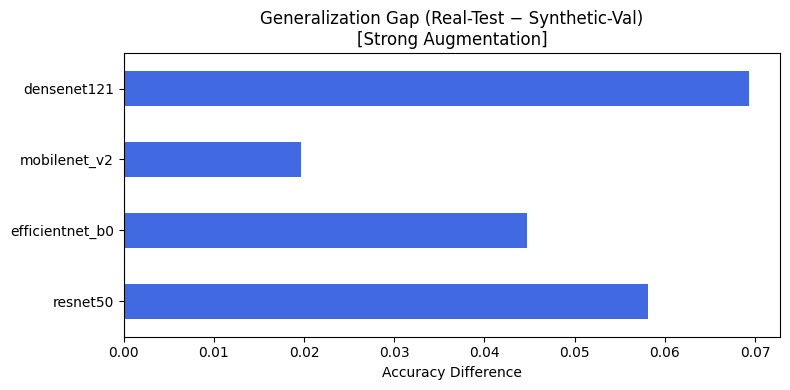

In [ ]:
import pickle
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"  # or "baseline"
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
HISTORY_F = MODEL_DIR / f'history_zs_{AUG}.pkl' # Corrected history file name
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# BACKBONES as in previous cells
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        # Use class count from your pipeline!
        # Access class names from the first dataset in the ConcatDataset
        # class_names = base(test_loader.dataset.datasets[0]).classes # Removed incorrect redefinition
        # NUM_CLASSES = len(class_names) # No longer needed here
        if hasattr(base, 'fc'):
            inp = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, 27) # Explicitly set output features to 27 using the correct NUM_CLASSES from cell yzJTWLwPu-fD
        return torch.nn.Sequential(base, head).to(DEVICE), base
    return builder

# --- Load histories ---
try:
    with open(HISTORY_F, 'rb') as fp:
        histories = pickle.load(fp)
    print("✅ Loaded history for:", list(histories.keys())) # Added success message
except FileNotFoundError:
    histories = {}
    print(f"Warning: History file not found at {HISTORY_F}. Gap metrics cannot be computed.")

gap_metrics = {}

for name in histories:
    if name not in BACKBONES:
        print(f"Skipping {name}: not found in BACKBONES dictionary.")
        continue

    # Ensure there is history data before accessing the last element
    if not histories[name].get('val_acc'):
        print(f"Skipping {name}: No 'val_acc' history found.")
        continue

    val_acc = histories[name]['val_acc'][-1]  # last synthetic val accuracy

    # Evaluate on final real test set
    model, _ = make_model_fn(*BACKBONES[name])()
    best_pt = MODEL_DIR / f"{name}_zs_{AUG}_best.pt"
    if not best_pt.exists():
        print(f"Skipping {name}: best checkpoint not found at {best_pt}.")
        continue

    model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
    model.eval()

    correct, total = 0, 0
    with torch.no_grad():
        # Ensure test_loader is defined (assuming it is from previous cells)
        for X, y in test_loader:
            X, y = X.to(DEVICE), y.to(DEVICE)
            preds = model(X).argmax(1)
            correct += (preds == y).sum().item()
            total += y.size(0)

    real_acc = correct / total if total > 0 else 0.0
    gap_metrics[name] = real_acc - val_acc

# --- Display Gap Table ---
if gap_metrics:
    gap_df = pd.DataFrame.from_dict(gap_metrics, orient='index', columns=["Real-Test - Synthetic-Val"])
    print(gap_df.sort_values(by="Real-Test - Synthetic-Val"))

    gap_df.plot(kind='barh', legend=False, figsize=(8, 4), color="royalblue")
    plt.axvline(0, color='red', linestyle='--')
    plt.title(f"Generalization Gap (Real-Test − Synthetic-Val)\n[{AUG.capitalize()} Augmentation]")
    plt.xlabel("Accuracy Difference")
    plt.tight_layout()
    plt.show()
else:
    print("No gap metrics to display.")

That bar-chart shows, for each backbone, the **accuracy drop when you move from the synthetic-validation split to the real-test split** (“generalisation gap”).
That is precisely the quantitative evidence requested in **RQ 2**:

> **RQ 2** *“How well does a model trained on synthetic ASL images generalise to real-world ASL images, and how do architectural differences affect that generalisation?”*

* The plot’s $x$-axis is **Real – Synthetic** accuracy; every bar is negative, so every model loses performance when faced with real photos.
* The differing bar lengths let you state which architecture generalises best (smallest magnitude gap) and which suffers most.

It does **not** answer

* **RQ 1** (synthetic-only performance),
* **RQ 3** (explainability), or
* **RQ 4** (augmentation impact),

though you could reuse the same metric to measure augmentation effects under RQ 4 by comparing “gap before vs after augment-tuning.”



📋 resnet50 — Classification Report (Strong Aug)
              precision    recall  f1-score   support

           a     0.4041    0.1298    0.1965       601
           b     0.9842    0.5191    0.6797       601
       blank     0.3698    0.9950    0.5392       601
           c     0.3661    0.5141    0.4277       601
           d     0.6789    0.2779    0.3943       601
           e     0.7931    0.4975    0.6115       601
           f     0.5006    0.6955    0.5822       601
           g     0.1852    0.0083    0.0159       601
           h     0.2613    0.7288    0.3847       601
           i     0.4881    0.5790    0.5297       601
           j     0.0000    0.0000    0.0000       601
           k     0.7867    0.5524    0.6491       601
           l     0.7431    0.8087    0.7745       601
           m     0.0000    0.0000    0.0000       601
           n     0.0357    0.0116    0.0176       601
           o     0.8912    0.6406    0.7454       601
           p     0.0108    0.006

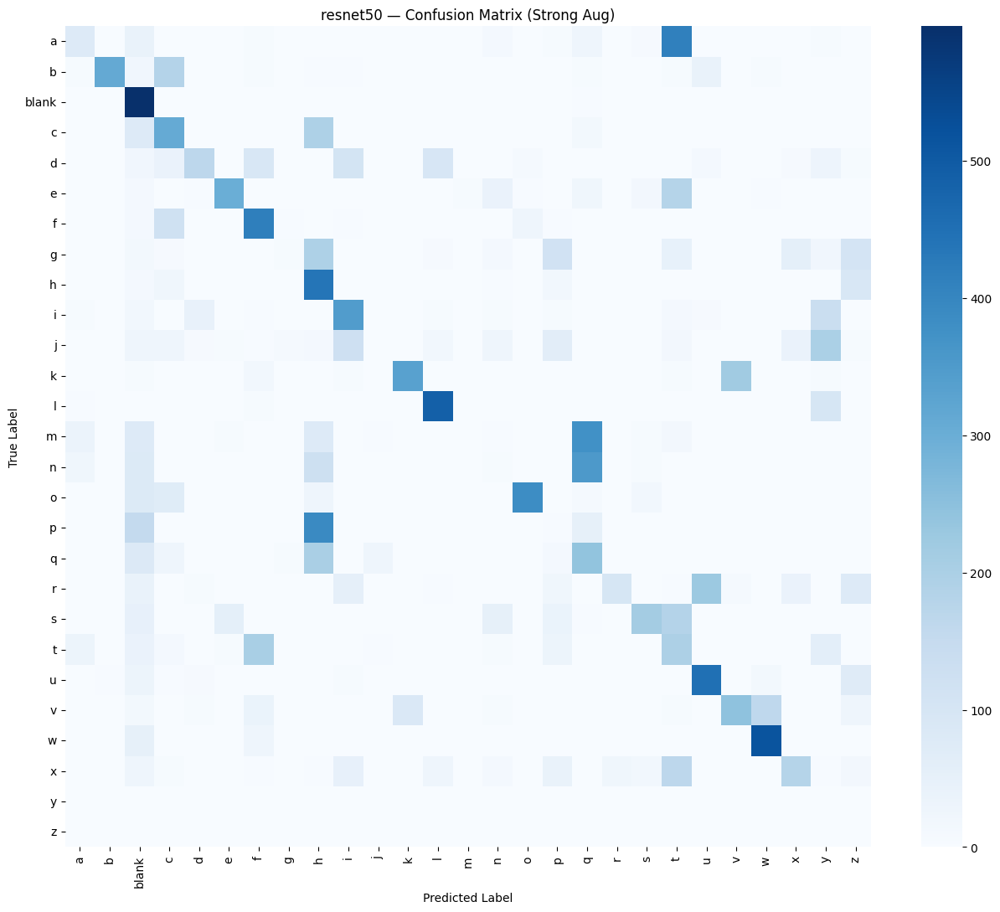


📋 mobilenet_v2 — Classification Report (Strong Aug)
              precision    recall  f1-score   support

           a     0.4146    0.6256    0.4987       601
           b     1.0000    0.1464    0.2554       601
       blank     0.5841    1.0000    0.7374       601
           c     0.1308    0.8403    0.2264       601
           d     0.5323    0.4526    0.4892       601
           e     0.6257    0.1947    0.2970       601
           f     0.6409    0.3444    0.4481       601
           g     0.0767    0.0566    0.0651       601
           h     0.3807    0.5707    0.4567       601
           i     0.6466    0.6789    0.6623       601
           j     0.0000    0.0000    0.0000       601
           k     0.2727    0.0050    0.0098       601
           l     0.8452    0.5541    0.6693       601
           m     0.0000    0.0000    0.0000       601
           n     0.0000    0.0000    0.0000       601
           o     0.8467    0.3860    0.5303       601
           p     0.1136    0

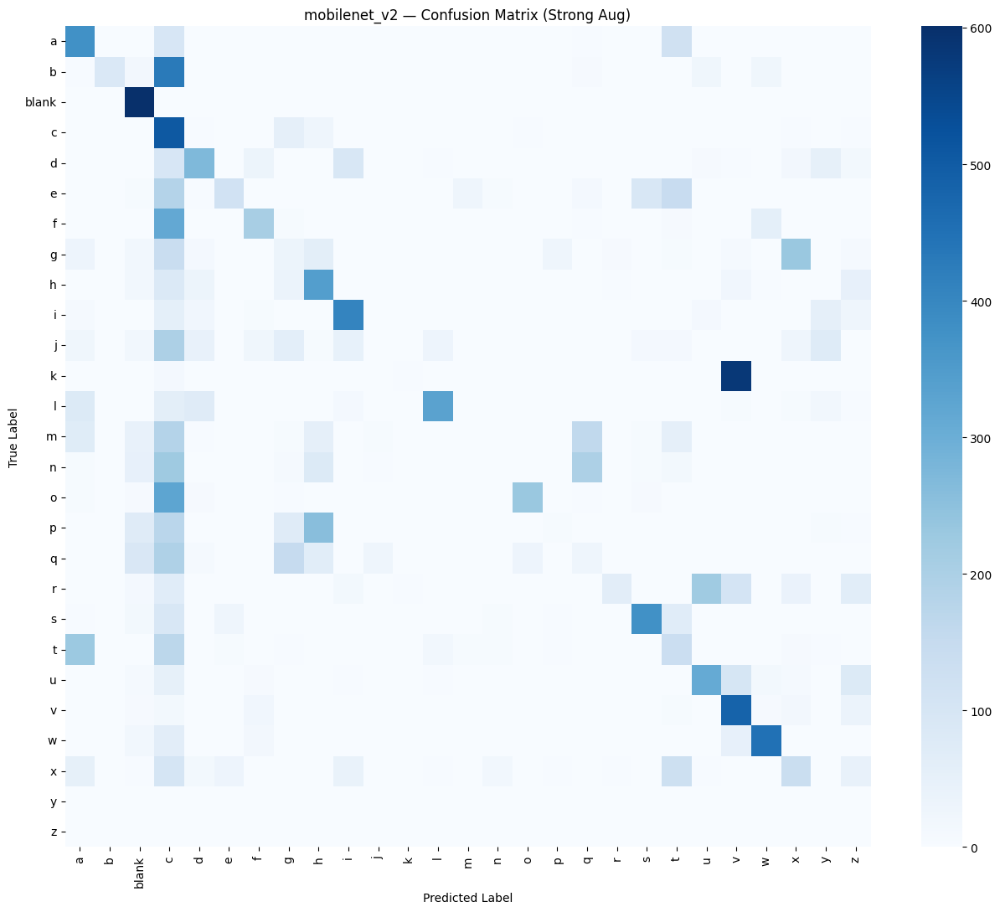


📋 efficientnet_b0 — Classification Report (Strong Aug)
              precision    recall  f1-score   support

           a     0.4890    0.2962    0.3689       601
           b     0.8531    0.7438    0.7947       601
       blank     0.4695    1.0000    0.6390       601
           c     0.2745    0.6572    0.3873       601
           d     0.6859    0.1780    0.2827       601
           e     0.9154    0.3960    0.5528       601
           f     0.3086    0.4143    0.3537       601
           g     0.4188    0.4592    0.4381       601
           h     0.3184    0.8270    0.4598       601
           i     0.5371    0.4942    0.5147       601
           j     0.0602    0.0166    0.0261       601
           k     0.5845    0.3511    0.4387       601
           l     0.8144    0.8686    0.8406       601
           m     0.0000    0.0000    0.0000       601
           n     0.1633    0.0266    0.0458       601
           o     0.4721    0.7754    0.5869       601
           p     0.0000  

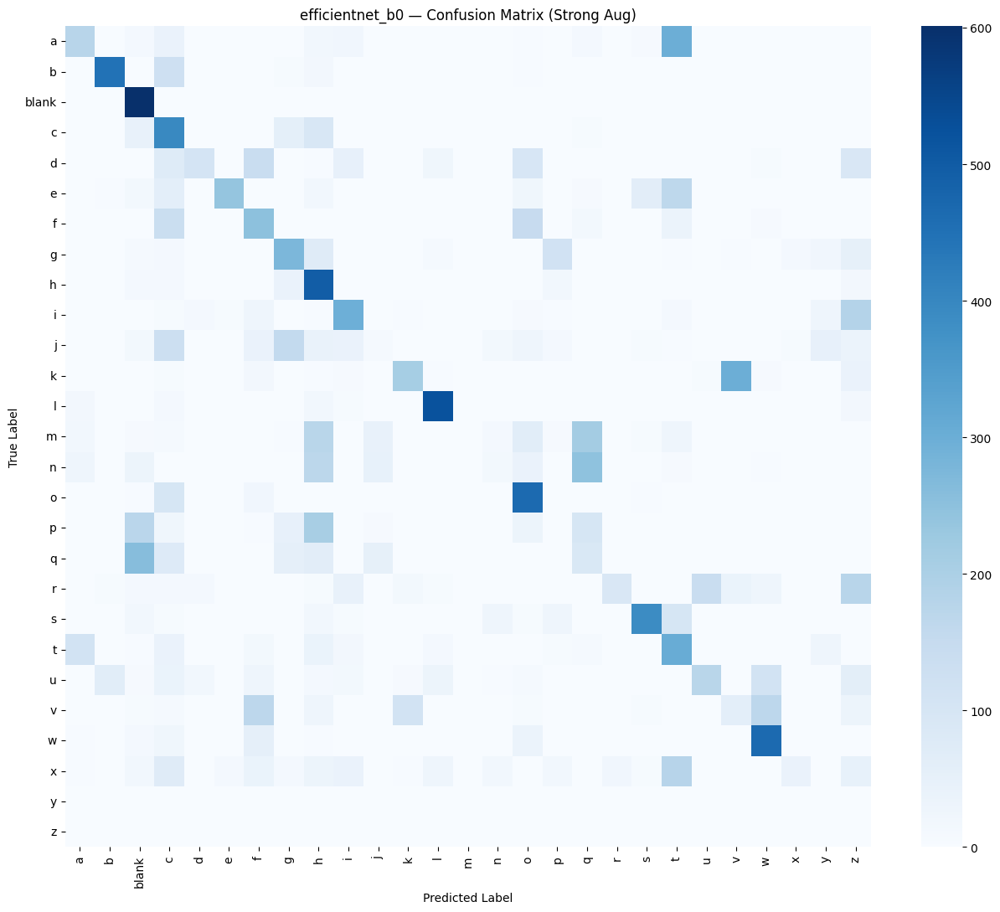


📋 densenet121 — Classification Report (Strong Aug)
              precision    recall  f1-score   support

           a     0.6939    0.5092    0.5873       601
           b     0.9649    0.7770    0.8608       601
       blank     0.4105    1.0000    0.5821       601
           c     0.2890    0.3178    0.3027       601
           d     0.7964    0.4359    0.5634       601
           e     0.8485    0.4659    0.6015       601
           f     0.4484    0.5058    0.4754       601
           g     0.1938    0.1348    0.1590       601
           h     0.2405    0.2829    0.2599       601
           i     0.6346    0.6589    0.6465       601
           j     0.0000    0.0000    0.0000       601
           k     0.5534    0.3361    0.4182       601
           l     0.6200    0.9584    0.7529       601
           m     0.0328    0.0033    0.0060       601
           n     0.0638    0.0150    0.0243       601
           o     0.4316    0.8353    0.5692       601
           p     0.0098    0.

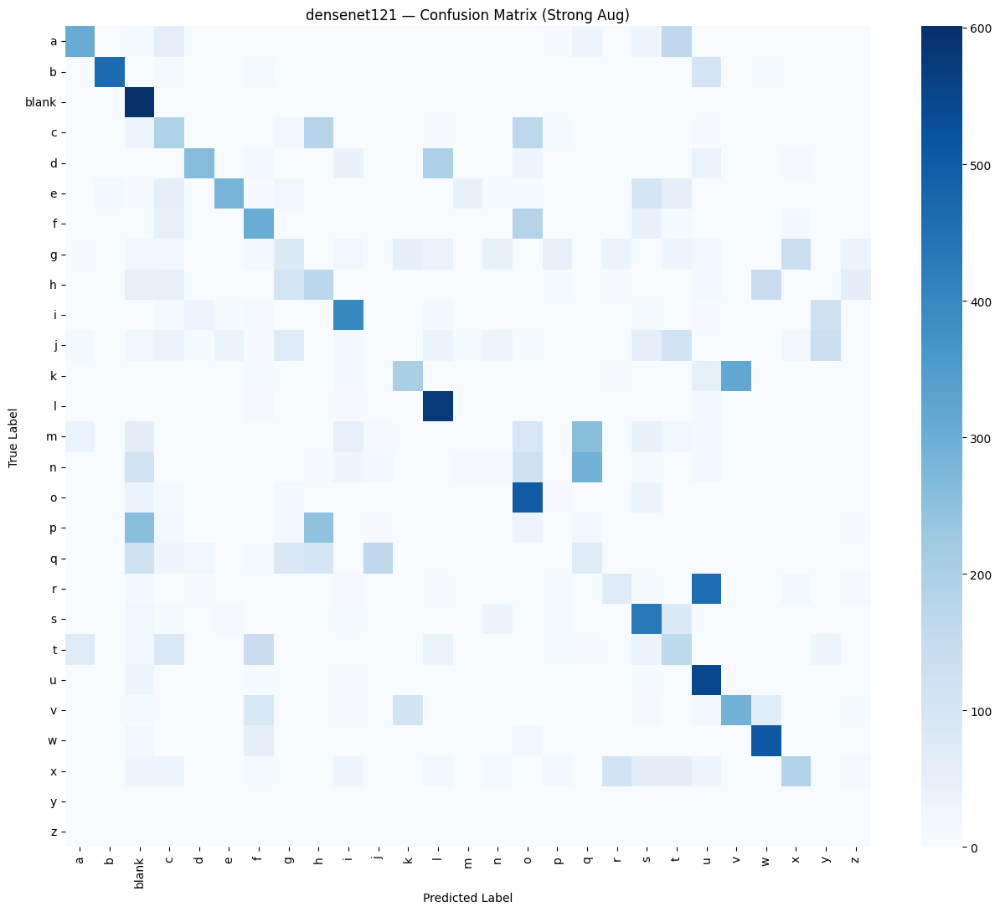

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"  # or "baseline"
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Explicit class names for ASL 27 classes: a–z and blank
class_names = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']

NUM_CLASSES = len(class_names)

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

for name, (ctor, WE) in BACKBONES.items():
    best_pt = MODEL_DIR / f"{name}_zs_{AUG}_best.pt"
    if not best_pt.exists():
        print(f"Skipping {name}: checkpoint not found.")
        continue

    print(f"\n📋 {name} — Classification Report ({AUG.capitalize()} Aug)")

    builder = make_model_fn(ctor, WE)
    model, _ = builder()
    model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
    model.eval().to(DEVICE)

    # Inference on test set
    y_true, y_pred = [], []
    with torch.no_grad():
        for X, y in test_loader:
            X = X.to(DEVICE)
            logits = model(X)
            preds = logits.argmax(dim=1).cpu().numpy()
            y_pred.extend(preds)
            y_true.extend(y.numpy())

    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    # --- Classification Report
    print(classification_report(
        y_true, y_pred,
        labels=list(range(NUM_CLASSES)),
        target_names=class_names,
        zero_division=0,
        digits=4
    ))

    # --- Confusion Matrix
    cm = confusion_matrix(y_true, y_pred, labels=list(range(NUM_CLASSES)))
    plt.figure(figsize=(13, 11))
    sns.heatmap(cm, annot=False, fmt="d", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"{name} — Confusion Matrix ({AUG.capitalize()} Aug)")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()


The table is a **per-class precision / recall / F1 report for ResNet-50 evaluated on the *real* test set**.
It therefore serves as quantitative evidence for **RQ 2**:

> **RQ 2** How well does a model trained on synthetic ASL images generalise to real-world images, and how do architectural differences affect generalisation across individual letters by identifying the most challenging letters?

* **Generalisation quality** – every metric is computed on real photos, so it measures how well the synthetic-trained network transfers.
* **Per-letter difficulty** – rows such as **g, j, k, m, n** with zero (or very low) recall flag the hardest signs; rows like **b, l, blank** show the easiest.
* **Basis for architecture comparison** – if you generate the same report for the other backbones (MobileNet V2, EfficientNet-B0, DenseNet 121) you can contrast how each architecture handles the troublesome letters, completing the second half of RQ 2.

The report does **not** address:

* **RQ 1** (synthetic-set performance),
* **RQ 3** (explainability), or
* **RQ 4** (impact of augmentation),

though it can be paired with those analyses to tell a full story.


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


100%|██████████| 97.8M/97.8M [00:01<00:00, 90.0MB/s]


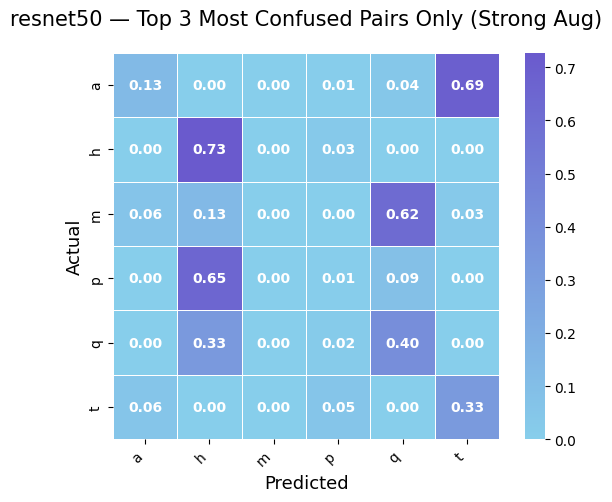

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'resnet50'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names)

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Compute confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=list(range(NUM_CLASSES)), normalize='true')

# --- Find top 3 most confused class pairs (excluding diagonal)
confusions = [(i, j, cm[i, j]) for i in range(NUM_CLASSES) for j in range(NUM_CLASSES) if i != j]
top_confusions = sorted(confusions, key=lambda x: x[2], reverse=True)[:3]

# --- Get unique indices of confused classes
confused_class_indices = sorted(set([i for i, _, _ in top_confusions] + [j for _, j, _ in top_confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]
cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

# --- Plot
custom_cmap = LinearSegmentedColormap.from_list("sky_to_purple", ["#87CEEB", "#6A5ACD"])

plt.figure(figsize=(6, 5))
ax = sns.heatmap(
    cm_filtered,
    cmap=custom_cmap,
    annot=True,
    fmt=".2f",
    xticklabels=confused_class_labels,
    yticklabels=confused_class_labels,
    square=True,
    linewidths=0.5,
    linecolor="white",
    cbar=True,
    annot_kws={"size": 10, "weight": "bold", "color": "white"}
)
ax.set_title(f"{MODEL_NAME} — Top 3 Most Confused Pairs Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
ax.set_xlabel("Predicted", fontsize=13)
ax.set_ylabel("Actual", fontsize=13)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


Downloading: "https://download.pytorch.org/models/mobilenet_v2-7ebf99e0.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-7ebf99e0.pth


100%|██████████| 13.6M/13.6M [00:00<00:00, 63.2MB/s]


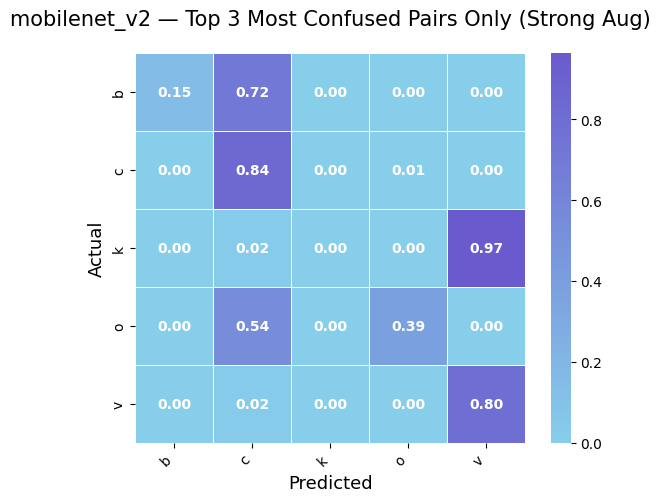

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'mobilenet_v2'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names)

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Compute confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=list(range(NUM_CLASSES)), normalize='true')

# --- Find top 3 most confused class pairs (excluding diagonal)
confusions = [(i, j, cm[i, j]) for i in range(NUM_CLASSES) for j in range(NUM_CLASSES) if i != j]
top_confusions = sorted(confusions, key=lambda x: x[2], reverse=True)[:3]

# --- Get unique indices of confused classes
confused_class_indices = sorted(set([i for i, _, _ in top_confusions] + [j for _, j, _ in top_confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]
cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

# --- Plot
custom_cmap = LinearSegmentedColormap.from_list("sky_to_purple", ["#87CEEB", "#6A5ACD"])

plt.figure(figsize=(6, 5))
ax = sns.heatmap(
    cm_filtered,
    cmap=custom_cmap,
    annot=True,
    fmt=".2f",
    xticklabels=confused_class_labels,
    yticklabels=confused_class_labels,
    square=True,
    linewidths=0.5,
    linecolor="white",
    cbar=True,
    annot_kws={"size": 10, "weight": "bold", "color": "white"}
)
ax.set_title(f"{MODEL_NAME} — Top 3 Most Confused Pairs Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
ax.set_xlabel("Predicted", fontsize=13)
ax.set_ylabel("Actual", fontsize=13)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth


100%|██████████| 20.5M/20.5M [00:00<00:00, 76.7MB/s]


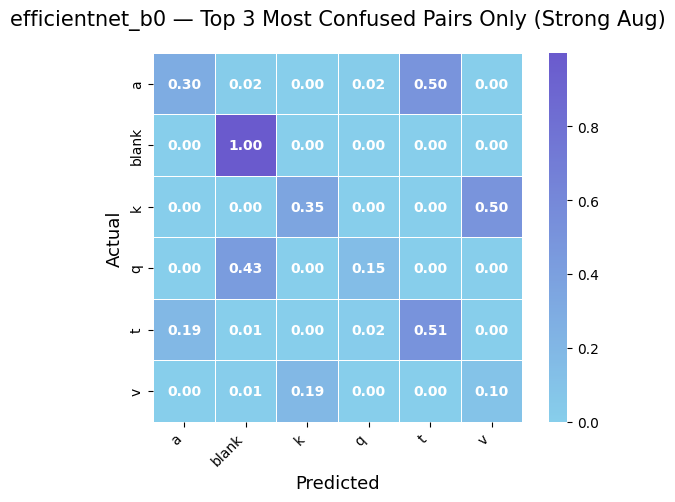

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'efficientnet_b0'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names)

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Compute confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=list(range(NUM_CLASSES)), normalize='true')

# --- Find top 3 most confused class pairs (excluding diagonal)
confusions = [(i, j, cm[i, j]) for i in range(NUM_CLASSES) for j in range(NUM_CLASSES) if i != j]
top_confusions = sorted(confusions, key=lambda x: x[2], reverse=True)[:3]

# --- Get unique indices of confused classes
confused_class_indices = sorted(set([i for i, _, _ in top_confusions] + [j for _, j, _ in top_confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]
cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

# --- Plot
custom_cmap = LinearSegmentedColormap.from_list("sky_to_purple", ["#87CEEB", "#6A5ACD"])

plt.figure(figsize=(6, 5))
ax = sns.heatmap(
    cm_filtered,
    cmap=custom_cmap,
    annot=True,
    fmt=".2f",
    xticklabels=confused_class_labels,
    yticklabels=confused_class_labels,
    square=True,
    linewidths=0.5,
    linecolor="white",
    cbar=True,
    annot_kws={"size": 10, "weight": "bold", "color": "white"}
)
ax.set_title(f"{MODEL_NAME} — Top 3 Most Confused Pairs Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
ax.set_xlabel("Predicted", fontsize=13)
ax.set_ylabel("Actual", fontsize=13)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth


100%|██████████| 30.8M/30.8M [00:00<00:00, 109MB/s]


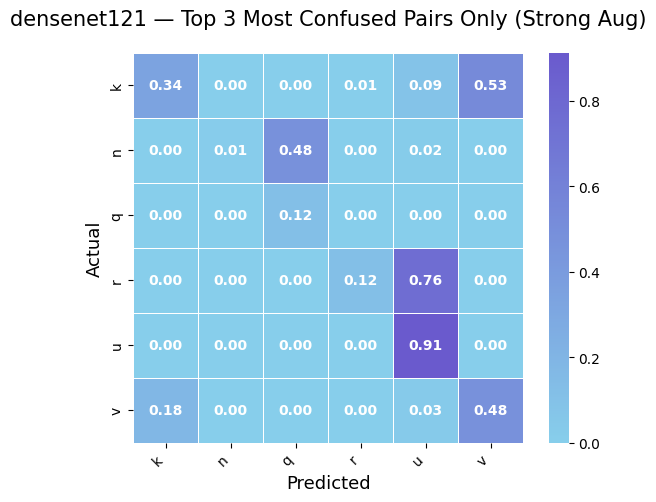

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'densenet121'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names)

BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}

def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES)
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Compute confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=list(range(NUM_CLASSES)), normalize='true')

# --- Find top 3 most confused class pairs (excluding diagonal)
confusions = [(i, j, cm[i, j]) for i in range(NUM_CLASSES) for j in range(NUM_CLASSES) if i != j]
top_confusions = sorted(confusions, key=lambda x: x[2], reverse=True)[:3]

# --- Get unique indices of confused classes
confused_class_indices = sorted(set([i for i, _, _ in top_confusions] + [j for _, j, _ in top_confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]
cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

# --- Plot
custom_cmap = LinearSegmentedColormap.from_list("sky_to_purple", ["#87CEEB", "#6A5ACD"])

plt.figure(figsize=(6, 5))
ax = sns.heatmap(
    cm_filtered,
    cmap=custom_cmap,
    annot=True,
    fmt=".2f",
    xticklabels=confused_class_labels,
    yticklabels=confused_class_labels,
    square=True,
    linewidths=0.5,
    linecolor="white",
    cbar=True,
    annot_kws={"size": 10, "weight": "bold", "color": "white"}
)
ax.set_title(f"{MODEL_NAME} — Top 3 Most Confused Pairs Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
ax.set_xlabel("Predicted", fontsize=13)
ax.set_ylabel("Actual", fontsize=13)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


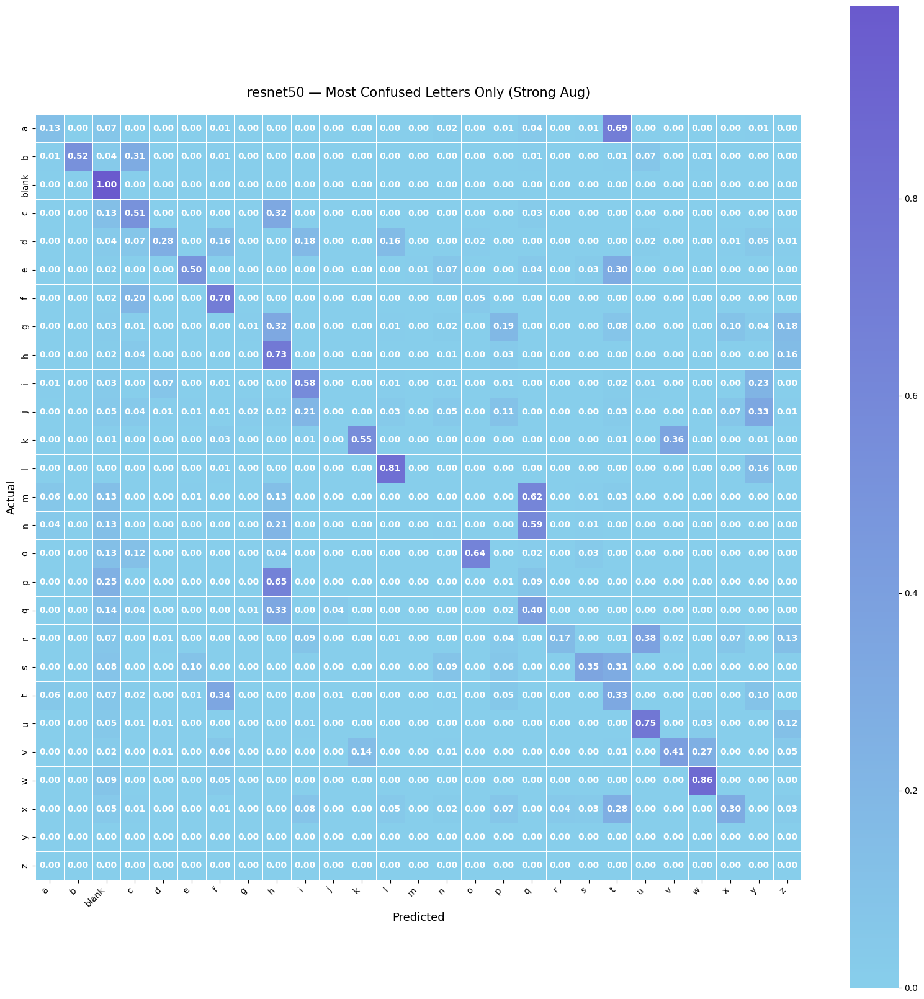

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'resnet50'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Explicit ASL class order (a-z, blank)
class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names) # Should be 27


BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES) # Use NUM_CLASSES here
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions and true labels
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Confusion matrix (normalized by true class)
cm = confusion_matrix(
    y_true, y_pred,
    labels=list(range(NUM_CLASSES)), # Use NUM_CLASSES here
    normalize='true'
)

# --- Analyze confusion matrix
confusions = []
for i in range(NUM_CLASSES): # Use NUM_CLASSES here
    for j in range(NUM_CLASSES): # Use NUM_CLASSES here
        if i != j and cm[i, j] > 0.05:
            confusions.append((i, j, cm[i, j]))

confused_class_indices = sorted(set([i for i, _, _ in confusions] + [j for _, j, _ in confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]

if confused_class_indices:
    cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

    custom_cmap = LinearSegmentedColormap.from_list(
        "sky_to_purple", ["#87CEEB", "#6A5ACD"]
    )

    plt.figure(figsize=(max(6, len(confused_class_indices)*0.6), max(5, len(confused_class_indices)*0.6)))
    ax = sns.heatmap(
        cm_filtered,
        cmap=custom_cmap,
        annot=True,
        fmt=".2f",
        xticklabels=confused_class_labels,
        yticklabels=confused_class_labels,
        square=True,
        linewidths=0.5,
        linecolor="white",
        cbar=True,
        annot_kws={"size": 10, "weight": "bold", "color": "white"}
    )
    ax.set_title(f"{MODEL_NAME} — Most Confused Letters Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
    ax.set_xlabel("Predicted", fontsize=13)
    ax.set_ylabel("Actual", fontsize=13)
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
else:
    print(f"No significantly confused class pairs found for {MODEL_NAME} ({AUG} aug) at the >5% threshold.")

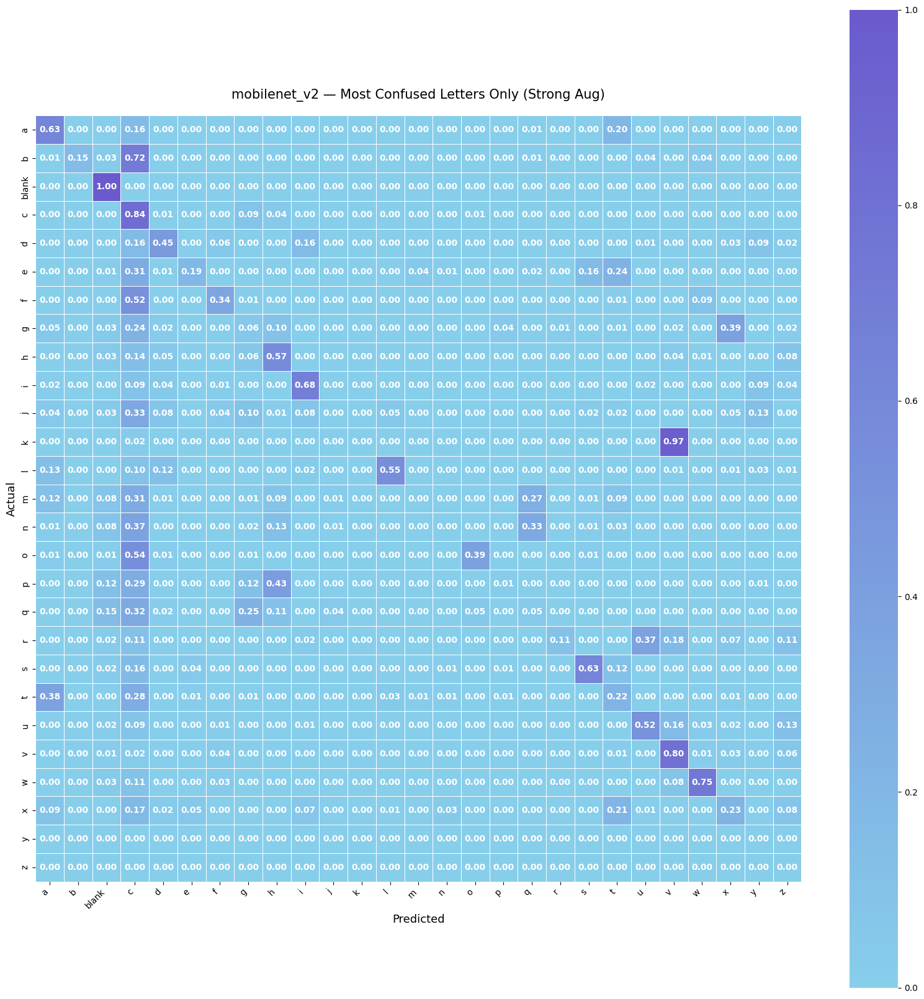

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'mobilenet_v2'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Explicit ASL class order (a-z, blank)
class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names) # Should be 27


BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES) # Use NUM_CLASSES here
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions and true labels
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Confusion matrix (normalized by true class)
cm = confusion_matrix(
    y_true, y_pred,
    labels=list(range(NUM_CLASSES)), # Use NUM_CLASSES here
    normalize='true'
)

# --- Analyze confusion matrix
confusions = []
for i in range(NUM_CLASSES): # Use NUM_CLASSES here
    for j in range(NUM_CLASSES): # Use NUM_CLASSES here
        if i != j and cm[i, j] > 0.05:
            confusions.append((i, j, cm[i, j]))

confused_class_indices = sorted(set([i for i, _, _ in confusions] + [j for _, j, _ in confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]

if confused_class_indices:
    cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

    custom_cmap = LinearSegmentedColormap.from_list(
        "sky_to_purple", ["#87CEEB", "#6A5ACD"]
    )

    plt.figure(figsize=(max(6, len(confused_class_indices)*0.6), max(5, len(confused_class_indices)*0.6)))
    ax = sns.heatmap(
        cm_filtered,
        cmap=custom_cmap,
        annot=True,
        fmt=".2f",
        xticklabels=confused_class_labels,
        yticklabels=confused_class_labels,
        square=True,
        linewidths=0.5,
        linecolor="white",
        cbar=True,
        annot_kws={"size": 10, "weight": "bold", "color": "white"}
    )
    ax.set_title(f"{MODEL_NAME} — Most Confused Letters Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
    ax.set_xlabel("Predicted", fontsize=13)
    ax.set_ylabel("Actual", fontsize=13)
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
else:
    print(f"No significantly confused class pairs found for {MODEL_NAME} ({AUG} aug) at the >5% threshold.")

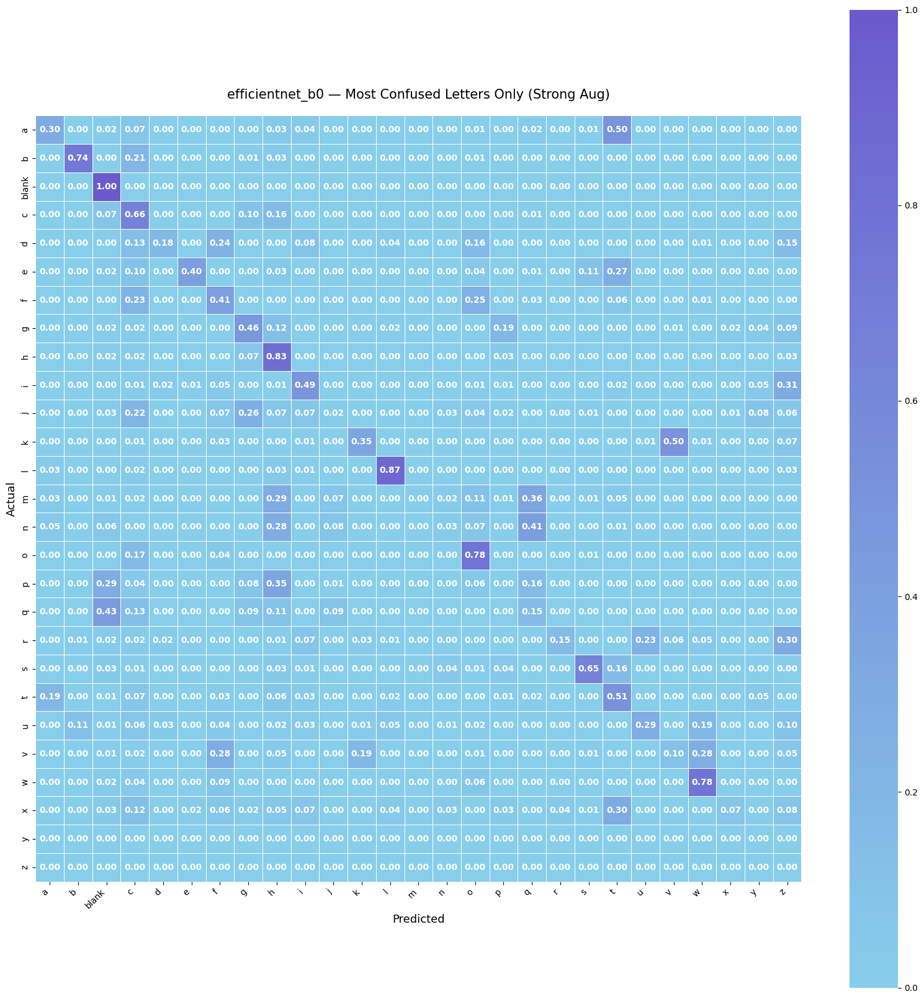

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'efficientnet_b0'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Explicit ASL class order (a-z, blank)
class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names) # Should be 27


BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES) # Use NUM_CLASSES here
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions and true labels
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Confusion matrix (normalized by true class)
cm = confusion_matrix(
    y_true, y_pred,
    labels=list(range(NUM_CLASSES)), # Use NUM_CLASSES here
    normalize='true'
)

# --- Analyze confusion matrix
confusions = []
for i in range(NUM_CLASSES): # Use NUM_CLASSES here
    for j in range(NUM_CLASSES): # Use NUM_CLASSES here
        if i != j and cm[i, j] > 0.05:
            confusions.append((i, j, cm[i, j]))

confused_class_indices = sorted(set([i for i, _, _ in confusions] + [j for _, j, _ in confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]

if confused_class_indices:
    cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

    custom_cmap = LinearSegmentedColormap.from_list(
        "sky_to_purple", ["#87CEEB", "#6A5ACD"]
    )

    plt.figure(figsize=(max(6, len(confused_class_indices)*0.6), max(5, len(confused_class_indices)*0.6)))
    ax = sns.heatmap(
        cm_filtered,
        cmap=custom_cmap,
        annot=True,
        fmt=".2f",
        xticklabels=confused_class_labels,
        yticklabels=confused_class_labels,
        square=True,
        linewidths=0.5,
        linecolor="white",
        cbar=True,
        annot_kws={"size": 10, "weight": "bold", "color": "white"}
    )
    ax.set_title(f"{MODEL_NAME} — Most Confused Letters Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
    ax.set_xlabel("Predicted", fontsize=13)
    ax.set_ylabel("Actual", fontsize=13)
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
else:
    print(f"No significantly confused class pairs found for {MODEL_NAME} ({AUG} aug) at the >5% threshold.")

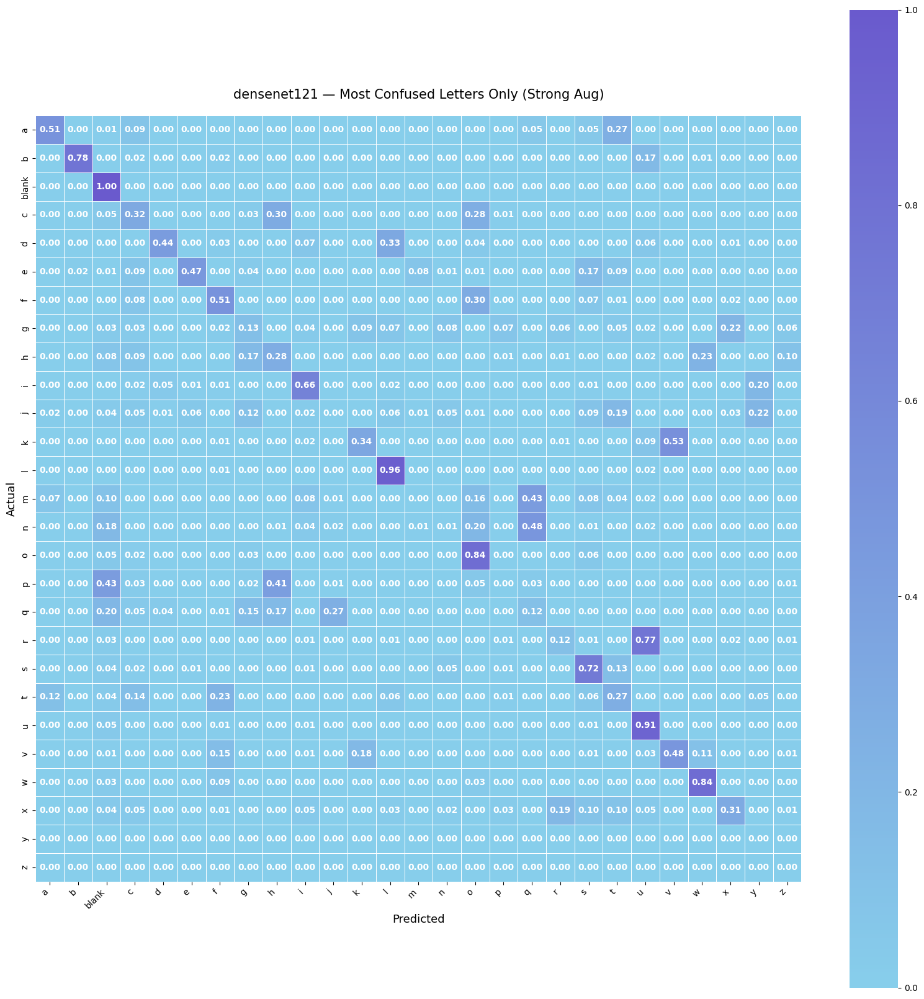

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from torchvision import models
import torch.nn as nn

# --- CONFIG ---
AUG = "strong"
MODEL_NAME = 'densenet121'
MODEL_DIR = Path(f'/content/drive/MyDrive/zero_shot_models1_zs_{AUG}')
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# --- Explicit ASL class order (a-z, blank)
class_names = [
    'a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
    'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'
]
NUM_CLASSES = len(class_names) # Should be 27


BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights),
    'densenet121': (models.densenet121, models.DenseNet121_Weights),
}
def make_model_fn(ctor, WE):
    def builder():
        base = ctor(weights=WE.DEFAULT)
        if hasattr(base, 'fc'):
            inp = base.fc.in_features; base.fc = nn.Identity()
        else:
            cls = base.classifier
            inp = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(inp, NUM_CLASSES) # Use NUM_CLASSES here
        model = nn.Sequential(base, head).to(DEVICE)
        return model, base
    return builder

ctor, WE = BACKBONES[MODEL_NAME]
builder = make_model_fn(ctor, WE)
model, _ = builder()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
assert best_pt.exists(), f"Checkpoint not found: {best_pt}"

model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

# --- Gather predictions and true labels
y_true, y_pred = [], []
with torch.no_grad():
    for X, y in test_loader:
        X = X.to(DEVICE)
        logits = model(X)
        preds = logits.argmax(dim=1).cpu().numpy()
        y_pred.extend(preds)
        y_true.extend(y.numpy())

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# --- Confusion matrix (normalized by true class)
cm = confusion_matrix(
    y_true, y_pred,
    labels=list(range(NUM_CLASSES)), # Use NUM_CLASSES here
    normalize='true'
)

# --- Analyze confusion matrix
confusions = []
for i in range(NUM_CLASSES): # Use NUM_CLASSES here
    for j in range(NUM_CLASSES): # Use NUM_CLASSES here
        if i != j and cm[i, j] > 0.05:
            confusions.append((i, j, cm[i, j]))

confused_class_indices = sorted(set([i for i, _, _ in confusions] + [j for _, j, _ in confusions]))
confused_class_labels = [class_names[i] for i in confused_class_indices]

if confused_class_indices:
    cm_filtered = cm[np.ix_(confused_class_indices, confused_class_indices)]

    custom_cmap = LinearSegmentedColormap.from_list(
        "sky_to_purple", ["#87CEEB", "#6A5ACD"]
    )

    plt.figure(figsize=(max(6, len(confused_class_indices)*0.6), max(5, len(confused_class_indices)*0.6)))
    ax = sns.heatmap(
        cm_filtered,
        cmap=custom_cmap,
        annot=True,
        fmt=".2f",
        xticklabels=confused_class_labels,
        yticklabels=confused_class_labels,
        square=True,
        linewidths=0.5,
        linecolor="white",
        cbar=True,
        annot_kws={"size": 10, "weight": "bold", "color": "white"}
    )
    ax.set_title(f"{MODEL_NAME} — Most Confused Letters Only ({AUG.capitalize()} Aug)", pad=20, fontsize=15)
    ax.set_xlabel("Predicted", fontsize=13)
    ax.set_ylabel("Actual", fontsize=13)
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
else:
    print(f"No significantly confused class pairs found for {MODEL_NAME} ({AUG} aug) at the >5% threshold.")

rq2 That “most-confused letters” heat-map is another piece of **per-letter error analysis on the real-world test set**, so it directly supports **RQ 2**:

> **RQ 2** *How well does a model trained on synthetic ASL images generalise to real-world ASL images, and how do architectural differences affect generalisation across individual letters by identifying the most challenging letters?*

* It quantifies **which true letters are most often confused with which predictions** (e.g., *m→l*, *p→blank*).
* It highlights the letters with the largest off-diagonal values—your “most challenging to recognise” cases.
* When you generate the same matrix for other architectures, you can compare whether DenseNet or EfficientNet reduces those particular confusions, completing the architectural part of RQ 2.

It is **not** primarily addressing RQ 1 (synthetic-only performance), RQ 3 (explainability methods), or RQ 4 (augmentation impact), though it complements those analyses.


Run these but DONOT RESTART THE SESSION IF ASKED


In [ ]:
!pip install captum

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 31.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 55.7 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-contrib-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you ha

In [ ]:
pip install torchcam


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.4 MB/s eta 0:00:00


In [ ]:
pip install torchcam --quiet


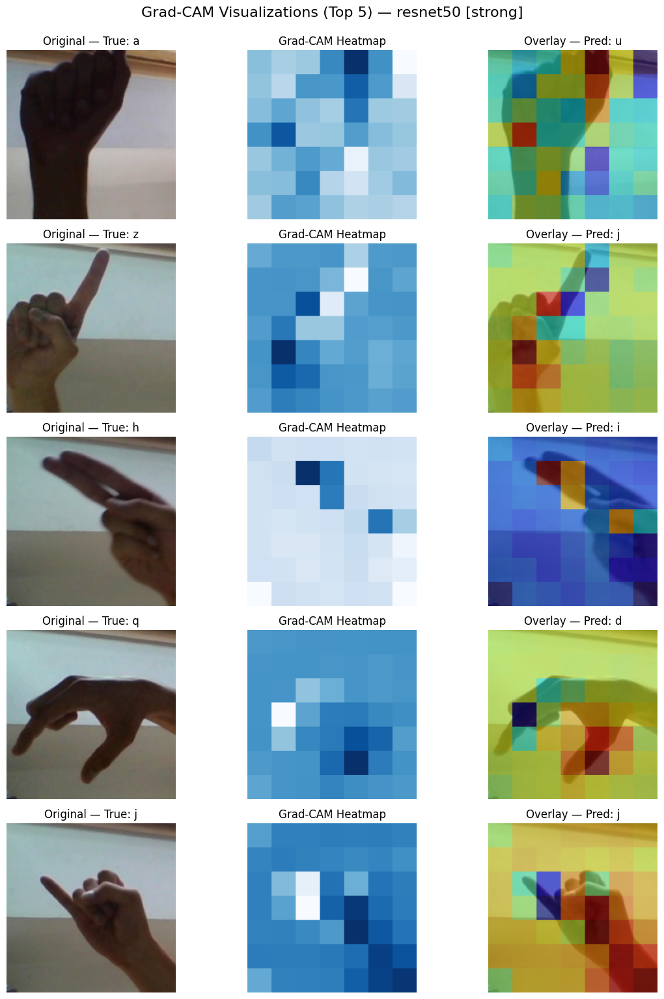

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from captum.attr import LayerGradCam, LayerAttribution
from pathlib import Path
import random

# --- CONFIG ---
AUG = "strong"         # or "baseline"
MODEL_NAME = "resnet50"  # You can change this to another model

MODEL_DIR = Path(f"/content/drive/MyDrive/zero_shot_models1_zs_{AUG}")
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dynamically get class names and number of classes
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
CLASS_NAMES = base(test_loader.dataset.datasets[0]).classes # Access classes from the first dataset
# NUM_CLASSES = len(CLASS_NAMES) # Removed local definition

# Model/backbone definition
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights, lambda m: m.layer4[-1]),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights, lambda m: m.features[-1]),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights, lambda m: m.features[-1]),
    'densenet121': (models.densenet121, models.DenseNet121_Weights, lambda m: m.features[-1]),
}

def make_model_fn(ctor, weights_enum):
    def builder():
        base = ctor(weights=weights_enum.DEFAULT)
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            in_f = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(in_f, 27) # Explicitly set output features to 27
        return nn.Sequential(base, head).to(DEVICE), base
    return builder

ctor, WEIGHT_ENUM, get_last_conv = BACKBONES[MODEL_NAME]
model, base = make_model_fn(ctor, WEIGHT_ENUM)()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

gradcam = LayerGradCam(model, get_last_conv(model[0]))

def run_gradcam(img_tensor, target_class):
    inp = img_tensor.unsqueeze(0).to(DEVICE)
    mask = gradcam.attribute(inp, target=target_class)
    cam = LayerAttribution.interpolate(mask, inp.shape[2:]).squeeze().cpu().detach().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
    return cam

def denormalize(tensor):
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = tensor.cpu().permute(1, 2, 0).numpy()
    tensor = std * tensor + mean
    return np.clip(tensor, 0, 1)

# ---- TEST & VISUALIZE TOP 5 SAMPLES ----
batch = next(iter(test_loader))
X_batch, y_batch = batch
X_batch = X_batch.to(DEVICE)

with torch.no_grad():
    logits = model(X_batch)
    probs = torch.softmax(logits, dim=1)
    preds = logits.argmax(dim=1)
    confidences = probs.max(dim=1).values

# Pick 1 random sample for 5 unique true classes
selected_indices = []
seen_classes = set()
shuffled_indices = list(range(len(y_batch)))
random.shuffle(shuffled_indices)

for idx in shuffled_indices:
    label = y_batch[idx].item()
    if label not in seen_classes:
        selected_indices.append(idx)
        seen_classes.add(label)
    if len(selected_indices) == 5:
        break

top5_idx = selected_indices

fig, axs = plt.subplots(5, 3, figsize=(12, 15))

for row, idx in enumerate(top5_idx):
    img_tensor = X_batch[idx]
    true_label = y_batch[idx].item()
    pred_label = preds[idx].item()

    cam = run_gradcam(img_tensor, pred_label)
    img_np = denormalize(img_tensor)

    # Original
    axs[row, 0].imshow(img_np)
    axs[row, 0].set_title(f"Original — True: {CLASS_NAMES[true_label]}")
    axs[row, 0].axis("off")

    # Grad-CAM Heatmap
    axs[row, 1].imshow(cam, cmap="Blues")
    axs[row, 1].set_title("Grad-CAM Heatmap")
    axs[row, 1].axis("off")

    # Overlay
    axs[row, 2].imshow(img_np)
    axs[row, 2].imshow(cam, cmap="jet", alpha=0.5)
    axs[row, 2].set_title(f"Overlay — Pred: {CLASS_NAMES[pred_label]}")
    axs[row, 2].axis("off")

plt.tight_layout()
plt.suptitle(f"Grad-CAM Visualizations (Top 5) — {MODEL_NAME} [{AUG}]", fontsize=16, y=1.02)
plt.show()

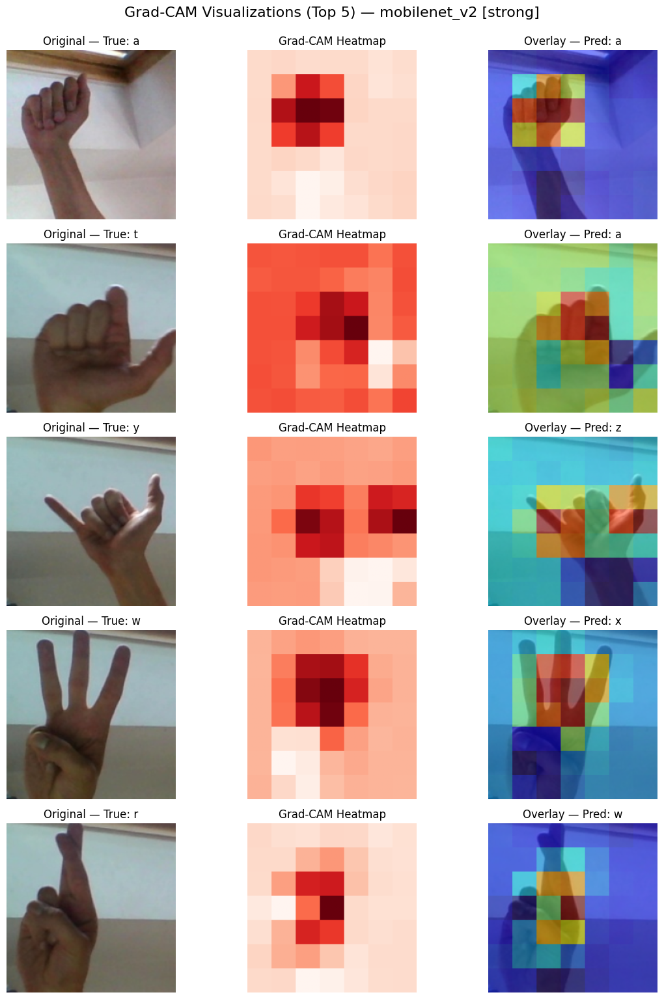

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from captum.attr import LayerGradCam, LayerAttribution
from pathlib import Path
import random

# --- CONFIG ---
AUG = "strong"         # or "baseline"
MODEL_NAME = "mobilenet_v2"  # You can change this to another model

MODEL_DIR = Path(f"/content/drive/MyDrive/zero_shot_models1_zs_{AUG}")
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dynamically get class names and number of classes
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
CLASS_NAMES = base(test_loader.dataset.datasets[0]).classes # Access classes from the first dataset
# NUM_CLASSES = len(CLASS_NAMES) # Removed local definition

# Model/backbone definition
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights, lambda m: m.layer4[-1]),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights, lambda m: m.features[-1]),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights, lambda m: m.features[-1]),
    'densenet121': (models.densenet121, models.DenseNet121_Weights, lambda m: m.features[-1]),
}

def make_model_fn(ctor, weights_enum):
    def builder():
        base = ctor(weights=weights_enum.DEFAULT)
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            in_f = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(in_f, 27) # Explicitly set output features to 27
        return nn.Sequential(base, head).to(DEVICE), base
    return builder

ctor, WEIGHT_ENUM, get_last_conv = BACKBONES[MODEL_NAME]
model, base = make_model_fn(ctor, WEIGHT_ENUM)()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

gradcam = LayerGradCam(model, get_last_conv(model[0]))

def run_gradcam(img_tensor, target_class):
    inp = img_tensor.unsqueeze(0).to(DEVICE)
    mask = gradcam.attribute(inp, target=target_class)
    cam = LayerAttribution.interpolate(mask, inp.shape[2:]).squeeze().cpu().detach().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
    return cam

def denormalize(tensor):
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = tensor.cpu().permute(1, 2, 0).numpy()
    tensor = std * tensor + mean
    return np.clip(tensor, 0, 1)

# ---- TEST & VISUALIZE TOP 5 SAMPLES ----
batch = next(iter(test_loader))
X_batch, y_batch = batch
X_batch = X_batch.to(DEVICE)

with torch.no_grad():
    logits = model(X_batch)
    probs = torch.softmax(logits, dim=1)
    preds = logits.argmax(dim=1)
    confidences = probs.max(dim=1).values

# Pick 1 random sample for 5 unique true classes
selected_indices = []
seen_classes = set()
shuffled_indices = list(range(len(y_batch)))
random.shuffle(shuffled_indices)

for idx in shuffled_indices:
    label = y_batch[idx].item()
    if label not in seen_classes:
        selected_indices.append(idx)
        seen_classes.add(label)
    if len(selected_indices) == 5:
        break

top5_idx = selected_indices

fig, axs = plt.subplots(5, 3, figsize=(12, 15))

for row, idx in enumerate(top5_idx):
    img_tensor = X_batch[idx]
    true_label = y_batch[idx].item()
    pred_label = preds[idx].item()

    cam = run_gradcam(img_tensor, pred_label)
    img_np = denormalize(img_tensor)

    # Original
    axs[row, 0].imshow(img_np)
    axs[row, 0].set_title(f"Original — True: {CLASS_NAMES[true_label]}")
    axs[row, 0].axis("off")

    # Grad-CAM Heatmap
    axs[row, 1].imshow(cam, cmap="Reds")
    axs[row, 1].set_title("Grad-CAM Heatmap")
    axs[row, 1].axis("off")

    # Overlay
    axs[row, 2].imshow(img_np)
    axs[row, 2].imshow(cam, cmap="jet", alpha=0.5)
    axs[row, 2].set_title(f"Overlay — Pred: {CLASS_NAMES[pred_label]}")
    axs[row, 2].axis("off")

plt.tight_layout()
plt.suptitle(f"Grad-CAM Visualizations (Top 5) — {MODEL_NAME} [{AUG}]", fontsize=16, y=1.02)
plt.show()

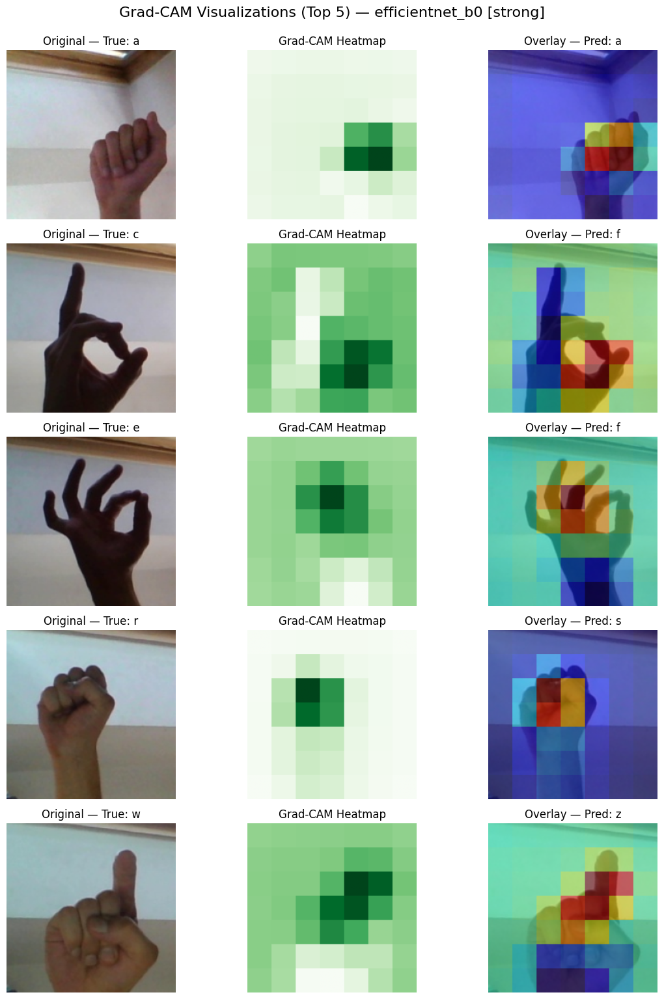

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from captum.attr import LayerGradCam, LayerAttribution
from pathlib import Path
import random

# --- CONFIG ---
AUG = "strong"         # or "baseline"
MODEL_NAME = "efficientnet_b0"  # You can change this to another model

MODEL_DIR = Path(f"/content/drive/MyDrive/zero_shot_models1_zs_{AUG}")
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dynamically get class names and number of classes
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# CLASS_NAMES = base(test_loader.dataset.datasets[0]).classes # Removed
CLASS_NAMES = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(CLASS_NAMES)

# Model/backbone definition
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights, lambda m: m.layer4[-1]),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights, lambda m: m.features[-1]),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights, lambda m: m.features[-1]),
    'densenet121': (models.densenet121, models.DenseNet121_Weights, lambda m: m.features[-1]),
}

def make_model_fn(ctor, weights_enum):
    def builder():
        base = ctor(weights=weights_enum.DEFAULT)
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            in_f = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(in_f, 27) # Explicitly set output features to 27
        return nn.Sequential(base, head).to(DEVICE), base
    return builder

ctor, WEIGHT_ENUM, get_last_conv = BACKBONES[MODEL_NAME]
model, base = make_model_fn(ctor, WEIGHT_ENUM)()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

gradcam = LayerGradCam(model, get_last_conv(model[0]))

def run_gradcam(img_tensor, target_class):
    inp = img_tensor.unsqueeze(0).to(DEVICE)
    mask = gradcam.attribute(inp, target=target_class)
    cam = LayerAttribution.interpolate(mask, inp.shape[2:]).squeeze().cpu().detach().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
    return cam

def denormalize(tensor):
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = tensor.cpu().permute(1, 2, 0).numpy()
    tensor = std * tensor + mean
    return np.clip(tensor, 0, 1)

# ---- TEST & VISUALIZE TOP 5 SAMPLES ----
batch = next(iter(test_loader))
X_batch, y_batch = batch
X_batch = X_batch.to(DEVICE)

with torch.no_grad():
    logits = model(X_batch)
    probs = torch.softmax(logits, dim=1)
    preds = logits.argmax(dim=1)
    confidences = probs.max(dim=1).values

# Pick 1 random sample for 5 unique true classes
selected_indices = []
seen_classes = set()
shuffled_indices = list(range(len(y_batch)))
random.shuffle(shuffled_indices)

for idx in shuffled_indices:
    label = y_batch[idx].item()
    if label not in seen_classes:
        selected_indices.append(idx)
        seen_classes.add(label)
    if len(selected_indices) == 5:
        break

top5_idx = selected_indices

fig, axs = plt.subplots(5, 3, figsize=(12, 15))

for row, idx in enumerate(top5_idx):
    img_tensor = X_batch[idx]
    true_label = y_batch[idx].item()
    pred_label = preds[idx].item()

    cam = run_gradcam(img_tensor, pred_label)
    img_np = denormalize(img_tensor)

    # Original
    axs[row, 0].imshow(img_np)
    axs[row, 0].set_title(f"Original — True: {CLASS_NAMES[true_label]}")
    axs[row, 0].axis("off")

    # Grad-CAM Heatmap
    axs[row, 1].imshow(cam, cmap="Greens")
    axs[row, 1].set_title("Grad-CAM Heatmap")
    axs[row, 1].axis("off")

    # Overlay
    axs[row, 2].imshow(img_np)
    axs[row, 2].imshow(cam, cmap="jet", alpha=0.5)
    axs[row, 2].set_title(f"Overlay — Pred: {CLASS_NAMES[pred_label]}")
    axs[row, 2].axis("off")

plt.tight_layout()
plt.suptitle(f"Grad-CAM Visualizations (Top 5) — {MODEL_NAME} [{AUG}]", fontsize=16, y=1.02)
plt.show()

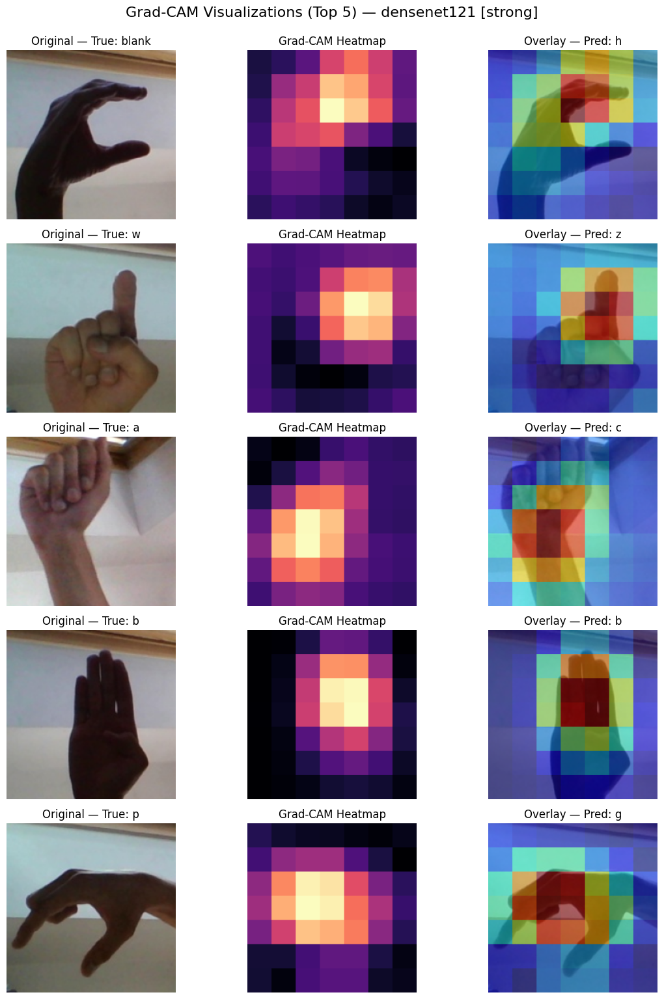

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from captum.attr import LayerGradCam, LayerAttribution
from pathlib import Path
import random

# --- CONFIG ---
AUG = "strong"         # or "baseline"
MODEL_NAME = "densenet121"  # You can change this to another model

MODEL_DIR = Path(f"/content/drive/MyDrive/zero_shot_models1_zs_{AUG}")
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dynamically get class names and number of classes
def base(ds):
    return ds.dataset if hasattr(ds, "dataset") else ds
# CLASS_NAMES = base(test_loader.dataset.datasets[0]).classes # Removed
CLASS_NAMES = ['a', 'b', 'blank', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'] # Explicitly define 27 classes
NUM_CLASSES = len(CLASS_NAMES)

# Model/backbone definition
BACKBONES = {
    'resnet50': (models.resnet50, models.ResNet50_Weights, lambda m: m.layer4[-1]),
    'mobilenet_v2': (models.mobilenet_v2, models.MobileNet_V2_Weights, lambda m: m.features[-1]),
    'efficientnet_b0': (models.efficientnet_b0, models.EfficientNet_B0_Weights, lambda m: m.features[-1]),
    'densenet121': (models.densenet121, models.DenseNet121_Weights, lambda m: m.features[-1]),
}

def make_model_fn(ctor, weights_enum):
    def builder():
        base = ctor(weights=weights_enum.DEFAULT)
        if hasattr(base, 'fc'):
            in_f = base.fc.in_features
            base.fc = nn.Identity()
        else:
            cls = base.classifier
            in_f = cls[-1].in_features if isinstance(cls, nn.Sequential) else cls.in_features
            base.classifier = nn.Identity()
        head = nn.Linear(in_f, 27) # Explicitly set output features to 27
        return nn.Sequential(base, head).to(DEVICE), base
    return builder

ctor, WEIGHT_ENUM, get_last_conv = BACKBONES[MODEL_NAME]
model, base = make_model_fn(ctor, WEIGHT_ENUM)()
best_pt = MODEL_DIR / f"{MODEL_NAME}_zs_{AUG}_best.pt"
model.load_state_dict(torch.load(best_pt, map_location=DEVICE), strict=True)
model.eval().to(DEVICE)

gradcam = LayerGradCam(model, get_last_conv(model[0]))

def run_gradcam(img_tensor, target_class):
    inp = img_tensor.unsqueeze(0).to(DEVICE)
    mask = gradcam.attribute(inp, target=target_class)
    cam = LayerAttribution.interpolate(mask, inp.shape[2:]).squeeze().cpu().detach().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
    return cam

def denormalize(tensor):
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = tensor.cpu().permute(1, 2, 0).numpy()
    tensor = std * tensor + mean
    return np.clip(tensor, 0, 1)

# ---- TEST & VISUALIZE TOP 5 SAMPLES ----
batch = next(iter(test_loader))
X_batch, y_batch = batch
X_batch = X_batch.to(DEVICE)

with torch.no_grad():
    logits = model(X_batch)
    probs = torch.softmax(logits, dim=1)
    preds = logits.argmax(dim=1)
    confidences = probs.max(dim=1).values

# Pick 1 random sample for 5 unique true classes
selected_indices = []
seen_classes = set()
shuffled_indices = list(range(len(y_batch)))
random.shuffle(shuffled_indices)

for idx in shuffled_indices:
    label = y_batch[idx].item()
    if label not in seen_classes:
        selected_indices.append(idx)
        seen_classes.add(label)
    if len(selected_indices) == 5:
        break

top5_idx = selected_indices

fig, axs = plt.subplots(5, 3, figsize=(12, 15))

for row, idx in enumerate(top5_idx):
    img_tensor = X_batch[idx]
    true_label = y_batch[idx].item()
    pred_label = preds[idx].item()

    cam = run_gradcam(img_tensor, pred_label)
    img_np = denormalize(img_tensor)

    # Original
    axs[row, 0].imshow(img_np)
    axs[row, 0].set_title(f"Original — True: {CLASS_NAMES[true_label]}")
    axs[row, 0].axis("off")

    # Grad-CAM Heatmap
    axs[row, 1].imshow(cam, cmap="magma")
    axs[row, 1].set_title("Grad-CAM Heatmap")
    axs[row, 1].axis("off")

    # Overlay
    axs[row, 2].imshow(img_np)
    axs[row, 2].imshow(cam, cmap="jet", alpha=0.5)
    axs[row, 2].set_title(f"Overlay — Pred: {CLASS_NAMES[pred_label]}")
    axs[row, 2].axis("off")

plt.tight_layout()
plt.suptitle(f"Grad-CAM Visualizations (Top 5) — {MODEL_NAME} [{AUG}]", fontsize=16, y=1.02)
plt.show()

Those **Grad-CAM heat-maps** are explainable-AI visuals that show **which spatial regions** ResNet-50 relied on when it made high-confidence predictions—correct or wrong.
They therefore address **RQ 3**:

> **RQ 3 Can explainable-AI (XAI) techniques enhance ASL-sign detection while improving the transparency and fairness of CNN-based models?**

How they satisfy RQ 3:

* **Transparency** – the overlays reveal that, for correct cases (*a, r, w*) the network focuses on finger shapes, while for a mis-classified “h” it attends to a background beam, explaining the error.
* **Actionable insight** – such findings justify tweaks like hand-cropping or stronger translation jitter, demonstrating how XAI can *enhance detection* by guiding model improvements.

(Secondarily, these visuals help interpret per-letter performance under **RQ 2**, but their primary purpose is XAI transparency, which belongs to RQ 3.)
